##載入套件

In [1]:
import pandas as pd
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import math
from scipy.io import loadmat
import h5py

Kaggle API


In [2]:
## 載入Kaggle 套件跟API

!pip install -q kaggle

from google.colab import files
import json
import os

print("上傳 kaggle.json")
uploaded = files.upload()

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

# 確認有沒有設定成功
!kaggle config view

上傳 kaggle.json


Saving kaggle.json to kaggle.json
Configuration values from /root/.kaggle
- username: emilyhsu4608
- path: None
- proxy: None
- competition: None


## 下載資料集

In [3]:
!mkdir -p data/usps
!kaggle datasets download -d bistaumanga/usps-dataset -p data/usps --unzip

# 檢查下載的檔案
print("\n=== USPS資料集內容 ===")
!ls -la data/usps/

Dataset URL: https://www.kaggle.com/datasets/bistaumanga/usps-dataset
License(s): copyright-authors
  0% 0.00/2.75M [00:00<?, ?B/s]
100% 2.75M/2.75M [00:00<00:00, 260MB/s]

=== USPS資料集內容 ===
total 2856
drwxr-xr-x 2 root root    4096 Nov 16 04:41 .
drwxr-xr-x 3 root root    4096 Nov 16 04:41 ..
-rw-r--r-- 1 root root 2913522 Nov 16 04:41 usps.h5


## 處理USPS資料集


1.先檢查原始的資料結構


In [4]:
# 首先檢查資料結構
with h5py.File('/content/data/usps/usps.h5', 'r') as hf:
    # 查看檔案結構
    print("H5檔案的主要類別:")
    print(list(hf.keys()))

    # 檢查訓練資料
    train = hf.get('train')
    print("\n訓練資料集包含:")
    print(list(train.keys()))

    x_train = train.get('data')[:]
    y_train = train.get('target')[:]

    # 檢查測試資料
    test = hf.get('test')
    print("\n測試資料集包含:")
    print(list(test.keys()))

    x_test = test.get('data')[:]
    y_test = test.get('target')[:]

H5檔案的主要類別:
['test', 'train']

訓練資料集包含:
['data', 'target']

測試資料集包含:
['data', 'target']


In [5]:
# 顯示詳細的資料形狀資訊
print("\n" + "="*50)
print("USPS Dataset：")
print("="*50)
print(f"訓練資料形狀: {x_train.shape}")
print(f"訓練標籤形狀: {y_train.shape}")
print(f"訓練標籤維度數: {y_train.ndim}")
print(f"訓練標籤前10個值: {y_train[:10]}")
print(f"\n測試資料形狀: {x_test.shape}")
print(f"測試標籤形狀: {y_test.shape}")
print(f"測試標籤維度數: {y_test.ndim}")
print(f"測試標籤前10個值: {y_test[:10]}")

# 檢查標籤的唯一值
print(f"\n標籤的唯一值: {np.unique(y_train)}")
print(f"影像維度: 16x16 像素 (256個特徵)")


USPS Dataset：
訓練資料形狀: (7291, 256)
訓練標籤形狀: (7291,)
訓練標籤維度數: 1
訓練標籤前10個值: [6 5 4 7 3 6 3 1 0 1]

測試資料形狀: (2007, 256)
測試標籤形狀: (2007,)
測試標籤維度數: 1
測試標籤前10個值: [9 6 3 6 6 0 0 0 6 9]

標籤的唯一值: [0 1 2 3 4 5 6 7 8 9]
影像維度: 16x16 像素 (256個特徵)


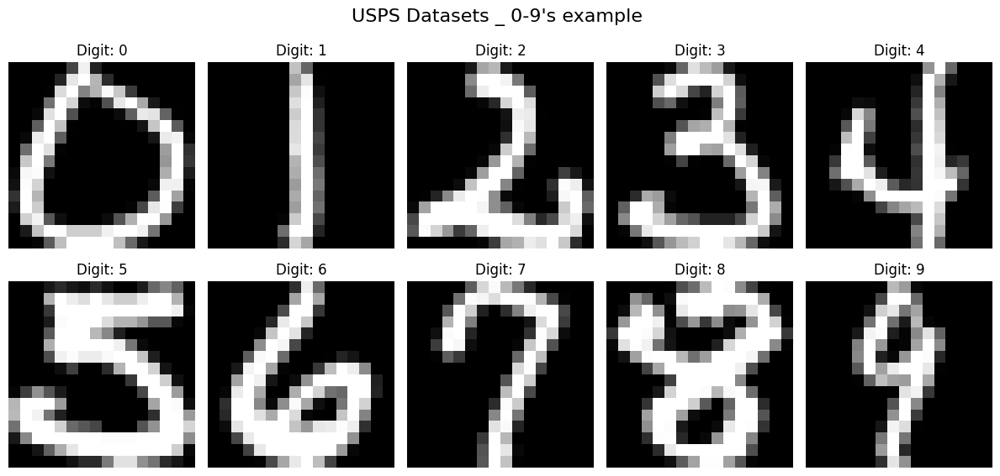

In [6]:
# 顯示datasets每個數字類別的範例
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
fig.suptitle("USPS Datasets _ 0-9's example ", fontsize=16)

for digit in range(10):
    # 找到第一個屬於該數字的影像
    indices = np.where(y_train == digit)[0]
    if len(indices) > 0:
        idx = indices[0]

        # 決定子圖位置
        row = digit // 5
        col = digit % 5

        # 顯示影像
        img = x_train[idx].reshape(16, 16)
        axes[row, col].imshow(img, cmap='gray')
        axes[row, col].set_title(f'Digit: {digit}')
        axes[row, col].axis('off')

plt.tight_layout()
plt.show()

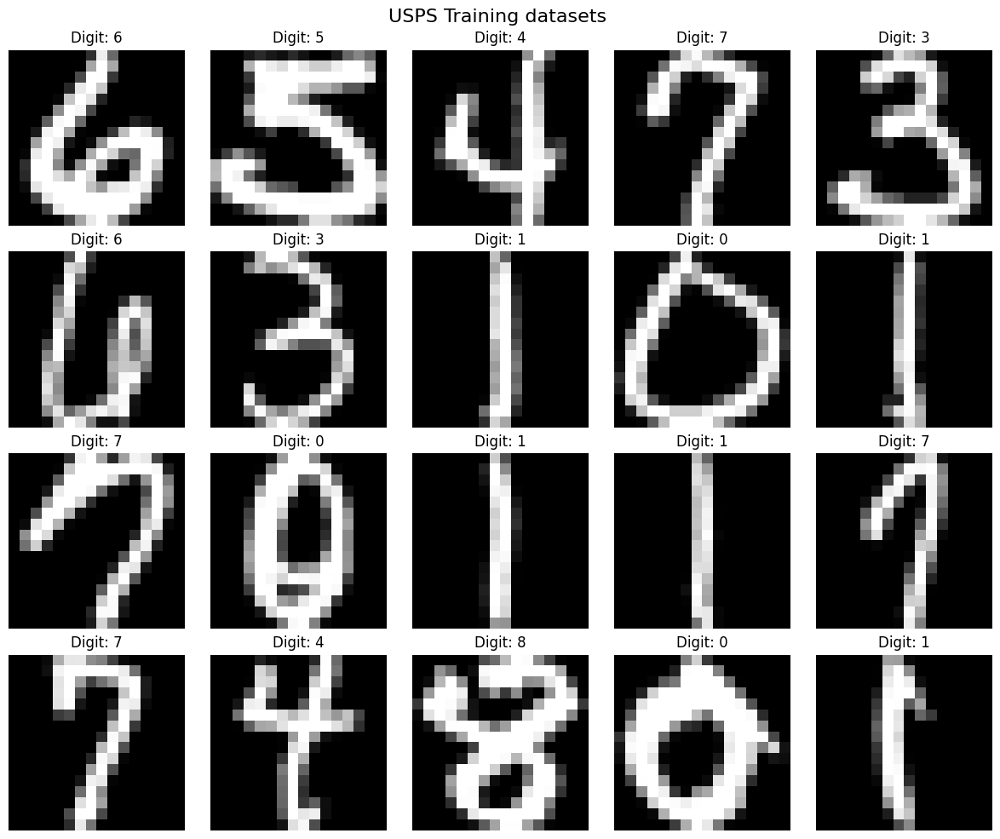

In [7]:
# 顯示訓練集的前20個影像
fig, axes = plt.subplots(4, 5, figsize=(12, 10))
fig.suptitle('USPS Training datasets ', fontsize=16)

for i, ax in enumerate(axes.flat):
    if i < len(x_train):
        # 將影像重新形狀為 16x16
        img = x_train[i].reshape(16, 16)

        # 顯示影像
        ax.imshow(img, cmap='gray')

        # 獲取標籤（假設 y_train 是直接的標籤值）
        label = int(y_train[i])
        ax.set_title(f'Digit: {label}')
        ax.axis('off')

plt.tight_layout()
plt.show()

2.為了後續方便 將資料集轉換成白底黑字

In [8]:
## 轉換成白底黑字

import h5py
import numpy as np
from PIL import Image
import os

# 讀取資料
with h5py.File('/content/data/usps/usps.h5', 'r') as hf:
    train = hf.get('train')
    x_train = train.get('data')[:]
    y_train = train.get('target')[:]
    test = hf.get('test')
    x_test = test.get('data')[:]
    y_test = test.get('target')[:]

# 建立資料夾結構
for digit in range(10):
    os.makedirs(f'usps_inverted/train/{digit}', exist_ok=True)
    os.makedirs(f'usps_inverted/test/{digit}', exist_ok=True)

print("開始轉換訓練資料為白底黑字...")
# 儲存反轉的training sets影像
for i in range(min(7291, len(x_train))):
    img_array = x_train[i].reshape(16, 16)
    img_inverted = 1.0 - img_array  # 反轉顏色（1 - 原始值）
    img_inverted_255 = (img_inverted * 255).astype(np.uint8) # 轉換到 0-255 範圍
    img = Image.fromarray(img_inverted_255, mode='L')
    img_large = img.resize((160, 160), Image.NEAREST)
    label = int(y_train[i])
    img_large.save(f'usps_inverted/train/{label}/train_{i:05d}.png')

    if i % 200 == 0:
        print(f"  已處理 {i}/7291 張訓練影像")

# 儲存反轉的testing sets影像
for i in range(min(2007, len(x_test))):
    img_array = x_test[i].reshape(16, 16)
    img_inverted = 1.0 - img_array
    img_inverted_255 = (img_inverted * 255).astype(np.uint8)
    img = Image.fromarray(img_inverted_255, mode='L')
    img_large = img.resize((160, 160), Image.NEAREST)
    label = int(y_test[i])
    img_large.save(f'usps_inverted/test/{label}/test_{i:05d}.png')

    if i % 100 == 0:
        print(f"  已處理 {i}/2007 張測試影像")

print("\n轉換完成！白底黑字的影像已儲存到 usps_inverted/ 資料夾")

開始轉換訓練資料為白底黑字...
  已處理 0/7291 張訓練影像


/tmp/ipython-input-829147142.py:28: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  img = Image.fromarray(img_inverted_255, mode='L')


  已處理 200/7291 張訓練影像
  已處理 400/7291 張訓練影像
  已處理 600/7291 張訓練影像
  已處理 800/7291 張訓練影像
  已處理 1000/7291 張訓練影像
  已處理 1200/7291 張訓練影像
  已處理 1400/7291 張訓練影像
  已處理 1600/7291 張訓練影像
  已處理 1800/7291 張訓練影像
  已處理 2000/7291 張訓練影像
  已處理 2200/7291 張訓練影像
  已處理 2400/7291 張訓練影像
  已處理 2600/7291 張訓練影像
  已處理 2800/7291 張訓練影像
  已處理 3000/7291 張訓練影像
  已處理 3200/7291 張訓練影像
  已處理 3400/7291 張訓練影像
  已處理 3600/7291 張訓練影像
  已處理 3800/7291 張訓練影像
  已處理 4000/7291 張訓練影像
  已處理 4200/7291 張訓練影像
  已處理 4400/7291 張訓練影像
  已處理 4600/7291 張訓練影像
  已處理 4800/7291 張訓練影像
  已處理 5000/7291 張訓練影像
  已處理 5200/7291 張訓練影像
  已處理 5400/7291 張訓練影像
  已處理 5600/7291 張訓練影像
  已處理 5800/7291 張訓練影像
  已處理 6000/7291 張訓練影像
  已處理 6200/7291 張訓練影像
  已處理 6400/7291 張訓練影像
  已處理 6600/7291 張訓練影像
  已處理 6800/7291 張訓練影像
  已處理 7000/7291 張訓練影像
  已處理 7200/7291 張訓練影像
  已處理 0/2007 張測試影像


/tmp/ipython-input-829147142.py:41: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  img = Image.fromarray(img_inverted_255, mode='L')


  已處理 100/2007 張測試影像
  已處理 200/2007 張測試影像
  已處理 300/2007 張測試影像
  已處理 400/2007 張測試影像
  已處理 500/2007 張測試影像
  已處理 600/2007 張測試影像
  已處理 700/2007 張測試影像
  已處理 800/2007 張測試影像
  已處理 900/2007 張測試影像
  已處理 1000/2007 張測試影像
  已處理 1100/2007 張測試影像
  已處理 1200/2007 張測試影像
  已處理 1300/2007 張測試影像
  已處理 1400/2007 張測試影像
  已處理 1500/2007 張測試影像
  已處理 1600/2007 張測試影像
  已處理 1700/2007 張測試影像
  已處理 1800/2007 張測試影像
  已處理 1900/2007 張測試影像
  已處理 2000/2007 張測試影像

轉換完成！白底黑字的影像已儲存到 usps_inverted/ 資料夾


In [9]:
## 確認轉換後的資料量
import os
def count_files(path):
    total = 0
    for root, dirs, files in os.walk(path):
        total += len(files)
    return total

test_count = count_files('usps_inverted/test')
train_count = count_files('usps_inverted/train')

print(f'test: {test_count}')
print(f'train: {train_count}')
print(f'總計: {test_count + train_count}')

test: 2007
train: 7291
總計: 9298


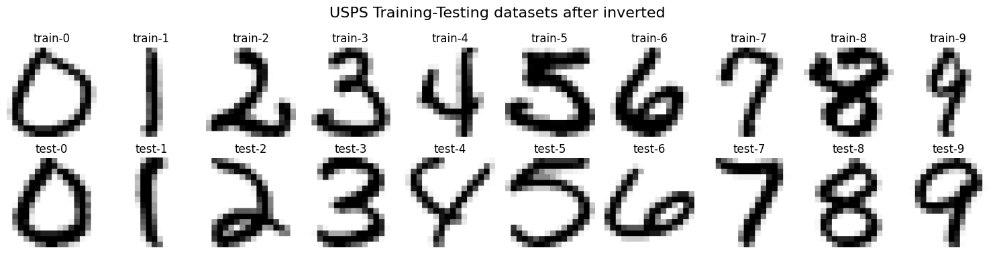

In [10]:
import os
from PIL import Image
import matplotlib.pyplot as plt

base_dir = "usps_inverted"   # 根目錄名稱
splits = ["train", "test"]   # 要顯示的資料集
classes = [str(i) for i in range(10)]  # 0~9

fig, axes = plt.subplots(len(splits), len(classes), figsize=(15, 4))
fig.suptitle('USPS Training-Testing datasets after inverted ', fontsize=16)

for i, split in enumerate(splits):
    for j, cls in enumerate(classes):
        folder = os.path.join(base_dir, split, cls)
        files = sorted(os.listdir(folder))  # 該類別資料夾中的檔案列表
        if not files:
            continue  # 若空資料夾就跳過
        img_path = os.path.join(folder, files[0])  # 取第一張

        img = Image.open(img_path)
        axes[i, j].imshow(img, cmap="gray")  # 若是灰階圖，用 cmap="gray"
        axes[i, j].set_title(f"{split}-{cls}")
        axes[i, j].axis("off")

plt.tight_layout()
plt.show()


In [11]:
# 設定資料路徑
TRAIN_PATH = 'usps_inverted/train'
TEST_PATH = 'usps_inverted/test'

## 建立自己的測試資料集

In [12]:
## 建立自己寫的數字的資料集 然後手動上傳圖片
!mkdir -p handwrite/mine
!mkdir -p handwrite/dr

## 方法一 :Mean

In [13]:
# 1. 載入資料的函數
def load_usps_data(base_path, img_size=(16, 16)):

    images = []
    labels = []

    print(f"正在載入資料從: {base_path}")

    # 讀取每個數字資料夾 (0-9)
    for digit in range(10):
        digit_path = os.path.join(base_path, str(digit))

        if os.path.exists(digit_path):
            img_files = os.listdir(digit_path)
            print(f"  數字 {digit}: 找到 {len(img_files)} 張圖片")

            for filename in img_files:
                if filename.endswith(('.png', '.jpg', '.jpeg')):
                    img_path = os.path.join(digit_path, filename)
                    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

                    if img is not None:
                        # 確保圖片大小一致
                        if img.shape != img_size:
                            img = cv2.resize(img, img_size)

                        # 正規化到 [0, 1]
                        img = img.astype(np.float32) / 255

                        # 展平成一維向量
                        images.append(img.flatten())
                        labels.append(digit)

    return np.array(images), np.array(labels)

In [14]:
# 2. 載入訓練和測試資料
print("=" * 50)
print("載入資料集...")
print("=" * 50)

x_train, y_train = load_usps_data(TRAIN_PATH)
x_test, y_test = load_usps_data(TEST_PATH)

print(f"\n訓練集: {x_train.shape[0]} 張圖片")
print(f"測試集: {x_test.shape[0]} 張圖片")
print(f"圖片維度: {x_train.shape[1]} (16x16 展平)")

載入資料集...
正在載入資料從: usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
正在載入資料從: usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片

訓練集: 7291 張圖片
測試集: 2007 張圖片
圖片維度: 256 (16x16 展平)


In [15]:
# 3. 計算每個數字的平均模板
def calculate_mean_templates(x_train, y_train):
    """
    計算每個數字的平均模板
    """
    print("\n" + "=" * 50)
    print("計算平均模板...")
    print("=" * 50)

    mean_templates = {}

    for digit in range(10):
        # 找出屬於該數字的所有訓練樣本
        digit_samples = x_train[y_train == digit]

        if len(digit_samples) > 0:
            # 計算平均值
            mean_template = np.mean(digit_samples, axis=0)
            mean_templates[digit] = mean_template
            print(f"數字 {digit}: 使用 {len(digit_samples)} 個樣本計算平均模板")

    return mean_templates

mean_templates = calculate_mean_templates(x_train, y_train)


計算平均模板...
數字 0: 使用 1194 個樣本計算平均模板
數字 1: 使用 1005 個樣本計算平均模板
數字 2: 使用 731 個樣本計算平均模板
數字 3: 使用 658 個樣本計算平均模板
數字 4: 使用 652 個樣本計算平均模板
數字 5: 使用 556 個樣本計算平均模板
數字 6: 使用 664 個樣本計算平均模板
數字 7: 使用 645 個樣本計算平均模板
數字 8: 使用 542 個樣本計算平均模板
數字 9: 使用 644 個樣本計算平均模板


In [16]:
for digit in range(10):
    template = mean_templates[digit]          # 這是一個長度 256 的 1D 向量
    template_2d = template.reshape(16, 16)    # 轉成 16x16

    print(f"\n=== 數字 {digit} 的平均模板值 (16x16) ===")
    print(template_2d)


=== 數字 0 的平均模板值 (16x16) ===
[[0.9993136  0.9976911  0.9924031  0.97044337 0.91617197 0.7846445
  0.5643546  0.42222574 0.47546595 0.6755643  0.8697788  0.9601339
  0.99241304 0.9985647  0.9999638  1.        ]
 [0.9991132  0.9966892  0.9748116  0.90526474 0.7438392  0.46790853
  0.23588854 0.15799572 0.18374863 0.29915914 0.52325034 0.788737
  0.93580943 0.98444504 0.9983775  0.9999967 ]
 [0.99832493 0.98634017 0.9313393  0.78065145 0.52736205 0.28011626
  0.1851971  0.19093157 0.22404169 0.23921886 0.3089729  0.52954626
  0.7819718  0.93818766 0.98915803 0.99905086]
 [0.9968403  0.9654644  0.84399694 0.6082569  0.35070843 0.23033135
  0.27520934 0.39319807 0.4535062  0.39199945 0.3022366  0.36619386
  0.5849934  0.8236703  0.96011746 0.99697495]
 [0.9888723  0.91034204 0.7087494  0.45171592 0.26692623 0.2746477
  0.42920163 0.59360856 0.69422275 0.61848444 0.44231611 0.34228027
  0.4359153  0.66735333 0.8800566  0.98486215]
 [0.9731299  0.8141351  0.57348824 0.34417555 0.26404905 0.38

In [17]:
for digit in range(10):
    t = mean_templates[digit]
    print(f"數字 {digit}: 形狀 {t.shape}, min={t.min():.4f}, max={t.max():.4f}, mean={t.mean():.4f}")

數字 0: 形狀 (256,), min=0.0889, max=1.0000, mean=0.6488
數字 1: 形狀 (256,), min=0.0474, max=1.0000, mean=0.8514
數字 2: 形狀 (256,), min=0.3344, max=1.0000, mean=0.7207
數字 3: 形狀 (256,), min=0.1370, max=1.0000, mean=0.7158
數字 4: 形狀 (256,), min=0.2453, max=1.0000, mean=0.7844
數字 5: 形狀 (256,), min=0.1304, max=0.9997, mean=0.7112
數字 6: 形狀 (256,), min=0.1362, max=1.0000, mean=0.7467
數字 7: 形狀 (256,), min=0.1369, max=1.0000, mean=0.7914
數字 8: 形狀 (256,), min=0.1449, max=1.0000, mean=0.7214
數字 9: 形狀 (256,), min=0.1515, max=1.0000, mean=0.7748


In [18]:
# 定義 2-norm 計算函數(也可以寫成老師的版本z、mi帶入a、ak)一樣意思
def norm2(z, mi):

    return np.linalg.norm(z - mi, 2)

In [19]:
# 4. 建立基於 2-norm 的分類器
class Norm2Classifier:
    def __init__(self, mean_templates):
        self.mean_templates = mean_templates

    def classify(self, sample): ##使用 2-norm 進行分類 選擇距離最小的模板作為預測結果

        min_distance = float('inf')
        predicted_digit = -1
        all_distances = {}

        for digit, template in self.mean_templates.items():
            distance = norm2(sample, template)
            all_distances[digit] = distance

            if distance < min_distance:
                min_distance = distance
                predicted_digit = digit

        return predicted_digit, min_distance, all_distances

    def predict_batch(self, X_test):

        predictions = []
        min_distances = []
        all_distances_list = []

        for sample in X_test:
            pred, min_dist, all_dist = self.classify(sample)
            predictions.append(pred)
            min_distances.append(min_dist)
            all_distances_list.append(all_dist)

        return np.array(predictions), np.array(min_distances), all_distances_list


In [20]:
# 5. 進行分類預測
print("\n" + "=" * 50)
print("使用 2-norm 進行分類預測...")
print("=" * 50)

classifier = Norm2Classifier(mean_templates)
predictions, distances, all_distances_list = classifier.predict_batch(x_test)



使用 2-norm 進行分類預測...


In [21]:
# 6. 評估結果
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
accuracy = accuracy_score(y_test,predictions)
conf_matrix = confusion_matrix(y_test,predictions)

print(f"\n===== 2-norm 方法評估結果 =====")
print(f"整體準確率: {accuracy:.4f} ({accuracy*100:.2f}%)")
print(f"正確分類: {np.sum(predictions == y_test)} / {len(y_test)}")
print(f"錯誤分類: {np.sum(predictions != y_test)} / {len(y_test)}")

print("\n==========分類報告:==========")
print(classification_report(y_test,predictions))


===== 2-norm 方法評估結果 =====
整體準確率: 0.8142 (81.42%)
正確分類: 1634 / 2007
錯誤分類: 373 / 2007

==========分類報告:==========
              precision    recall  f1-score   support

           0       0.88      0.83      0.85       359
           1       0.95      0.98      0.96       264
           2       0.88      0.73      0.80       198
           3       0.81      0.79      0.80       166
           4       0.70      0.75      0.72       200
           5       0.79      0.77      0.78       160
           6       0.75      0.84      0.79       170
           7       0.87      0.80      0.83       147
           8       0.73      0.77      0.75       166
           9       0.71      0.80      0.75       177

    accuracy                           0.81      2007
   macro avg       0.81      0.81      0.80      2007
weighted avg       0.82      0.81      0.81      2007




繪製視覺化結果...


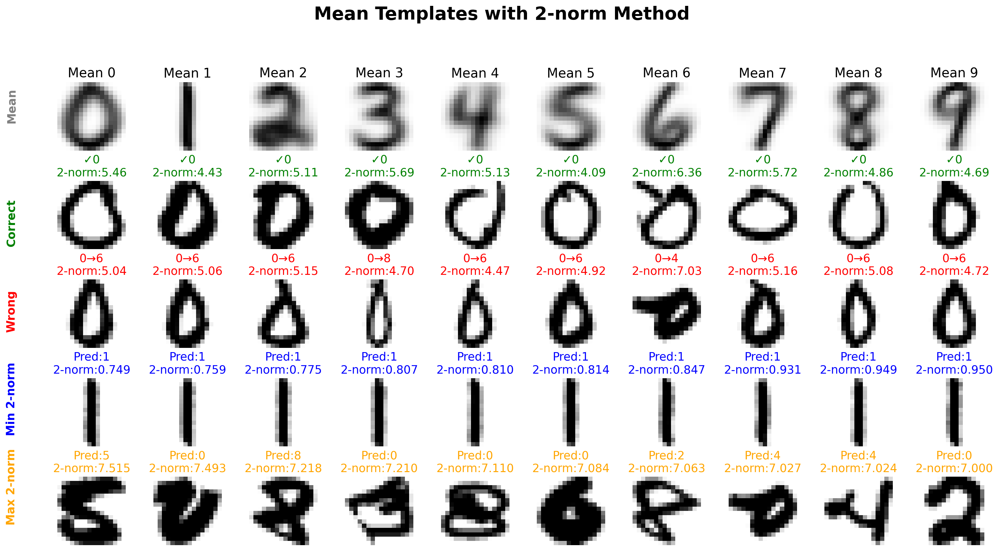

In [22]:
def visualize_norm2_results():
    plt.rcParams['font.size'] = 14

    fig = plt.figure(figsize=(18, 10), dpi=180)

    print("\n繪製視覺化結果...")

    # 1. 顯示mean再重組後的數字的模板
    for i in range(10):
        plt.subplot(5, 10, i+1)
        template = mean_templates[i].reshape(16, 16)
        plt.imshow(template, cmap='gray')
        plt.title(f'Mean {i}', fontsize=16)
        plt.axis('off')

    fig.suptitle('Mean Templates with 2-norm Method',
                 fontsize=22, weight='bold', y=0.97)

    # 2. 正確分類
    correct_idx = np.where(predictions == y_test)[0][:10]
    for idx, i in enumerate(correct_idx):
        plt.subplot(5, 10, 11+idx)
        img = x_test[i].reshape(16, 16)
        plt.imshow(img, cmap='gray')
        plt.title(f'✓{y_test[i]}\n2-norm:{distances[i]:.2f}',
                  color='green', fontsize=14)
        plt.axis('off')

    # 3. 錯誤分類
    wrong_idx = np.where(predictions != y_test)[0][:10]
    for idx, i in enumerate(wrong_idx):
        if idx < len(wrong_idx):
            plt.subplot(5, 10, 21+idx)
            img = x_test[i].reshape(16, 16)
            plt.imshow(img, cmap='gray')
            true_norm = norm2(x_test[i], mean_templates[y_test[i]])
            plt.title(f'{y_test[i]}→{predictions[i]}\n2-norm:{distances[i]:.2f}',
                      color='red', fontsize=14)
            plt.axis('off')

    # 4. 最小 2-norm
    sorted_idx = np.argsort(distances)[:10]
    for idx, i in enumerate(sorted_idx):
        plt.subplot(5, 10, 31+idx)
        img = x_test[i].reshape(16, 16)
        plt.imshow(img, cmap='gray')
        plt.title(f'Pred:{predictions[i]}\n2-norm:{distances[i]:.3f}',
                  color='blue', fontsize=14)
        plt.axis('off')

    # 5. 最大 2-norm
    sorted_idx_max = np.argsort(distances)[-10:][::-1]
    for idx, i in enumerate(sorted_idx_max):
        plt.subplot(5, 10, 41+idx)
        img = x_test[i].reshape(16, 16)
        plt.imshow(img, cmap='gray')
        plt.title(f'Pred:{predictions[i]}\n2-norm:{distances[i]:.3f}',
                  color='orange', fontsize=14)
        plt.axis('off')

    # 左側行標籤
    fig.text(0.03, 0.80, 'Mean', rotation=90, va='center',
             fontsize=14, color='gray', weight='bold')
    fig.text(0.03, 0.60, 'Correct', rotation=90, va='center',
             fontsize=14, color='green', weight='bold')
    fig.text(0.03, 0.45, 'Wrong', rotation=90, va='center',
             fontsize=14, color='red', weight='bold')
    fig.text(0.03, 0.30, 'Min 2-norm', rotation=90, va='center',
             fontsize=14, color='blue', weight='bold')
    fig.text(0.03, 0.15, 'Max 2-norm', rotation=90, va='center',
             fontsize=14, color='orange', weight='bold')

    plt.tight_layout(rect=[0.06, 0.03, 0.98, 0.93])
    plt.savefig('norm2_results.png', dpi=180, bbox_inches='tight')
    plt.show()
visualize_norm2_results()

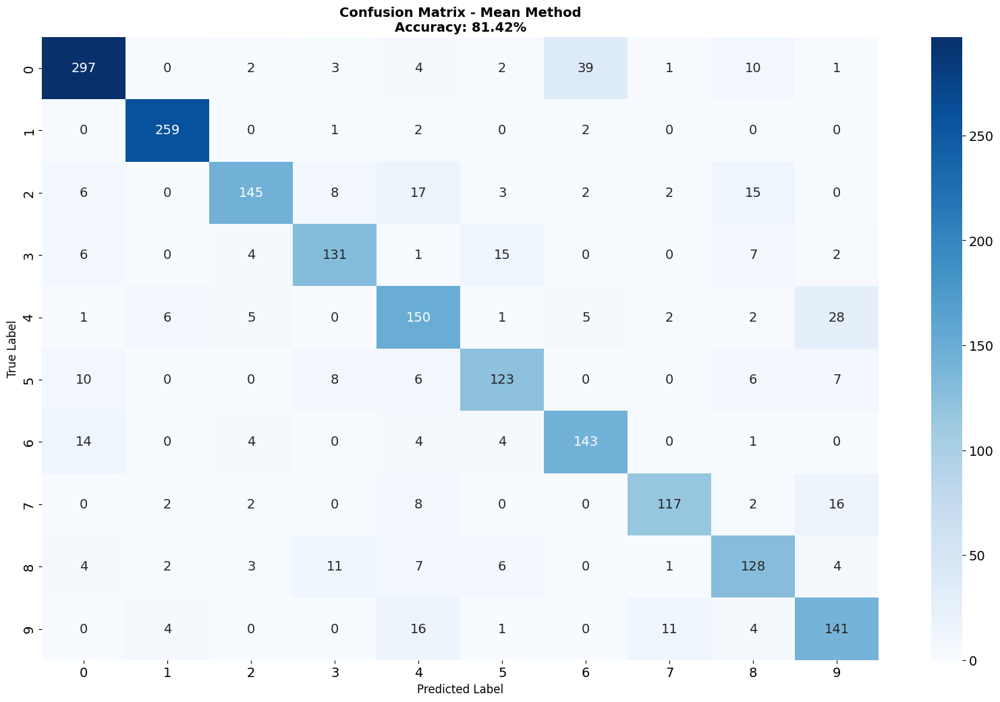

In [23]:
# 8. 繪製mean平均法的混淆矩陣
def visualize_confusionMatrix_results():

    plt.figure(figsize=(20, 12))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
                xticklabels=range(10), yticklabels=range(10))
    plt.title(f'Confusion Matrix - Mean Method\nAccuracy: {accuracy:.2%}',
              fontsize=14, weight='bold')
    plt.xlabel('Predicted Label', fontsize=12)
    plt.ylabel('True Label', fontsize=12)
    plt.savefig('Confusion_matrix_MeanbyNorm2.png', dpi=150, bbox_inches='tight')
    plt.show()

visualize_confusionMatrix_results()


分析數字 0 的混淆情況 (共 359 個樣本)

Avg distances for digit 0 = [5.15446   8.859345  6.8922777 6.877115  7.448549  6.4055414 6.572363
 7.868263  7.125559  7.6427007]


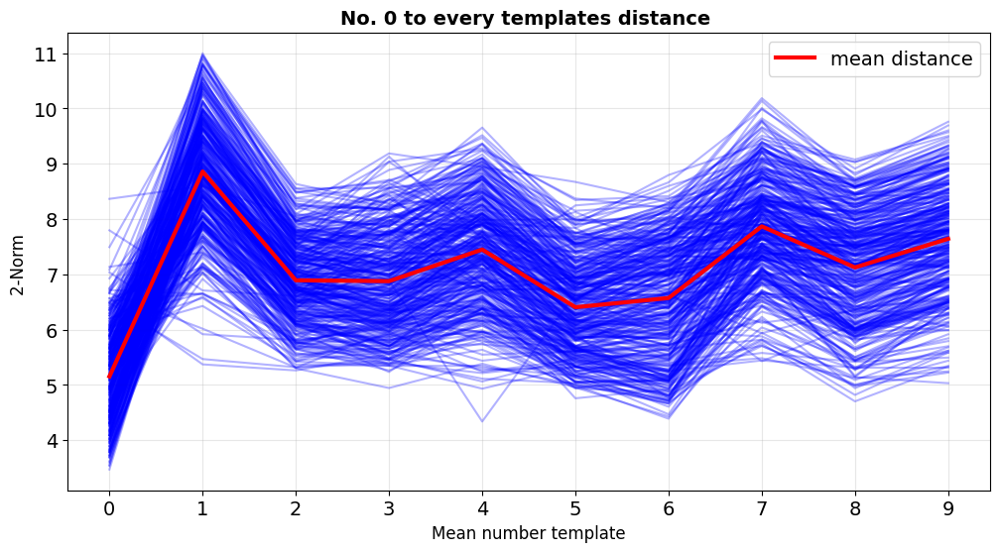

數字 0 最容易被誤判為: 5
到正確模板的平均距離: 5.1545
到混淆模板的平均距離: 6.4055

分析數字 1 的混淆情況 (共 264 個樣本)

Avg distances for digit 1 = [7.448382  2.1380308 5.5314946 6.1652675 5.370018  5.8644094 5.6791716
 5.7382526 5.395788  5.3214555]


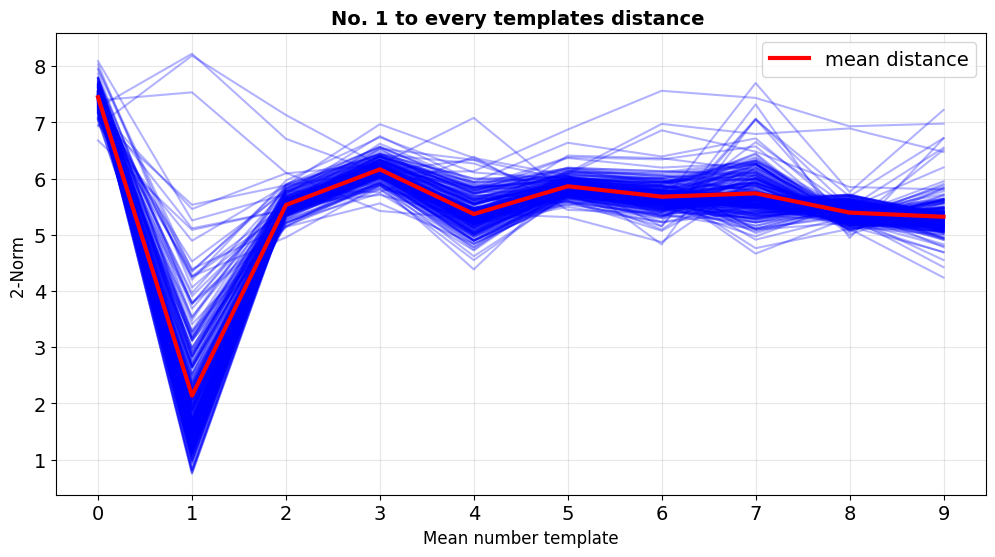

數字 1 最容易被誤判為: 9
到正確模板的平均距離: 2.1380
到混淆模板的平均距離: 5.3215

分析數字 4 的混淆情況 (共 200 個樣本)

Avg distances for digit 4 = [7.2196655 6.881259  6.18026   6.6335454 4.8724084 6.3410244 6.5179596
 6.044904  5.9671783 5.5196333]


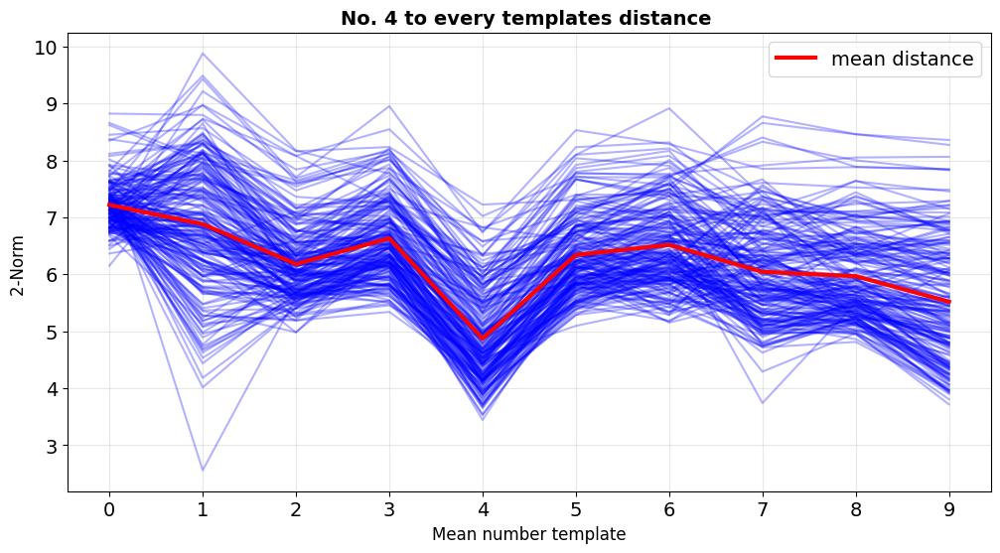

數字 4 最容易被誤判為: 9
到正確模板的平均距離: 4.8724
到混淆模板的平均距離: 5.5196

分析數字 6 的混淆情況 (共 170 個樣本)

Avg distances for digit 6 = [6.1565776 6.8800945 5.8681197 6.4779234 6.2847195 5.6203256 4.5498576
 7.0610433 6.1492763 6.7803755]


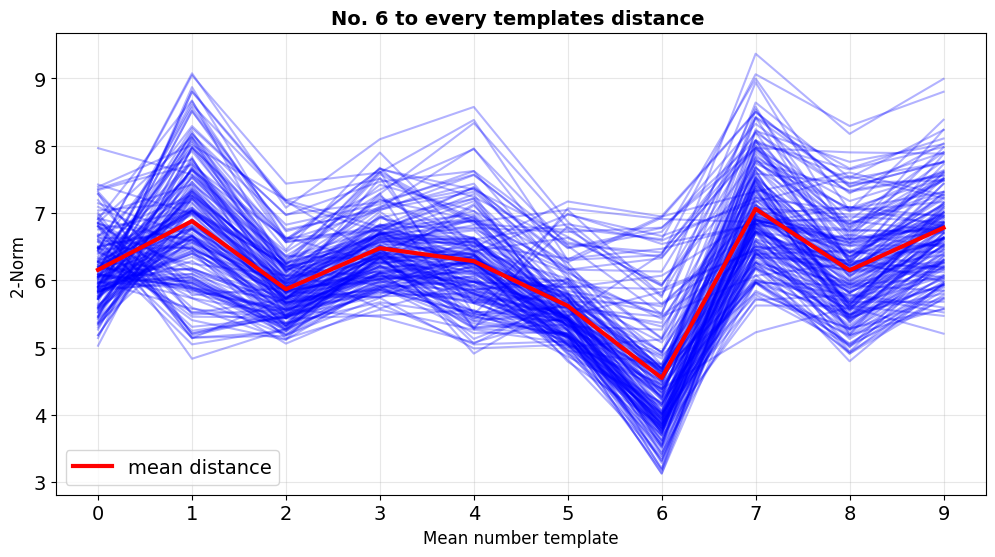

數字 6 最容易被誤判為: 5
到正確模板的平均距離: 4.5499
到混淆模板的平均距離: 5.6203


In [24]:
def analyze_digit_confusion(digit, x_test, y_test, mean_templates):

    # 找出所有該數字的測試樣本
    digit_indices = np.where(y_test == digit)[0]

    print(f"\n分析數字 {digit} 的混淆情況 (共 {len(digit_indices)} 個樣本)")

    # 計算每個樣本到所有模板的距離
    all_distances = []
    for idx in digit_indices:
        distances_to_templates = []
        sample = x_test[idx]

        for template_digit in range(10):
            dist = norm2(sample, mean_templates[template_digit])
            distances_to_templates.append(dist)

        all_distances.append(distances_to_templates)

    # 繪製距離分佈圖
    plt.figure(figsize=(12, 6))
    for distances in all_distances:
        plt.plot(range(10), distances, alpha=0.3, color='blue')

    # 繪製平均距離
    avg_distances = np.mean(all_distances, axis=0)
    plt.plot(range(10), avg_distances, 'r-', linewidth=3, label='mean distance')
    print(f"\nAvg distances for digit {digit} =", avg_distances)


    plt.xlabel('Mean number template', fontsize=12)
    plt.ylabel('2-Norm ', fontsize=12)
    plt.title(f'No. {digit} to every templates distance ', fontsize=14, fontweight='bold')
    plt.xticks(range(10))
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

    # 找出最容易混淆的數字
    avg_distances[digit] = np.inf  # 排除自己
    confused_with = np.argmin(avg_distances)
    print(f"數字 {digit} 最容易被誤判為: {confused_with}")
    print(f"到正確模板的平均距離: {np.mean([d[digit] for d in all_distances]):.4f}")
    print(f"到混淆模板的平均距離: {avg_distances[confused_with]:.4f}")

# 使用範例
analyze_digit_confusion(0, x_test, y_test, mean_templates)  ##最好的前兩個
analyze_digit_confusion(1, x_test, y_test, mean_templates)
analyze_digit_confusion(4, x_test, y_test, mean_templates)  ##最爛的兩個
analyze_digit_confusion(6, x_test, y_test, mean_templates)

對某個 digit（例如 0）

把所有屬於 0 的樣本取出

計算 對 0~9 每一個 mean template 的距離（L2 norm）

每張圖都會畫一條藍線

紅線是所有跟平均法出來的板模的距離後總和的"平均距離"

--

藍線跟紅線距離最短的地方 → 該預測的數字

線第二低的地方 → 最容易混淆的數字

線高的地方 → 長得最不像的數字

## 方法一:Mean_自己手寫預測

1.手寫字_原始版(無框ROI+無字體加粗)

In [25]:
import os
import cv2
import numpy as np

def load_handwrite_original(folder_path, img_size=(16, 16)):
    images = []
    names = []

    print(f"\n從 {folder_path} 載入並處理圖片...")

    for filename in sorted(os.listdir(folder_path)):
        if not filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            continue

        img_path = os.path.join(folder_path, filename)

        # 0. 讀取灰階
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if gray is None:
            continue

        # 1. 自動判斷是否需要反轉
        mean_val = np.mean(gray)
        if mean_val < 128:          # 平均偏暗，視為黑底白字
            gray = 255 - gray       # 反轉成白底黑字（淺背景、深字）

        # 2. 直接把整張灰階圖縮放到指定大小
        digit_small = cv2.resize(
            gray, img_size,
            interpolation=cv2.INTER_AREA
        )

        # # 3.做一點對比拉伸，讓數字更黑、背景更白
        # digit_enhanced = cv2.normalize(
        #     digit_small, None, alpha=0, beta=255,
        #     norm_type=cv2.NORM_MINMAX
        # )

        # 4. 正規化到 [0, 1]
        img_normalized = digit_small.astype(np.float32) / 255.0

        # 5. flatten 成 1D 向量
        images.append(img_normalized.flatten())
        names.append(filename)

        print(f"  ✓ 處理: {filename}")

    images = np.array(images)
    print(f"共載入 {len(images)} 張圖片\n")
    return images, names


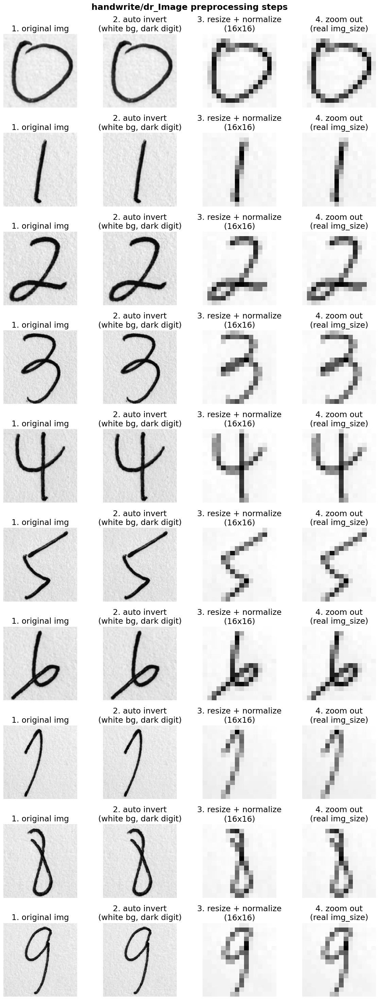

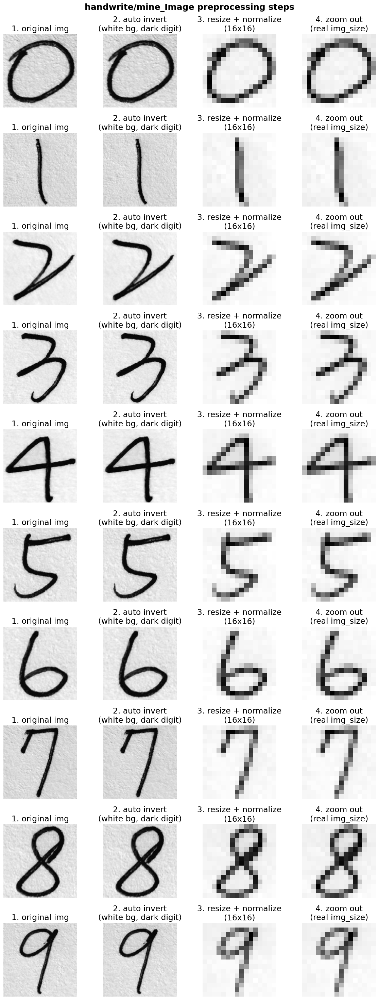

In [26]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_preprocessing(folder_path, n_samples=10, img_size=(16, 16)):

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    # 每張圖顯示 4 個步驟
    fig, axes = plt.subplots(n_samples, 4, figsize=(12, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    fig.suptitle(f'{folder_path}_Image preprocessing steps', fontsize=18, fontweight='bold')

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉 → 確保是「白底黑字」
        if np.mean(gray) < 128:
            inv = 255 - gray   # 原本偏暗，視為黑底白字 → 反轉
        else:
            inv = gray.copy()  # 原本就白底黑字，不動

        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2. auto invert\n(white bg, dark digit)')
        axes[idx, 1].axis('off')

        # 3. 整張縮放到 img_size，並做對比拉伸
        digit_small = cv2.resize(
            inv, img_size,
            interpolation=cv2.INTER_AREA
        )

        # 這裡就是模型要吃的 16x16 灰階
        axes[idx, 2].imshow(digit_small, cmap='gray')
        axes[idx, 2].set_title(f'3. resize + normalize\n({img_size[0]}x{img_size[1]})')
        axes[idx, 2].axis('off')

        # 4. 放大顯示（只是放大，不改變數值）
        disp = cv2.resize(
            digit_small, (64, 64),
            interpolation=cv2.INTER_NEAREST
        )
        axes[idx, 3].imshow(disp, cmap='gray')
        axes[idx, 3].set_title('4. zoom out\n(real img_size)')
        axes[idx, 3].axis('off')


    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()


visualize_preprocessing('handwrite/dr', n_samples=10, img_size=(16, 16))
visualize_preprocessing('handwrite/mine', n_samples=10, img_size=(16, 16))


In [27]:
# 使用load_handwrite_original
print("\n" + "="*70)
print("使用load_handwrite_original處理重新預測")
print("="*70)

# 1) 醫師的手寫
X_dr_enhanced, dr_names = load_handwrite_original('handwrite/dr')
dr_preds_new, dr_dists_new, _ = classifier.predict_batch(X_dr_enhanced)

print("\n=== handwrite/dr 預測結果 ===")
for name, pred, dist in zip(dr_names, dr_preds_new, dr_dists_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小距離: {dist:.4f})")

# 2) 我的手寫
X_mine_enhanced, mine_names = load_handwrite_original('handwrite/mine')
mine_preds_new, mine_dists_new, _ = classifier.predict_batch(X_mine_enhanced)

print("\n=== handwrite/mine 預測結果 ===")
for name, pred, dist in zip(mine_names, mine_preds_new, mine_dists_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小距離: {dist:.4f})")



使用load_handwrite_original處理重新預測

從 handwrite/dr 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 ===
檔名:  0.jpg -> 預測數字: 2 (最小距離: 3.9391)
檔名:  1.jpg -> 預測數字: 2 (最小距離: 3.7503)
檔名:  2.jpg -> 預測數字: 2 (最小距離: 3.5543)
檔名:  3.jpg -> 預測數字: 3 (最小距離: 3.4719)
檔名:  4.jpg -> 預測數字: 4 (最小距離: 3.6847)
檔名:  5.jpg -> 預測數字: 2 (最小距離: 3.8106)
檔名:  6.jpg -> 預測數字: 2 (最小距離: 3.9943)
檔名:  7.jpg -> 預測數字: 2 (最小距離: 3.1934)
檔名:  8.jpg -> 預測數字: 2 (最小距離: 3.3307)
檔名:  9.jpg -> 預測數字: 2 (最小距離: 3.2431)

從 handwrite/mine 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 ===
檔名:  0.jpg -> 預測數字: 0 (最小距離: 4.7475)
檔名:  1.jpg -> 預測數字: 2 (最小距離: 3.3921)
檔名:  2.jpg -> 預測數字: 2 (最小距離: 4.0357)
檔名:  3.jpg -> 預測數字: 3 (最小距離: 4.6008)
檔名:  4.jpg -> 預測數字: 5 (最小距離: 5.28

In [28]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)

print(f"dr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)

print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 3 / 10
mine 正確 3 / 10


2.手寫字_無框ROI+字體加粗

In [29]:
import os
import cv2
import numpy as np

def load_handwrite_enhanced(folder_path, img_size=(16, 16)):

    images = []
    names = []

    print(f"\n從 {folder_path} 載入並增強圖片...")

    for filename in sorted(os.listdir(folder_path)):
        if not filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            continue

        img_path = os.path.join(folder_path, filename)

        # 0. 讀取灰階
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if gray is None:
            continue

        # 1. 自動判斷是否需要反轉
        mean_val = np.mean(gray)
        if mean_val < 128:          # 平均偏暗，視為黑底白字
            gray = 255 - gray       # 反轉成白底黑字（淺背景、深字）

        # 2. 直接把整張灰階圖縮放到指定大小 (例如 16x16)
        digit_small = cv2.resize(
            gray, img_size,
            interpolation=cv2.INTER_AREA
        )

        # 3. 在 16x16 灰階圖上做「反轉 + 膨脹 + 再反轉」來加粗深色筆劃
        inv_small = 255 - digit_small              # 深色數字 → 變亮
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick         # 反轉回深色數字

        # 4. 做一點對比拉伸，讓數字更黑、背景更白
        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        # 5. 正規化到 [0, 1]
        img_normalized = digit_thick_gray.astype(np.float32) / 255.0

        # 6. flatten 成 1D 向量
        images.append(img_normalized.flatten())
        names.append(filename)

        print(f"  ✓ 處理: {filename}")

    images = np.array(images)
    print(f"共載入 {len(images)} 張圖片\n")
    return images, names


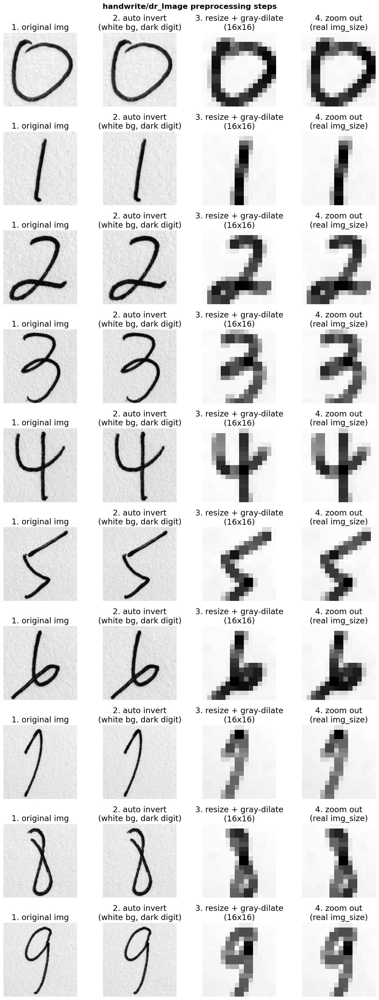

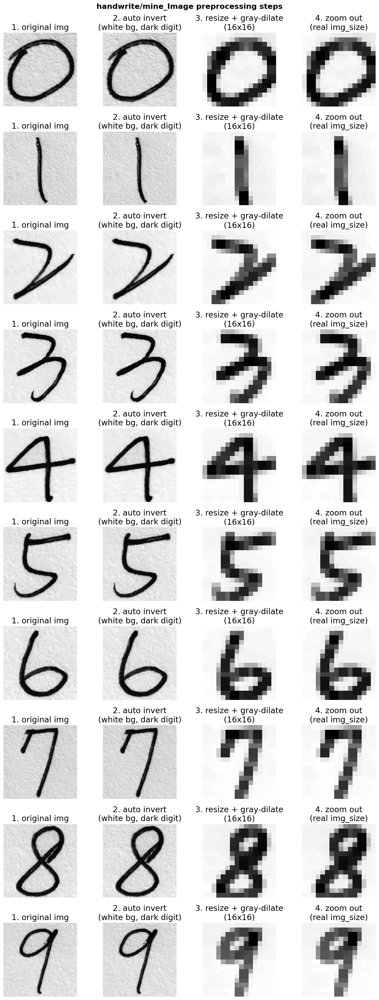

In [30]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_preprocessing(folder_path, n_samples=10, img_size=(16, 16)):

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    # 每張圖顯示 4 個步驟
    fig, axes = plt.subplots(n_samples, 4, figsize=(12, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    fig.suptitle(f'{folder_path}_Image preprocessing steps', fontsize=16, fontweight='bold')

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉
        if np.mean(gray) < 128:
            inv = 255 - gray
        else:
            inv = gray.copy()

        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2. auto invert\n(white bg, dark digit)')
        axes[idx, 1].axis('off')

        # 3. 整張縮放到 img_size，並在灰階上加粗筆劃
        digit_small = cv2.resize(
            inv, img_size,
            interpolation=cv2.INTER_AREA
        )

        # 反轉 + 膨脹 + 再反轉（加粗深色筆劃）
        inv_small = 255 - digit_small
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick

        # 對比拉伸
        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        # 這裡就已經是模型要吃的 16x16 灰階
        axes[idx, 2].imshow(digit_thick_gray, cmap='gray')
        axes[idx, 2].set_title(f'3. resize + gray-dilate\n({img_size[0]}x{img_size[1]})')
        axes[idx, 2].axis('off')

        # 4. 放大顯示
        disp = cv2.resize(
            digit_thick_gray, (64, 64),
            interpolation=cv2.INTER_NEAREST
        )
        axes[idx, 3].imshow(disp, cmap='gray')
        axes[idx, 3].set_title('4. zoom out\n(real img_size)')
        axes[idx, 3].axis('off')



    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()

visualize_preprocessing('handwrite/dr',   n_samples=10, img_size=(16, 16))
visualize_preprocessing('handwrite/mine', n_samples=10, img_size=(16, 16))


In [31]:
# 使用增強版函數
print("\n" + "="*70)
print("使用增強版預處理重新預測")
print("="*70)

# 1) 醫師的手寫
X_dr_enhanced, dr_names = load_handwrite_enhanced('handwrite/dr')
dr_preds_new, dr_dists_new, _ = classifier.predict_batch(X_dr_enhanced)

print("\n=== handwrite/dr 增強後預測結果 ===")
for name, pred, dist in zip(dr_names, dr_preds_new, dr_dists_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小距離: {dist:.4f})")

# 2) 我的手寫
X_mine_enhanced, mine_names = load_handwrite_enhanced('handwrite/mine')
mine_preds_new, mine_dists_new, _ = classifier.predict_batch(X_mine_enhanced)

print("\n=== handwrite/mine 增強後預測結果 ===")
for name, pred, dist in zip(mine_names, mine_preds_new, mine_dists_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小距離: {dist:.4f})")



使用增強版預處理重新預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 增強後預測結果 ===
檔名:  0.jpg -> 預測數字: 0 (最小距離: 4.7897)
檔名:  1.jpg -> 預測數字: 1 (最小距離: 3.1194)
檔名:  2.jpg -> 預測數字: 2 (最小距離: 4.4573)
檔名:  3.jpg -> 預測數字: 3 (最小距離: 3.5165)
檔名:  4.jpg -> 預測數字: 4 (最小距離: 3.6581)
檔名:  5.jpg -> 預測數字: 4 (最小距離: 4.5119)
檔名:  6.jpg -> 預測數字: 6 (最小距離: 4.7638)
檔名:  7.jpg -> 預測數字: 1 (最小距離: 3.5969)
檔名:  8.jpg -> 預測數字: 1 (最小距離: 3.9206)
檔名:  9.jpg -> 預測數字: 9 (最小距離: 3.3621)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 增強後預測結果 ===
檔名:  0.jpg -> 預測數字: 0 (最小距離: 5.3632)
檔名:  1.jpg -> 預測數字: 1 (最小距離: 2.6276)
檔名:  2.jpg -> 預測數字: 2 (最小距離: 4.8685)
檔名:  3.jpg -> 預測數字: 3 (最小距離: 4.7010)
檔名:  4.jpg -> 預測數字: 4 (最小距離: 5.2477)
檔名:  5.jp

In [32]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)

print(f"dr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)

print(f"mine 正確 {mine_correct} / {len(mine_names)}")

dr 正確 7 / 10
mine 正確 8 / 10


手寫字_有框ROI+字體加粗

In [33]:
def load_handwrite_enhanced_ROI(folder_path, img_size=(16, 16)):

    images = []
    names = []

    print(f"\n從 {folder_path} 載入並增強圖片...")

    for filename in sorted(os.listdir(folder_path)):
        if not filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            continue

        img_path = os.path.join(folder_path, filename)

        # 0. 讀取灰階
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if gray is None:
            continue

        # 1. 自動判斷是否需要反轉
        mean_val = np.mean(gray)
        if mean_val < 128:              # 平均偏暗，視為黑底白字
            gray = 255 - gray           # 反轉成白底黑字（淺背景、深字）

        # 2. 用二值化「找位置」(深色數字 → mask 的白色前景)
        _, mask = cv2.threshold(
            gray, 0, 255,
            cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
        )

        # 如果整張都沒有前景，就跳過
        if np.count_nonzero(mask) == 0:
            continue

        # 3. 根據 mask 找 bounding box，裁出數字那一塊（用灰階圖）
        ys, xs = np.where(mask > 0)
        x_min, x_max = xs.min(), xs.max()
        y_min, y_max = ys.min(), ys.max()
        digit_roi = gray[y_min:y_max+1, x_min:x_max+1]

        # 4. 先把 ROI 縮放到指定大小 (16x16)
        digit_small = cv2.resize(
            digit_roi, img_size,
            interpolation=cv2.INTER_AREA
        )

        # 5. 在 16x16 灰階圖上做「反轉 + 膨脹 + 再反轉」來加粗深色筆劃
        #    因為深色數字 → 反轉後變亮，對亮的部分做膨脹，再反轉回來
        inv_small = 255 - digit_small          # 深色數字 → 變亮
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick     # 反轉回深色數字

        # 6. 可以順便做一點對比拉伸
        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        # 7. 正規化到 [0, 1]
        img_normalized = digit_thick_gray.astype(np.float32) / 255.0

        images.append(img_normalized.flatten())
        names.append(filename)

        print(f"  ✓ 處理: {filename}")

    images = np.array(images)
    print(f"共載入 {len(images)} 張圖片\n")
    return images, names

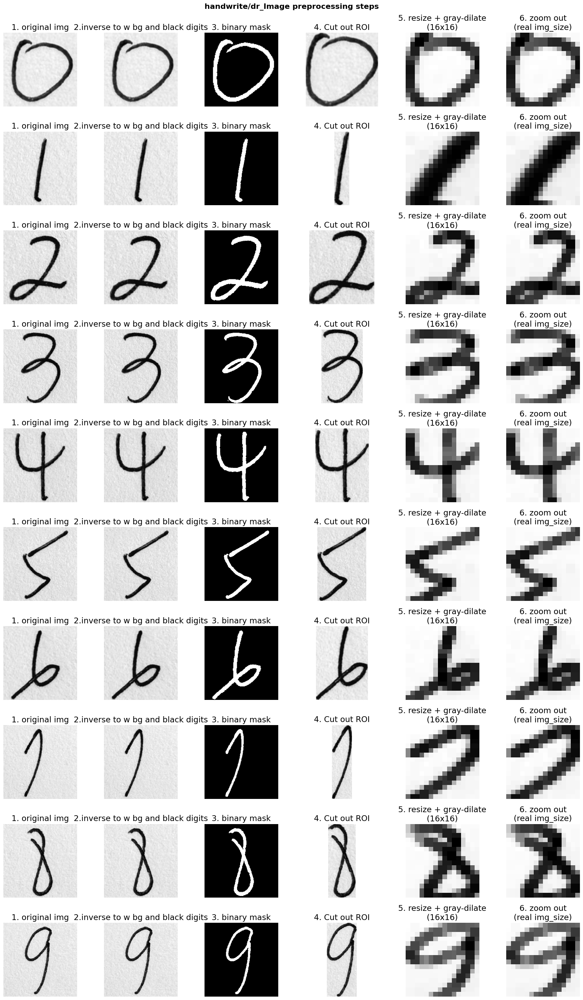

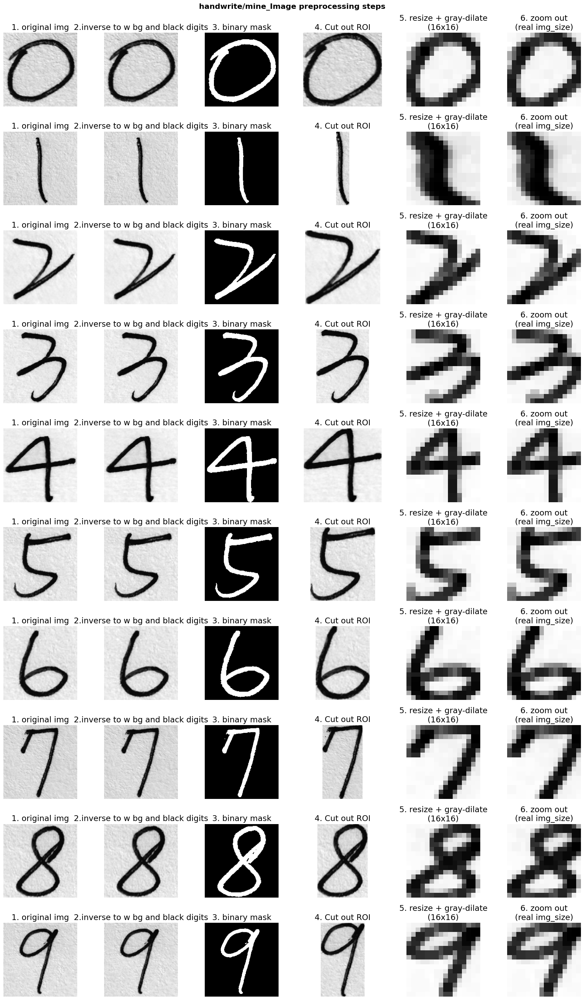

In [34]:
def visualize_preprocessing(folder_path, n_samples=10, img_size=(16, 16)):

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    fig, axes = plt.subplots(n_samples, 6, figsize=(18, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    fig.suptitle(f'{folder_path}_Image preprocessing steps', fontsize=16, fontweight='bold')

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉 → 確保白底黑字
        if np.mean(gray) < 128:
            inv = 255 - gray
        else:
            inv = gray.copy()
        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2.inverse to w bg and black digits')
        axes[idx, 1].axis('off')

        # # 3. 二值化 mask
        _, mask = cv2.threshold(
            inv, 0, 255,
            cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
        )
        axes[idx, 2].imshow(mask, cmap='gray')
        axes[idx, 2].set_title('3. binary mask')
        axes[idx, 2].axis('off')

        # 如果整張都沒有前景，就跳過
        if np.count_nonzero(mask) == 0:
            continue

        # # 4. 根據 mask 裁出 ROI（灰階）
        ys, xs = np.where(mask > 0)
        x_min, x_max = xs.min(), xs.max()
        y_min, y_max = ys.min(), ys.max()
        roi = inv[y_min:y_max+1, x_min:x_max+1]
        axes[idx, 3].imshow(roi, cmap='gray')
        axes[idx, 3].set_title('4. Cut out ROI')
        axes[idx, 3].axis('off')

        # 5. ROI → resize → 在灰階上反轉 + 膨脹 + 再反轉
        digit_small = cv2.resize(
            roi, img_size,
            interpolation=cv2.INTER_AREA
        )

        inv_small = 255 - digit_small
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick

        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        axes[idx, 4].imshow(digit_thick_gray, cmap='gray')
        axes[idx, 4].set_title(f'5. resize + gray-dilate\n({img_size[0]}x{img_size[1]})')
        axes[idx, 4].axis('off')

        # 6. 放大顯示
        disp = cv2.resize(
            digit_thick_gray, (64, 64),
            interpolation=cv2.INTER_NEAREST
        )
        axes[idx, 5].imshow(disp, cmap='gray')
        axes[idx, 5].set_title('6. zoom out\n(real img_size)')
        axes[idx, 5].axis('off')



    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()
visualize_preprocessing('handwrite/dr',   n_samples=10, img_size=(16, 16))
visualize_preprocessing('handwrite/mine', n_samples=10, img_size=(16, 16))


In [35]:
# 使用增強版+ROI函數
print("\n" + "="*70)
print("使用增強版+ROI預處理重新預測")
print("="*70)

# 1) 醫師的手寫
X_dr_enhanced, dr_names = load_handwrite_enhanced_ROI('handwrite/dr')
dr_preds_new, dr_dists_new, _ = classifier.predict_batch(X_dr_enhanced)

print("\n=== handwrite/dr 增強+ROI後預測結果 ===")
for name, pred, dist in zip(dr_names, dr_preds_new, dr_dists_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小距離: {dist:.4f})")

# 2) 我的手寫
X_mine_enhanced, mine_names = load_handwrite_enhanced('handwrite/mine')
mine_preds_new, mine_dists_new, _ = classifier.predict_batch(X_mine_enhanced)

print("\n=== handwrite/mine 增強+ROI後預測結果 ===")
for name, pred, dist in zip(mine_names, mine_preds_new, mine_dists_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小距離: {dist:.4f})")



使用增強版+ROI預處理重新預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 增強+ROI後預測結果 ===
檔名:  0.jpg -> 預測數字: 5 (最小距離: 7.1267)
檔名:  1.jpg -> 預測數字: 2 (最小距離: 6.7599)
檔名:  2.jpg -> 預測數字: 2 (最小距離: 6.2777)
檔名:  3.jpg -> 預測數字: 3 (最小距離: 6.5041)
檔名:  4.jpg -> 預測數字: 4 (最小距離: 5.4101)
檔名:  5.jpg -> 預測數字: 4 (最小距離: 5.9820)
檔名:  6.jpg -> 預測數字: 2 (最小距離: 5.7850)
檔名:  7.jpg -> 預測數字: 5 (最小距離: 6.7692)
檔名:  8.jpg -> 預測數字: 3 (最小距離: 6.2352)
檔名:  9.jpg -> 預測數字: 5 (最小距離: 5.9857)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 增強+ROI後預測結果 ===
檔名:  0.jpg -> 預測數字: 0 (最小距離: 5.3632)
檔名:  1.jpg -> 預測數字: 1 (最小距離: 2.6276)
檔名:  2.jpg -> 預測數字: 2 (最小距離: 4.8685)
檔名:  3.jpg -> 預測數字: 3 (最小距離: 4.7010)
檔名:  4.jpg -> 預測數字: 4 (最小距離: 5.247

In [36]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)

print(f"dr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)

print(f"mine 正確 {mine_correct} / {len(mine_names)}")

dr 正確 3 / 10
mine 正確 8 / 10


## 方法二 :SVD


In [37]:
import os
import cv2
import numpy as np

from sklearn.metrics import (
    confusion_matrix,
    accuracy_score,
    classification_report,
    mean_squared_error
)

In [38]:
# ============================================================
# 1.先蒐集訓練的影像資料，彙整成第一步需要的tensor
# ============================================================
def load_usps_split(base_path, img_size=(16, 16)):

    images = []
    labels = []

    print(f"正在載入資料從：{base_path}")

    for digit in range(10):
        digit_path = os.path.join(base_path, str(digit))

        if not os.path.exists(digit_path):
            print(f"  警告：找不到資料夾 {digit_path}")
            continue

        img_files = os.listdir(digit_path)
        print(f"  數字 {digit}: 找到 {len(img_files)} 張圖片")

        for filename in img_files:
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                img_path = os.path.join(digit_path, filename)
                img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

                if img is not None:
                    # 統一影像大小
                    if img.shape != img_size:
                        img = cv2.resize(img, img_size)

                    # 正規化到 [0, 1]
                    img = img.astype(np.float32) / 255.0

                    images.append(img)
                    labels.append(digit)

    images = np.array(images)   # shape: (N, H, W)---->tensor
    labels = np.array(labels)   # shape: (N,)
    print(f"載入完成：{base_path} -> images 形狀 {images.shape}")
    return images, labels

load_usps_split("/content/usps_inverted/train", img_size=(16, 16))

正在載入資料從：/content/usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：/content/usps_inverted/train -> images 形狀 (7291, 16, 16)


(array([[[1.        , 1.        , 0.91764706, ..., 1.        ,
          1.        , 1.        ],
         [1.        , 0.91764706, 0.05098039, ..., 1.        ,
          1.        , 1.        ],
         [1.        , 0.8392157 , 0.01176471, ..., 0.92156863,
          1.        , 1.        ],
         ...,
         [1.        , 1.        , 0.21568628, ..., 0.9843137 ,
          1.        , 1.        ],
         [1.        , 1.        , 0.89411765, ..., 1.        ,
          1.        , 1.        ],
         [1.        , 1.        , 1.        , ..., 1.        ,
          1.        , 1.        ]],
 
        [[1.        , 1.        , 1.        , ..., 1.        ,
          1.        , 1.        ],
         [1.        , 1.        , 1.        , ..., 1.        ,
          1.        , 1.        ],
         [1.        , 1.        , 0.96862745, ..., 0.7372549 ,
          1.        , 1.        ],
         ...,
         [1.        , 0.9372549 , 0.19215687, ..., 0.33333334,
          0.99607843, 1.

In [39]:
# ============================================================
# 2. 建立「每一個 digit 一個 SVD 子空間」
#    對同一類別的所有訓練樣本一起做 SVD
# ============================================================

def build_svd_subspaces_per_digit(train_imgs, train_labels, k):

    H, W = train_imgs.shape[1], train_imgs.shape[2]
    D = H * W

    subspaces = {}

    print(f"\n開始為每個 digit 建立 SVD 子空間 (要求 k = {k}) ...")

    for digit in range(10):
        # 取出該 digit 的所有訓練樣本
        idx = np.where(train_labels == digit)[0]
        if len(idx) == 0:
            print(f"  警告：digit {digit} 沒有訓練資料，略過")
            continue

        Xc = train_imgs[idx].reshape(len(idx), D)  # (n_c, D)

        # 類別平均 μ_c
        mean_c = Xc.mean(axis=0)                   # (D,)

        # 去平均
        Xc_centered = Xc - mean_c                 # (n_c, D)

        # 做 SVD：Xc_centered = U S V^T
        # 這裡 feature space 的正交基底在 V (右奇異向量)
        U, S, Vt = np.linalg.svd(Xc_centered, full_matrices=False)

        # 實際可用的最大 k_c
        k_c = min(k, Vt.shape[0])

        # 取前 k_c 個右奇異向量的轉置當作 U_k（D x k_c）
        Uk = Vt[:k_c, :].T                        # (D, k_c)

        subspaces[digit] = {
            'mean': mean_c,
            'Uk':   Uk
        }

        print(f"  digit {digit}: n = {len(idx)}, 實際使用 k_c = {k_c}")

    return subspaces

In [40]:
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# residual 計算函式
# residual_c = || (I - Uk Uk^T) (x - μ_c) ||_2
# ============================================================

def residual_norm_svd(x, mean_c, Uk):

    # 1. 去平均：z = x - μ_c
    z = x - mean_c                    # (D,)

    # 2. 投影到子空間：proj = Uk (Uk^T z)
    coeff = Uk.T @ z                  # (k_c,)
    proj  = Uk @ coeff               # (D,)

    # 3. 殘差向量：(I - Uk Uk^T) z = z - proj
    res_vec = z - proj                # (D,)

    # 4. 取 2-norm
    residual = np.linalg.norm(res_vec, ord=2)
    return residual


In [41]:
# ============================================================
# 3. 使用「每個 digit 的 SVD 子空間」做分類
#    residual_c = || (I - U_k U_k^T) (x - μ_c) ||_2
# ============================================================

def classify_with_svd_subspaces_formula(subspaces, test_imgs):

    N_test = test_imgs.shape[0]
    H, W   = test_imgs.shape[1], test_imgs.shape[2]
    D      = H * W

    # flatten 每張圖 → (N_test, D)
    X_test_flat = test_imgs.reshape(N_test, D)

    y_pred = []
    residuals_pred = []

    digits = sorted(subspaces.keys())

    print("\n開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...")

    for i, x in enumerate(X_test_flat):
        best_digit    = None
        best_residual = None

        for digit in digits:
            mean_c = subspaces[digit]['mean']   # (D,)
            Uk     = subspaces[digit]['Uk']     # (D, k_c)

            residual = residual_norm_svd(x, mean_c, Uk)

            if (best_residual is None) or (residual < best_residual):
                best_residual = residual
                best_digit    = digit

        y_pred.append(best_digit)
        residuals_pred.append(best_residual)

        if (i + 1) % 200 == 0 or (i + 1) == N_test:
            print(f"  已完成 {i+1}/{N_test} 張 test")

    return np.array(y_pred), np.array(residuals_pred)


In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

def visualize_svd_confusion_matrix(conf_matrix, accuracy, k=20):
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix,
                annot=True,
                fmt='d',
                cmap='Blues',
                xticklabels=range(10),
                yticklabels=range(10))

    plt.title(f'Confusion Matrix - SVD Subspace (k={k})\nAccuracy: {accuracy:.2%}',
              fontsize=14, weight='bold')
    plt.xlabel('Predicted Label', fontsize=12)
    plt.ylabel('True Label', fontsize=12)

    plt.tight_layout()
    plt.savefig(f'SVD_confusion_matrix_k{k}.png', dpi=150, bbox_inches='tight')
    plt.show()


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)

現在使用 k = 2 的子空間做分類

開始為每個 digit 建立 SVD 子空間 (要求 k = 2) ...
  digit 0: n = 1194, 實際使用 k_c = 2
  digit 1: n = 1005, 實際使用 k_c = 2
  digit 2: n = 731, 實際使用 k_c = 2
  digit 3: n = 658, 實際使用 k_c = 2
  digit 4: n = 652, 實際使用 k_c = 2
  digit 5: n = 556, 實際使用 k_c = 2
  digit 6: n = 664, 實際使用 k_c = 2
  digit 7: n = 645, 實際使用 k_c = 2
  digit 8: n = 542, 實際使用 k_c = 2
  digit 9: n = 644, 實際使用 k_c = 2

開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 200/

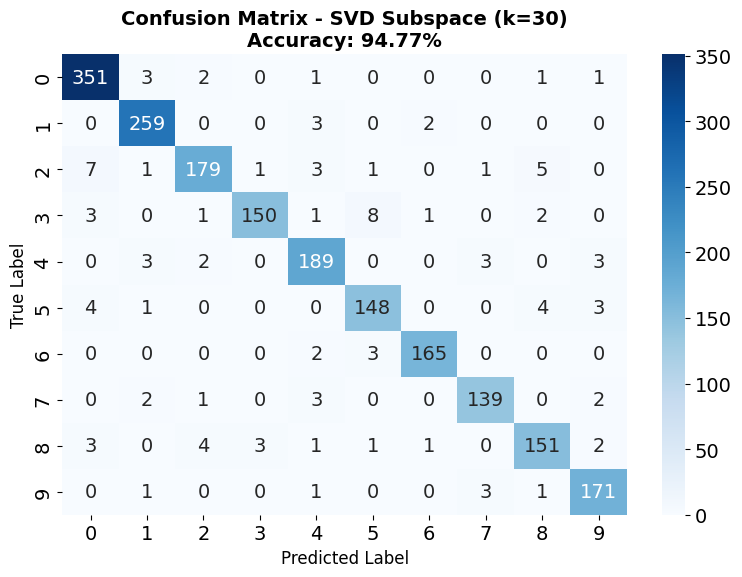


現在使用 k = 40 的子空間做分類

開始為每個 digit 建立 SVD 子空間 (要求 k = 40) ...
  digit 0: n = 1194, 實際使用 k_c = 40
  digit 1: n = 1005, 實際使用 k_c = 40
  digit 2: n = 731, 實際使用 k_c = 40
  digit 3: n = 658, 實際使用 k_c = 40
  digit 4: n = 652, 實際使用 k_c = 40
  digit 5: n = 556, 實際使用 k_c = 40
  digit 6: n = 664, 實際使用 k_c = 40
  digit 7: n = 645, 實際使用 k_c = 40
  digit 8: n = 542, 實際使用 k_c = 40
  digit 9: n = 644, 實際使用 k_c = 40

開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 200/2007 張 test
  已完成 400/2007 張 test
  已完成 600/2007 張 test
  已完成 800/2007 張 test
  已完成 1000/2007 張 test
  已完成 1200/2007 張 test
  已完成 1400/2007 張 test
  已完成 1600/2007 張 test
  已完成 1800/2007 張 test
  已完成 2000/2007 張 test
  已完成 2007/2007 張 test

=== k = 40 的結果 ===
Accuracy : 0.9367214748380668
Label RMSE (均方根誤差): 1.0214442133648036

分類報告：
              precision    recall  f1-score   support

           0       0.96      0.98      0.97       359
           1       0.93      0.98      0.96       264
           2       0.93      0.9

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [43]:
# ============================================================
# 4. 主程式：多個 k 值，分別計算 accuracy 與 label RMSE
# ============================================================

def main():

    TRAIN_PATH = 'usps_inverted/train'
    TEST_PATH  = 'usps_inverted/test'
    img_size = (16, 16)

    # 想要測試的 k 清單
    K_LIST = [2,10,15,20,30,40,50,255]

    # =================================

    # Step 1: 載入一次 train / test 資料
    X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=img_size)
    X_test_imgs,  y_test  = load_usps_split(TEST_PATH,  img_size=img_size)

    for k in K_LIST:
        print("\n" + "=" * 60)
        print(f"現在使用 k = {k} 的子空間做分類")
        print("=" * 60)

        # Step 2: 建立每個 digit 的 SVD 子空間
        subspaces = build_svd_subspaces_per_digit(X_train_imgs, y_train, k)

        # Step 3: 用公式做分類
        y_pred, residuals_pred = classify_with_svd_subspaces_formula(subspaces, X_test_imgs)

        # Step 4: 評估
        acc = accuracy_score(y_test, y_pred)
        mse_labels = mean_squared_error(y_test, y_pred)
        rmse_labels = np.sqrt(mse_labels)

        print(f"\n=== k = {k} 的結果 ===")
        print("Accuracy :", acc)
        print("Label RMSE (均方根誤差):", rmse_labels)

        print("\n分類報告：")
        print(classification_report(y_test, y_pred))

        cm = confusion_matrix(y_test, y_pred)
        print("Confusion Matrix：")
        print(cm)

        if k == 30:
            visualize_svd_confusion_matrix(cm, acc, k)


if __name__ == "__main__":
    main()

In [44]:
##
K = 30
TRAIN_PATH = 'usps_inverted/train'
TEST_PATH  = 'usps_inverted/test'
img_size = (16, 16)
X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=img_size)
X_test_imgs,  y_test  = load_usps_split(TEST_PATH,  img_size=img_size)

正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)


In [45]:
# ============================================================
# 4. 視覺化：某個 digit 的 residual 分佈 residual_c
# ============================================================

def visualize_residual_confusion(digit, test_imgs, y_test, subspaces):

    N_test = test_imgs.shape[0]
    H, W   = test_imgs.shape[1], test_imgs.shape[2]
    D      = H * W

    # flatten 測試影像
    X_test_flat = test_imgs.reshape(N_test, D)

    # 找出所有真實標籤是 digit 的樣本 index
    digit_indices = np.where(y_test == digit)[0]
    print(f"\n分析數字 {digit} 的 residual 分佈 (共 {len(digit_indices)} 個樣本)")

    digits = sorted(subspaces.keys())

    # 收集每一個樣本的 residual 曲線
    all_residuals = []

    for idx in digit_indices:
        x = X_test_flat[idx]
        residuals_to_all = []

        for d in digits:
            mean_c = subspaces[d]['mean']   # (D,)
            Uk     = subspaces[d]['Uk']     # (D, k_c)
            r = residual_norm_svd(x, mean_c, Uk)
            residuals_to_all.append(r)

        all_residuals.append(residuals_to_all)

    all_residuals = np.array(all_residuals)   # (N_samples_digit, 10)

    # --- 畫圖 ---
    plt.figure(figsize=(12, 6))

    # 每個樣本一條藍線
    for r in all_residuals:
        plt.plot(digits, r, alpha=0.2, color='blue')

    # 平均 residual（紅線）
    avg_residuals = all_residuals.mean(axis=0)
    plt.plot(digits, avg_residuals, 'r-', linewidth=3, label='mean residual')

    plt.xlabel('Digit subspace k', fontsize=12)
    plt.ylabel(r'Residual norm $\|(I - U_k U_k^T)(x - \mu_k)\|_2$', fontsize=12)
    plt.title(f'No. {digit} residual to every digit subspace', fontsize=14, fontweight='bold')
    plt.xticks(digits)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.show()

    # --- 找最容易混淆 / 最不像的類別（依平均 residual）---
    avg_for_arg = avg_residuals.copy()

    # 把自己那類先設成 inf，只考慮其他類
    self_idx = digits.index(digit)
    avg_for_arg[self_idx] = np.inf

    confused_with = digits[np.argmin(avg_for_arg)]
    worst_with    = digits[np.argmax(avg_for_arg)]

    print(f"數字 {digit} 最容易被混淆為: {confused_with} (平均 residual = {avg_residuals[confused_with]:.4f})")
    print(f"數字 {digit} 最不像的是: {worst_with} (平均 residual = {avg_residuals[worst_with]:.4f})")



開始為每個 digit 建立 SVD 子空間 (要求 k = 30) ...
  digit 0: n = 1194, 實際使用 k_c = 30
  digit 1: n = 1005, 實際使用 k_c = 30
  digit 2: n = 731, 實際使用 k_c = 30
  digit 3: n = 658, 實際使用 k_c = 30
  digit 4: n = 652, 實際使用 k_c = 30
  digit 5: n = 556, 實際使用 k_c = 30
  digit 6: n = 664, 實際使用 k_c = 30
  digit 7: n = 645, 實際使用 k_c = 30
  digit 8: n = 542, 實際使用 k_c = 30
  digit 9: n = 644, 實際使用 k_c = 30

開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 200/2007 張 test
  已完成 400/2007 張 test
  已完成 600/2007 張 test
  已完成 800/2007 張 test
  已完成 1000/2007 張 test
  已完成 1200/2007 張 test
  已完成 1400/2007 張 test
  已完成 1600/2007 張 test
  已完成 1800/2007 張 test
  已完成 2000/2007 張 test
  已完成 2007/2007 張 test

分析數字 0 的 residual 分佈 (共 359 個樣本)


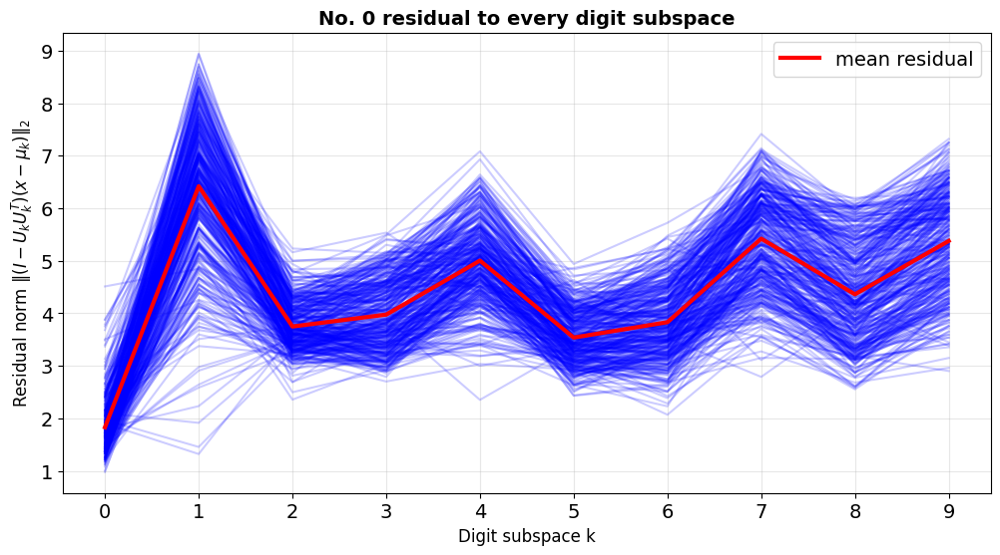

數字 0 最容易被混淆為: 5 (平均 residual = 3.5375)
數字 0 最不像的是: 0 (平均 residual = 1.8288)

分析數字 1 的 residual 分佈 (共 264 個樣本)


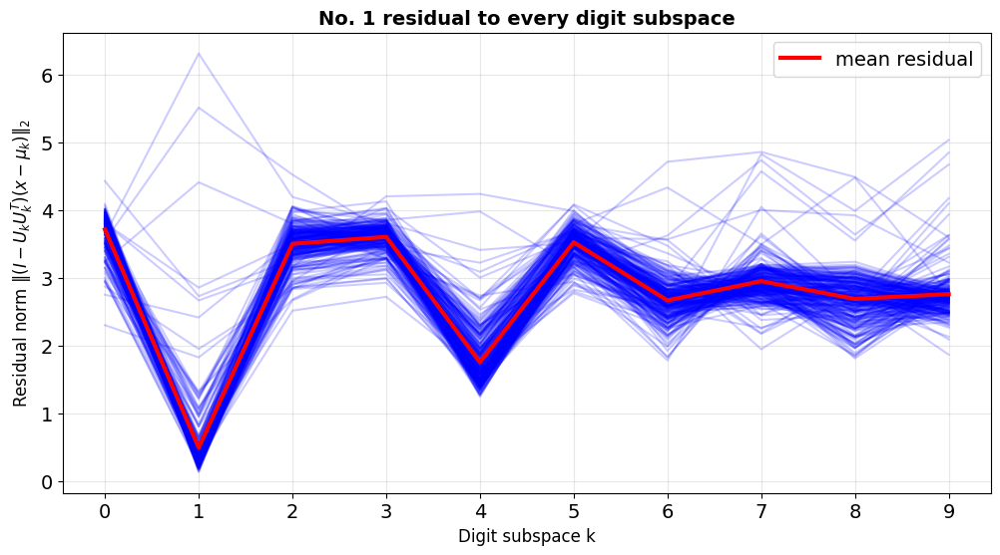

數字 1 最容易被混淆為: 4 (平均 residual = 1.7603)
數字 1 最不像的是: 1 (平均 residual = 0.4991)

分析數字 4 的 residual 分佈 (共 200 個樣本)


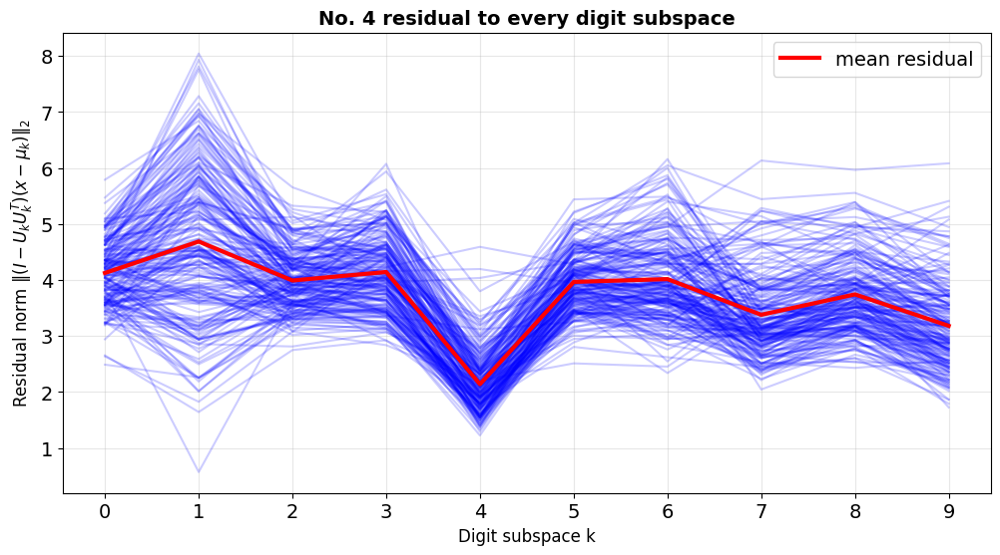

數字 4 最容易被混淆為: 9 (平均 residual = 3.1826)
數字 4 最不像的是: 4 (平均 residual = 2.1412)

分析數字 6 的 residual 分佈 (共 170 個樣本)


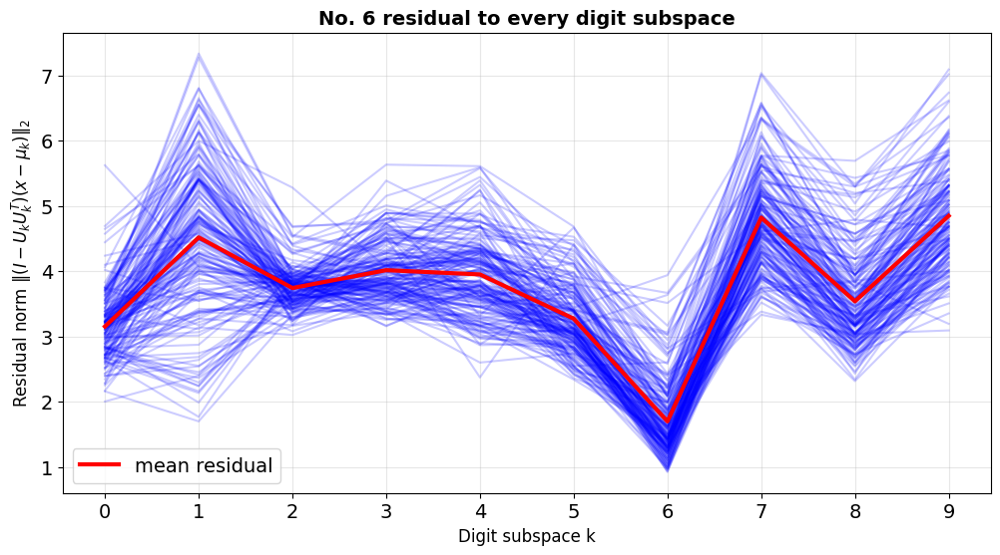

數字 6 最容易被混淆為: 0 (平均 residual = 3.1548)
數字 6 最不像的是: 6 (平均 residual = 1.7019)


In [46]:
# ============  k = 30 時 residual 與數字的關係 ============

# 1. 建立 K=30 的 SVD 子空間
K = 30
subspaces_k30 = build_svd_subspaces_per_digit(X_train_imgs, y_train, k=K)

# 2.（選擇性）用 K=30 做分類
y_pred_svd_30, residuals_pred_30 = classify_with_svd_subspaces_formula(
    subspaces_k30, X_test_imgs
)

# 3. 視覺化某些數字的 residual 分佈（K=30 的結果）
visualize_residual_confusion(0, X_test_imgs, y_test, subspaces_k30)
visualize_residual_confusion(1, X_test_imgs, y_test, subspaces_k30)
visualize_residual_confusion(4, X_test_imgs, y_test, subspaces_k30)
visualize_residual_confusion(6, X_test_imgs, y_test, subspaces_k30)


In [47]:
# ================= 視覺化前置 =================
import matplotlib.pyplot as plt
import math

TRAIN_PATH = 'usps_inverted/train'
TEST_PATH  = 'usps_inverted/test'
img_size   = (16, 16)
H, W       = img_size

# 重新載入一次資料
X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=img_size)
X_test_imgs,  y_test  = load_usps_split(TEST_PATH,  img_size=img_size)


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)



開始為每個 digit 建立 SVD 子空間 (要求 k = 30) ...
  digit 0: n = 1194, 實際使用 k_c = 30
  digit 1: n = 1005, 實際使用 k_c = 30
  digit 2: n = 731, 實際使用 k_c = 30
  digit 3: n = 658, 實際使用 k_c = 30
  digit 4: n = 652, 實際使用 k_c = 30
  digit 5: n = 556, 實際使用 k_c = 30
  digit 6: n = 664, 實際使用 k_c = 30
  digit 7: n = 645, 實際使用 k_c = 30
  digit 8: n = 542, 實際使用 k_c = 30
  digit 9: n = 644, 實際使用 k_c = 30


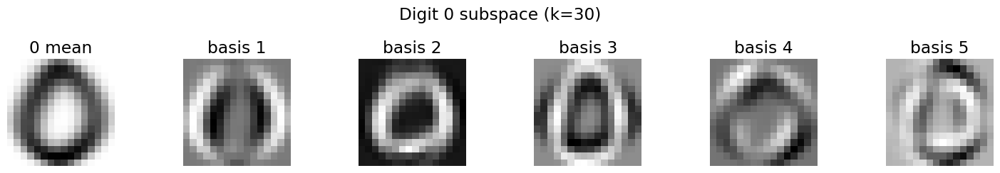

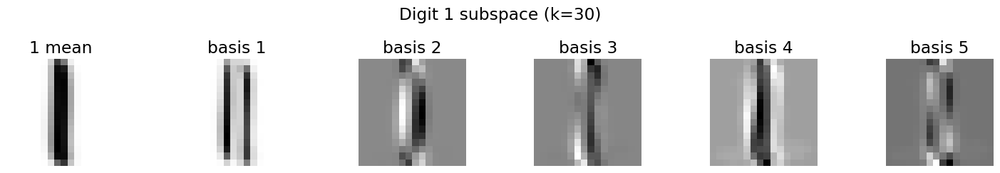

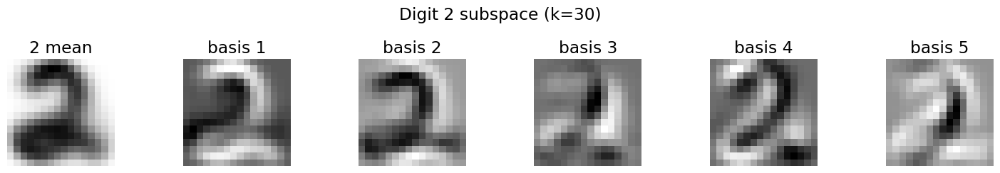

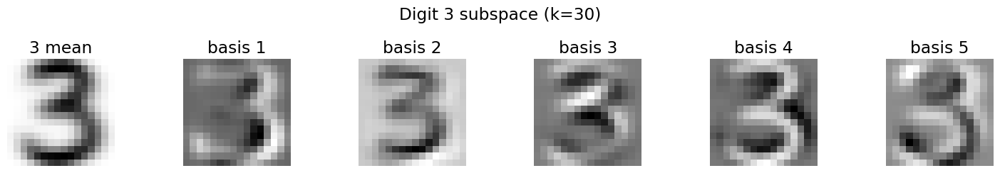

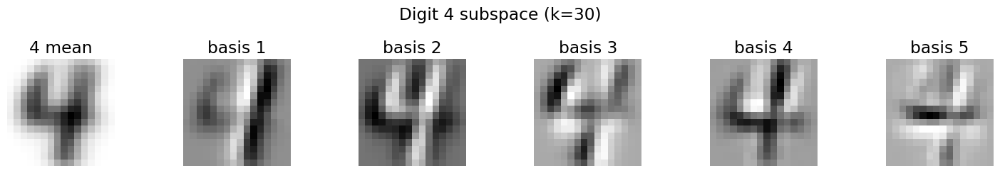

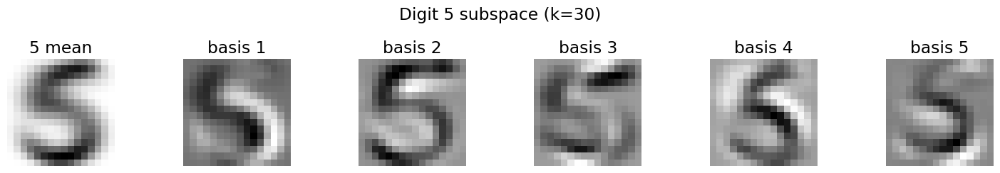

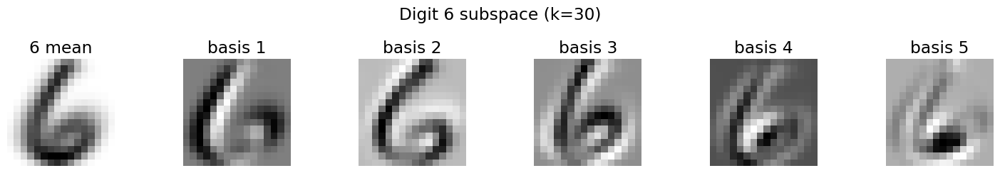

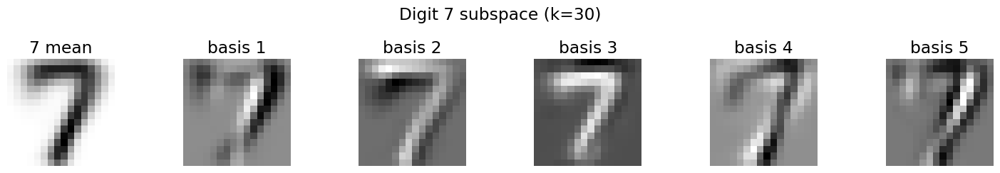

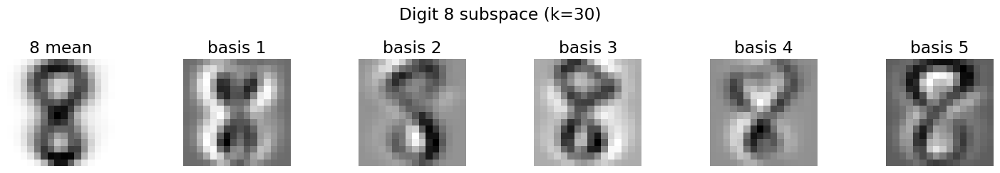

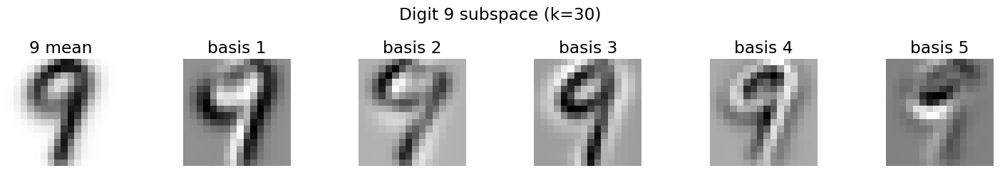

In [48]:
# ============ 1. 0–9 在 k = 30 subspace 的樣子 ============

k_vis = 30
subspaces_30 = build_svd_subspaces_per_digit(X_train_imgs, y_train, k_vis)

for digit in range(10):
    if digit not in subspaces_30:
        print(f"digit {digit} 沒有 subspace，被略過")
        continue

    info = subspaces_30[digit]
    mean_img = info['mean'].reshape(H, W)
    Uk       = info['Uk']          # (D, k_c)
    k_c      = Uk.shape[1]

    # 要顯示幾個 basis（最多不超過 k_c）
    n_show = min(5, k_c)

    fig, axes = plt.subplots(1, n_show + 1,
                             figsize=(2.5 * (n_show + 1), 2.5))

    # 第 1 張：平均影像
    axes[0].imshow(mean_img, cmap='gray')
    axes[0].set_title(f'{digit} mean')
    axes[0].axis('off')

    # 後面：前幾個 basis
    for i in range(n_show):
        basis_img = Uk[:, i].reshape(H, W)
        axes[i + 1].imshow(basis_img, cmap='gray')
        axes[i + 1].set_title(f'basis {i+1}')
        axes[i + 1].axis('off')

    plt.suptitle(f'Digit {digit} subspace (k={k_vis})')
    plt.tight_layout()
    plt.show()



Use k = 20's subspace (for visualization)

開始為每個 digit 建立 SVD 子空間 (要求 k = 20) ...
  digit 0: n = 1194, 實際使用 k_c = 20
  digit 1: n = 1005, 實際使用 k_c = 20
  digit 2: n = 731, 實際使用 k_c = 20
  digit 3: n = 658, 實際使用 k_c = 20
  digit 4: n = 652, 實際使用 k_c = 20
  digit 5: n = 556, 實際使用 k_c = 20
  digit 6: n = 664, 實際使用 k_c = 20
  digit 7: n = 645, 實際使用 k_c = 20
  digit 8: n = 542, 實際使用 k_c = 20
  digit 9: n = 644, 實際使用 k_c = 20

開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 200/2007 張 test
  已完成 400/2007 張 test
  已完成 600/2007 張 test
  已完成 800/2007 張 test
  已完成 1000/2007 張 test
  已完成 1200/2007 張 test
  已完成 1400/2007 張 test
  已完成 1600/2007 張 test
  已完成 1800/2007 張 test
  已完成 2000/2007 張 test
  已完成 2007/2007 張 test

Use k = 30's subspace (for visualization)

開始為每個 digit 建立 SVD 子空間 (要求 k = 30) ...
  digit 0: n = 1194, 實際使用 k_c = 30
  digit 1: n = 1005, 實際使用 k_c = 30
  digit 2: n = 731, 實際使用 k_c = 30
  digit 3: n = 658, 實際使用 k_c = 30
  digit 4: n = 652, 實際使用 k_c = 30
  digit 5: n =

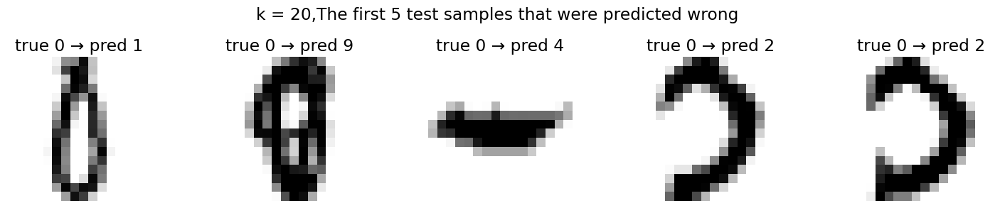

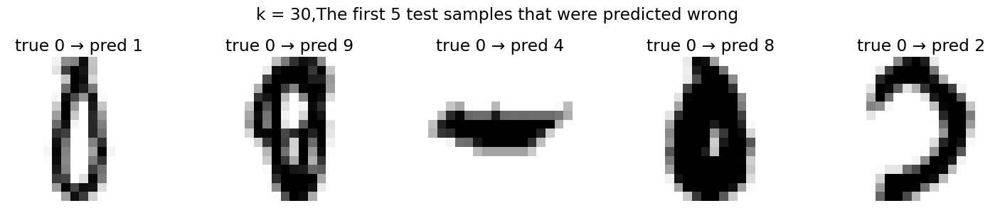

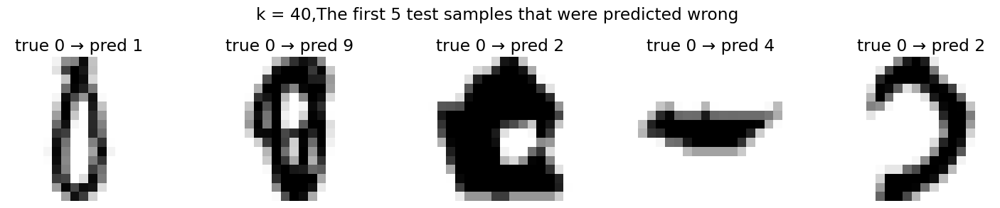

In [49]:
# ============ 2. 不同 k 時，預測錯誤的前5 個樣本 ============

K_LIST = [20,30,40]
results = {}

# 先把每個 k 的分類結果算好
for k in K_LIST:
    print("\n" + "=" * 60)
    print(f"Use k = {k}'s subspace (for visualization)")
    print("=" * 60)

    subspaces_k = build_svd_subspaces_per_digit(X_train_imgs, y_train, k)
    y_pred_k, residuals_k = classify_with_svd_subspaces_formula(subspaces_k, X_test_imgs)

    results[k] = {
        'subspaces': subspaces_k,
        'y_pred': y_pred_k,
        'residuals': residuals_k,
    }

# 對每個 k，畫出「預測錯誤的前 5 張」
for k in K_LIST:
    y_pred = results[k]['y_pred']
    mis_idx = np.where(y_pred != y_test)[0]   # 所有錯誤 index

    if len(mis_idx) == 0:
        print(f"k = {k}: all are correct ")
        continue

    top_idx = mis_idx[:5]                    # 取前 5 個
    n = len(top_idx)

    cols = 5
    rows = math.ceil(n / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(3 * cols, 3 * rows))
    axes = np.array(axes).reshape(-1)

    for ax_i, idx in enumerate(top_idx):
        axes[ax_i].imshow(X_test_imgs[idx], cmap='gray')
        axes[ax_i].set_title(f"true {y_test[idx]} → pred {y_pred[idx]}")
        axes[ax_i].axis('off')

    for j in range(n, rows * cols):
        axes[j].axis('off')

    plt.suptitle( f"k = {k},The first {n} test samples that were predicted wrong ")
    plt.tight_layout()
    plt.show()


## 方法二:SVD_自己手寫預測

In [50]:
TRAIN_PATH = 'usps_inverted/train'
img_size   = (16, 16)
k_best     = 30   # 實驗出來最好的 k

# 1. 載入訓練資料
X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=img_size)

# 2. 建立 SVD 子空間（k = 30）
subspaces_best = build_svd_subspaces_per_digit(X_train_imgs, y_train, k_best)


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)

開始為每個 digit 建立 SVD 子空間 (要求 k = 30) ...
  digit 0: n = 1194, 實際使用 k_c = 30
  digit 1: n = 1005, 實際使用 k_c = 30
  digit 2: n = 731, 實際使用 k_c = 30
  digit 3: n = 658, 實際使用 k_c = 30
  digit 4: n = 652, 實際使用 k_c = 30
  digit 5: n = 556, 實際使用 k_c = 30
  digit 6: n = 664, 實際使用 k_c = 30
  digit 7: n = 645, 實際使用 k_c = 30
  digit 8: n = 542, 實際使用 k_c = 30
  digit 9: n = 644, 實際使用 k_c = 30


1.手寫字_原始版(無框ROI+無字體加粗)


In [51]:
def svd_predict_handwrite_folder(folder_path, subspaces, img_size=(16, 16)):

    X_flat, names = load_handwrite_original(folder_path, img_size=img_size)  # (N, 256)

    # 轉回 (N, H, W) 給 SVD 分類器使用
    H, W = img_size
    X_imgs = X_flat.reshape(-1, H, W)   # (N, H, W)

    # 用 SVD 子空間公式做分類
    y_pred, residuals = classify_with_svd_subspaces_formula(subspaces, X_imgs)

    return names, y_pred, residuals


In [52]:
print("\n" + "="*70)
print("使用 SVD 子空間分類器，對手寫資料重新預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_new, dr_residuals_new = svd_predict_handwrite_folder(
    'handwrite/dr',
    subspaces_best,          # 前面建好的 k=30 子空間
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (SVD) ===")
for name, pred, res in zip(dr_names, dr_preds_new, dr_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_new, mine_residuals_new = svd_predict_handwrite_folder(
    'handwrite/mine',
    subspaces_best,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (SVD) ===")
for name, pred, res in zip(mine_names, mine_preds_new, mine_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")



使用 SVD 子空間分類器，對手寫資料重新預測

從 handwrite/dr 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 10/10 張 test

=== handwrite/dr 預測結果 (SVD) ===
檔名:  0.jpg -> 預測數字: 0 (最小 residual: 2.1547)
檔名:  1.jpg -> 預測數字: 2 (最小 residual: 2.7222)
檔名:  2.jpg -> 預測數字: 2 (最小 residual: 2.4513)
檔名:  3.jpg -> 預測數字: 3 (最小 residual: 2.3288)
檔名:  4.jpg -> 預測數字: 8 (最小 residual: 2.6028)
檔名:  5.jpg -> 預測數字: 5 (最小 residual: 2.4278)
檔名:  6.jpg -> 預測數字: 2 (最小 residual: 2.8805)
檔名:  7.jpg -> 預測數字: 2 (最小 residual: 2.0590)
檔名:  8.jpg -> 預測數字: 5 (最小 residual: 2.2967)
檔名:  9.jpg -> 預測數字: 2 (最小 residual: 2.0330)

從 handwrite/mine 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 10/

In [53]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)
print(f"dr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 4 / 10
mine 正確 5 / 10


In [54]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_preprocessing_svd(folder_path, subspaces, n_samples=10, img_size=(16, 16)):

    # 取得 k
    some_digit = sorted(subspaces.keys())[0]
    k_vis = subspaces[some_digit]['Uk'].shape[1]

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    fig, axes = plt.subplots(n_samples, 4, figsize=(12, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    fig.suptitle(
        f'{folder_path} - SVD preprocessing & prediction (k={k_vis})',
        fontsize=18,
        fontweight='bold'
    )

    H, W = img_size
    digits = sorted(subspaces.keys())

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉
        if np.mean(gray) < 128:
            inv = 255 - gray   # 原本偏暗，視為黑底白字 → 反轉
        else:
            inv = gray.copy()  # 原本就白底黑字，不動

        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2. auto invert\n(white bg, dark digit)')
        axes[idx, 1].axis('off')

        # 3. 縮放到 img_size，並正規化到 [0,1]
        digit_small = cv2.resize(
            inv, img_size,
            interpolation=cv2.INTER_AREA
        )
        img_norm = digit_small.astype(np.float32) / 255.0
        x = img_norm.flatten()  # (D,)

        axes[idx, 2].imshow(img_norm, cmap='gray')
        axes[idx, 2].set_title(f'3. resize + normalize\n({img_size[0]}x{img_size[1]})')
        axes[idx, 2].axis('off')

        # 4. 用 SVD 子空間做預測 + 重建
        best_digit = None
        best_res   = None
        best_recon = None

        for d in digits:
            mean_c = subspaces[d]['mean']   # (D,)
            Uk     = subspaces[d]['Uk']     # (D, k)

            # residual 計算
            z = x - mean_c
            coeff = Uk.T @ z
            proj  = Uk @ coeff
            res_vec = z - proj
            residual = np.linalg.norm(res_vec, ord=2)

            if (best_res is None) or (residual < best_res):
                best_res   = residual
                best_digit = d
                best_recon = mean_c + proj   # 重建影像 (D,)

        if best_recon is not None:
            recon_img = best_recon.reshape(H, W)
            axes[idx, 3].imshow(recon_img, cmap='gray')
            axes[idx, 3].set_title(
                f'4. SVD recon\npred:{best_digit}, r={best_res:.3f}'
            )
            axes[idx, 3].axis('off')

    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()



開始為每個 digit 建立 SVD 子空間 (要求 k = 30) ...
  digit 0: n = 1194, 實際使用 k_c = 30
  digit 1: n = 1005, 實際使用 k_c = 30
  digit 2: n = 731, 實際使用 k_c = 30
  digit 3: n = 658, 實際使用 k_c = 30
  digit 4: n = 652, 實際使用 k_c = 30
  digit 5: n = 556, 實際使用 k_c = 30
  digit 6: n = 664, 實際使用 k_c = 30
  digit 7: n = 645, 實際使用 k_c = 30
  digit 8: n = 542, 實際使用 k_c = 30
  digit 9: n = 644, 實際使用 k_c = 30


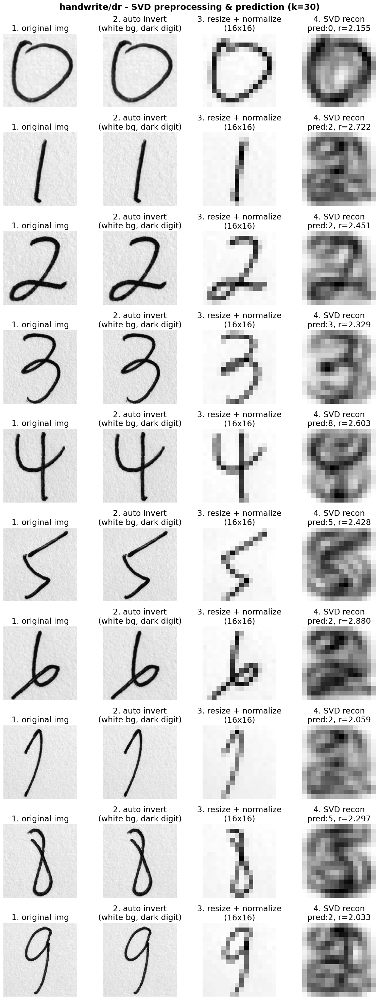

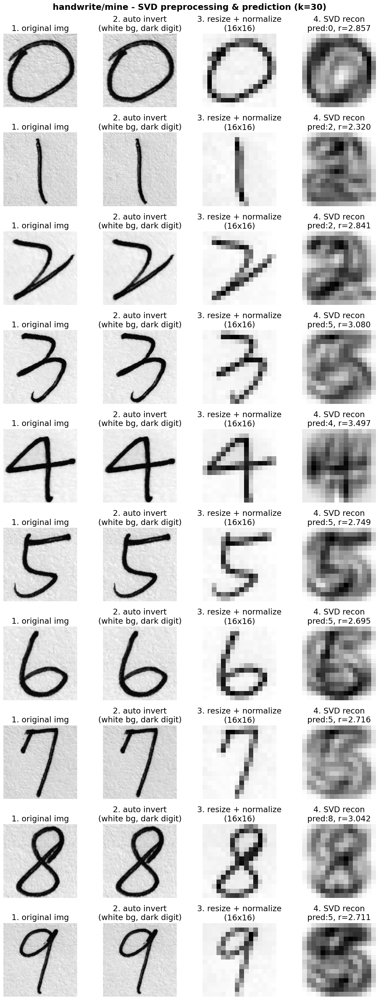

In [55]:
# 用 k=30 建好的 SVD 子空間
subspaces_best = build_svd_subspaces_per_digit(X_train_imgs, y_train, k=30)

visualize_preprocessing_svd('handwrite/dr',   subspaces_best, n_samples=10, img_size=(16, 16))
visualize_preprocessing_svd('handwrite/mine', subspaces_best, n_samples=10, img_size=(16, 16))


2.手寫字_無框ROI+字體加粗

In [56]:
def svd_predict_handwrite_folder_2(folder_path, subspaces, img_size=(16, 16)):

    # 使用字變粗的前處理
    X_flat, names = load_handwrite_enhanced(folder_path, img_size=img_size)  # (N, 256)

    # 轉回 (N, H, W) 給 SVD 分類器使用
    H, W = img_size
    X_imgs = X_flat.reshape(-1, H, W)   # (N, H, W)

    # 用 SVD 子空間公式做分類
    y_pred, residuals = classify_with_svd_subspaces_formula(subspaces, X_imgs)

    return names, y_pred, residuals


In [57]:
print("\n" + "="*70)
print("使用 SVD 子空間分類器，對字邊粗的手寫資料重新預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_new, dr_residuals_new = svd_predict_handwrite_folder_2(
    'handwrite/dr',
    subspaces_best,          # 前面建好的 k=30 子空間
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (SVD) ===")
for name, pred, res in zip(dr_names, dr_preds_new, dr_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_new, mine_residuals_new = svd_predict_handwrite_folder_2(
    'handwrite/mine',
    subspaces_best,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (SVD) ===")
for name, pred, res in zip(mine_names, mine_preds_new, mine_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")



使用 SVD 子空間分類器，對字邊粗的手寫資料重新預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 10/10 張 test

=== handwrite/dr 預測結果 (SVD) ===
檔名:  0.jpg -> 預測數字: 0 (最小 residual: 2.7237)
檔名:  1.jpg -> 預測數字: 1 (最小 residual: 1.0643)
檔名:  2.jpg -> 預測數字: 2 (最小 residual: 2.6274)
檔名:  3.jpg -> 預測數字: 3 (最小 residual: 2.1228)
檔名:  4.jpg -> 預測數字: 4 (最小 residual: 1.7671)
檔名:  5.jpg -> 預測數字: 5 (最小 residual: 2.7406)
檔名:  6.jpg -> 預測數字: 6 (最小 residual: 2.3962)
檔名:  7.jpg -> 預測數字: 9 (最小 residual: 1.5873)
檔名:  8.jpg -> 預測數字: 8 (最小 residual: 2.0865)
檔名:  9.jpg -> 預測數字: 9 (最小 residual: 1.4430)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成

In [58]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)
print(f"dr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 9 / 10
mine 正確 10 / 10


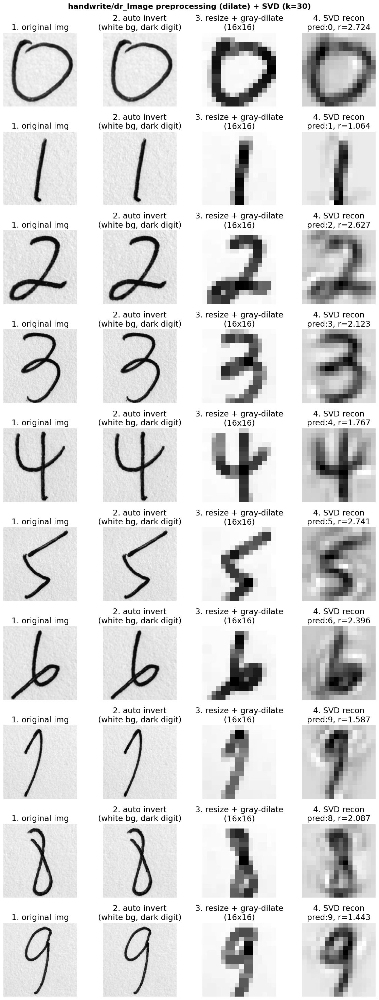

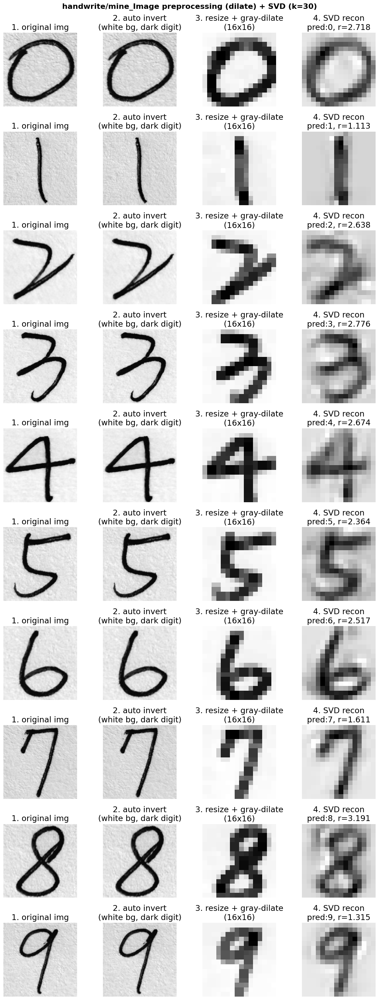

In [59]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_preprocessing__2_svd(folder_path, subspaces, n_samples=10, img_size=(16, 16)):

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    fig, axes = plt.subplots(n_samples, 4, figsize=(12, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    # 取一個 digit 看看 k 值
    some_digit = sorted(subspaces.keys())[0]
    k_vis = subspaces[some_digit]['Uk'].shape[1]

    fig.suptitle(
        f'{folder_path}_Image preprocessing (dilate) + SVD (k={k_vis})',
        fontsize=16, fontweight='bold'
    )

    H, W = img_size
    digits = sorted(subspaces.keys())

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉
        if np.mean(gray) < 128:
            inv = 255 - gray   # 原本偏暗，視為黑底白字 → 反轉
        else:
            inv = gray.copy()  # 原本就白底黑字，不動

        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2. auto invert\n(white bg, dark digit)')
        axes[idx, 1].axis('off')

        # 3. 縮放 + 加粗筆劃
        digit_small = cv2.resize(
            inv, img_size,
            interpolation=cv2.INTER_AREA
        )

        # 反轉 + 膨脹 + 再反轉（加粗深色筆劃）
        inv_small = 255 - digit_small
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick

        # 對比拉伸
        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        axes[idx, 2].imshow(digit_thick_gray, cmap='gray')
        axes[idx, 2].set_title(f'3. resize + gray-dilate\n({img_size[0]}x{img_size[1]})')
        axes[idx, 2].axis('off')

        # 丟進 SVD 分類器的輸入：先正規化到 [0,1] 再 flatten
        img_norm = digit_thick_gray.astype(np.float32) / 255.0
        x = img_norm.flatten()  # (D,)

        # 4. 用 SVD 子空間做預測 + 重建
        best_digit = None
        best_res   = None
        best_recon = None

        for d in digits:
            mean_c = subspaces[d]['mean']   # (D,)
            Uk     = subspaces[d]['Uk']     # (D, k)

            z = x - mean_c
            coeff = Uk.T @ z
            proj  = Uk @ coeff
            res_vec = z - proj
            residual = np.linalg.norm(res_vec, ord=2)

            if (best_res is None) or (residual < best_res):
                best_res   = residual
                best_digit = d
                best_recon = mean_c + proj   # (D,)

        if best_recon is not None:
            recon_img = best_recon.reshape(H, W)
            axes[idx, 3].imshow(recon_img, cmap='gray')
            axes[idx, 3].set_title(
                f'4. SVD recon\npred:{best_digit}, r={best_res:.3f}'
            )
            axes[idx, 3].axis('off')

    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()

visualize_preprocessing__2_svd('handwrite/dr',   subspaces_best, n_samples=10, img_size=(16, 16))
visualize_preprocessing__2_svd('handwrite/mine', subspaces_best, n_samples=10, img_size=(16, 16))


3.手寫字_ROI+字體加粗

In [60]:
def svd_predict_handwrite_folder_3(folder_path, subspaces, img_size=(16, 16)):

    # 使用字變粗+ROI的前處理
    X_flat, names = load_handwrite_enhanced_ROI(folder_path, img_size=img_size)  # (N, 256)

    # 轉回 (N, H, W) 給 SVD 分類器使用
    H, W = img_size
    X_imgs = X_flat.reshape(-1, H, W)   # (N, H, W)

    # 用 SVD 子空間公式做分類
    y_pred, residuals = classify_with_svd_subspaces_formula(subspaces, X_imgs)

    return names, y_pred, residuals


In [61]:
print("\n" + "="*70)
print("使用 SVD 子空間分類器，對ROI+字變粗的手寫資料重新預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_new, dr_residuals_new = svd_predict_handwrite_folder_3(
    'handwrite/dr',
    subspaces_best,          # 前面建好的 k=30 子空間
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (SVD) ===")
for name, pred, res in zip(dr_names, dr_preds_new, dr_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_new, mine_residuals_new = svd_predict_handwrite_folder_3(
    'handwrite/mine',
    subspaces_best,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (SVD) ===")
for name, pred, res in zip(mine_names, mine_preds_new, mine_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")



使用 SVD 子空間分類器，對ROI+字變粗的手寫資料重新預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
  已完成 10/10 張 test

=== handwrite/dr 預測結果 (SVD) ===
檔名:  0.jpg -> 預測數字: 0 (最小 residual: 3.5123)
檔名:  1.jpg -> 預測數字: 2 (最小 residual: 5.5110)
檔名:  2.jpg -> 預測數字: 2 (最小 residual: 4.2584)
檔名:  3.jpg -> 預測數字: 3 (最小 residual: 3.8777)
檔名:  4.jpg -> 預測數字: 4 (最小 residual: 3.3123)
檔名:  5.jpg -> 預測數字: 5 (最小 residual: 3.6434)
檔名:  6.jpg -> 預測數字: 6 (最小 residual: 4.0668)
檔名:  7.jpg -> 預測數字: 7 (最小 residual: 3.9323)
檔名:  8.jpg -> 預測數字: 3 (最小 residual: 4.5559)
檔名:  9.jpg -> 預測數字: 9 (最小 residual: 3.2045)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


開始使用公式 ||(I - Uk Uk^T)(x - μ_c)||_2 對 testing 影像做分類 ...
 

In [62]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)
print(f"dr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 8 / 10
mine 正確 8 / 10


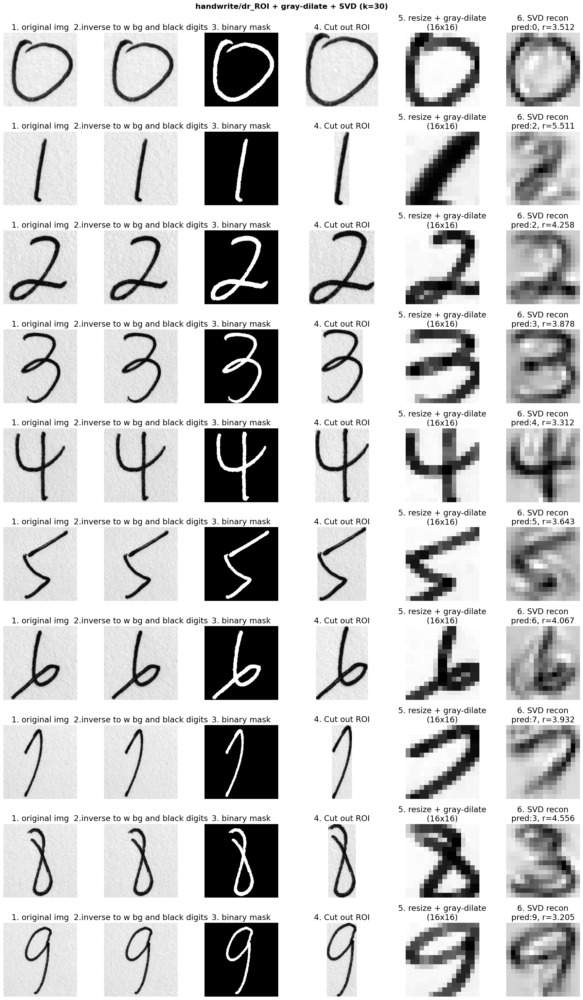

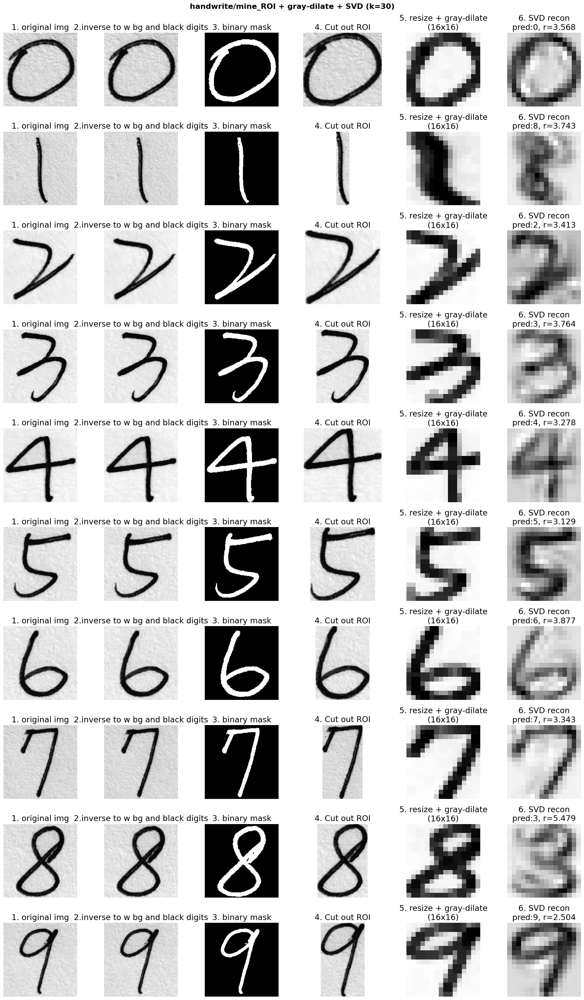

In [63]:
def visualize_preprocessing__3_svd(folder_path, subspaces, n_samples=10, img_size=(16, 16)):

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    fig, axes = plt.subplots(n_samples, 6, figsize=(18, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    some_digit = sorted(subspaces.keys())[0]
    k_vis = subspaces[some_digit]['Uk'].shape[1]

    fig.suptitle(
        f'{folder_path}_ROI + gray-dilate + SVD (k={k_vis})',
        fontsize=16, fontweight='bold'
    )

    H, W = img_size
    digits = sorted(subspaces.keys())

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉 → 確保白底黑字
        if np.mean(gray) < 128:
            inv = 255 - gray
        else:
            inv = gray.copy()
        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2.inverse to w bg and black digits')
        axes[idx, 1].axis('off')

        # 3. 二值化 mask (深色數字 → 白色前景)
        _, mask = cv2.threshold(
            inv, 0, 255,
            cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
        )
        axes[idx, 2].imshow(mask, cmap='gray')
        axes[idx, 2].set_title('3. binary mask')
        axes[idx, 2].axis('off')

        # 如果整張都沒有前景，就跳過
        if np.count_nonzero(mask) == 0:
            continue

        # 4. 根據 mask 裁出 ROI（灰階）
        ys, xs = np.where(mask > 0)
        x_min, x_max = xs.min(), xs.max()
        y_min, y_max = ys.min(), ys.max()
        roi = inv[y_min:y_max+1, x_min:x_max+1]
        axes[idx, 3].imshow(roi, cmap='gray')
        axes[idx, 3].set_title('4. Cut out ROI')
        axes[idx, 3].axis('off')

        # 5. ROI → resize → 在灰階上反轉 + 膨脹 + 再反轉
        digit_small = cv2.resize(
            roi, img_size,
            interpolation=cv2.INTER_AREA
        )

        inv_small = 255 - digit_small
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick

        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        axes[idx, 4].imshow(digit_thick_gray, cmap='gray')
        axes[idx, 4].set_title(f'5. resize + gray-dilate\n({img_size[0]}x{img_size[1]})')
        axes[idx, 4].axis('off')

        # 這裡一樣：這張 16x16 灰階 → normalize 到 [0,1] → flatten 給 SVD
        img_norm = digit_thick_gray.astype(np.float32) / 255.0
        x = img_norm.flatten()  # (D,)

        # 6. SVD 子空間預測 + 重建（取最後一欄）
        best_digit = None
        best_res   = None
        best_recon = None

        for d in digits:
            mean_c = subspaces[d]['mean']   # (D,)
            Uk     = subspaces[d]['Uk']     # (D, k)

            z = x - mean_c
            coeff = Uk.T @ z
            proj  = Uk @ coeff
            res_vec = z - proj
            residual = np.linalg.norm(res_vec, ord=2)

            if (best_res is None) or (residual < best_res):
                best_res   = residual
                best_digit = d
                best_recon = mean_c + proj

        if best_recon is not None:
            recon_img = best_recon.reshape(H, W)
            axes[idx, 5].imshow(recon_img, cmap='gray')
            axes[idx, 5].set_title(
                f'6. SVD recon\npred:{best_digit}, r={best_res:.3f}'
            )
            axes[idx, 5].axis('off')

    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()
visualize_preprocessing__3_svd('handwrite/dr',   subspaces_best, n_samples=10, img_size=(16, 16))
visualize_preprocessing__3_svd('handwrite/mine', subspaces_best, n_samples=10, img_size=(16, 16))


## 方法三 :HOSVD

In [64]:
# 從 usps_inverted/train 或 test 載入資料，回傳 (N,16,16)、(N,)
X_train_imgs, y_train = load_usps_split('usps_inverted/train', img_size=(16,16))
X_test_imgs,  y_test  = load_usps_split('usps_inverted/test',  img_size=(16,16))


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)


In [65]:
def unfold(tensor, mode):
    return np.reshape(np.moveaxis(tensor, mode, 0),
                      (tensor.shape[mode], -1))

def mode_n_product(tensor, matrix, mode):
    X = np.moveaxis(tensor, mode, 0)      # (I_mode, ...)
    shape_rest = X.shape[1:]
    X_2d = X.reshape(X.shape[0], -1)      # (I_mode, prod(rest))
    Y_2d = matrix @ X_2d                  # (J, prod(rest))
    Y = Y_2d.reshape((matrix.shape[0],) + shape_rest)
    return np.moveaxis(Y, 0, mode)

def hosvd_3d_truncated(A, r1=None, r2=None, r3=None):

    I1, I2, I3 = A.shape

    # mode-1
    A1 = unfold(A, 0)
    U1, _, _ = np.linalg.svd(A1, full_matrices=False)
    if r1 is not None:
        U1 = U1[:, :r1]

    # mode-2
    A2 = unfold(A, 1)
    U2, _, _ = np.linalg.svd(A2, full_matrices=False)
    if r2 is not None:
        U2 = U2[:, :r2]

    # mode-3
    A3 = unfold(A, 2)
    U3, _, _ = np.linalg.svd(A3, full_matrices=False)
    if r3 is not None:
        U3 = U3[:, :r3]

    # core
    S = mode_n_product(A, U1.T, 0)
    S = mode_n_product(S, U2.T, 1)
    S = mode_n_product(S, U3.T, 2)

    return U1, U2, U3, S


In [66]:
def build_hosvd_subspaces_per_digit_truncated(train_imgs, train_labels,r1=8, r2=8, r3=10):

    H, W = train_imgs.shape[1], train_imgs.shape[2]
    D = H * W
    hosvd_spaces = {}

    print("\n=== 建立每個 digit 的 HOSVD 子空間 (truncated) ===")

    for d in range(10):
        idx = np.where(train_labels == d)[0]
        if len(idx) == 0:
            print(f"digit {d}: 沒訓練資料，略過")
            continue

        A_digit = np.stack(train_imgs[idx], axis=2)   # (H, W, n_c)
        print(f"\nDigit {d}: n_c = {A_digit.shape[2]}")

        # 截斷 rank 的 HOSVD
        U1, U2, U3, S = hosvd_3d_truncated(A_digit, r1=r1, r2=r2, r3=r3)

        r1_eff, r2_eff, r3_eff = S.shape
        print(f"  real core shape S: {S.shape} (r1={r1_eff}, r2={r2_eff}, r3={r3_eff})")

        basis_list = []
        norm2_list = []

        for j in range(r3_eff):
            core_j = S[:, :, j]        # (r1_eff, r2_eff)
            Aj = U1 @ core_j @ U2.T    # (H, W)
            Aj_flat = Aj.reshape(-1)   # (D,)

            norm2 = np.sum(Aj_flat ** 2) + 1e-12  # = <Aj,Aj> = ||Aj||_F^2

            basis_list.append(Aj_flat)
            norm2_list.append(norm2)

        basis = np.stack(basis_list, axis=0)       # (r3_eff, D)
        norm2 = np.array(norm2_list)               # (r3_eff,)

        hosvd_spaces[d] = {
            'basis': basis,
            'norm2': norm2
        }

        print(f"  digit {d}: 建立 {basis.shape[0]} 個 basis")

    return hosvd_spaces

In [67]:
def build_hosvd_subspaces_per_digit_truncated(train_imgs, train_labels,r1=8, r2=8, r3=10):

    H, W = train_imgs.shape[1], train_imgs.shape[2]
    D = H * W
    hosvd_spaces = {}

    print("\n=== 建立每個 digit 的 HOSVD 子空間 (truncated) ===")

    for d in range(10):
        idx = np.where(train_labels == d)[0]
        if len(idx) == 0:
            print(f"digit {d}: 沒訓練資料，略過")
            continue

        # 把該 digit 的影像堆成 3D 張量 (H, W, n_c)
        A_digit = np.stack(train_imgs[idx], axis=2)
        print(f"\nDigit {d}: n_c = {A_digit.shape[2]}")

        # 截斷 rank 的 HOSVD
        U1, U2, U3, S = hosvd_3d_truncated(A_digit, r1=r1, r2=r2, r3=r3)

        r1_eff, r2_eff, r3_eff = S.shape
        print(f"  實際 core 形狀 S: {S.shape} (r1={r1_eff}, r2={r2_eff}, r3={r3_eff})")

        basis_list = []
        norm2_list = []

        for j in range(r3_eff):
            core_j = S[:, :, j]        # (r1_eff, r2_eff)

            # Aj = U^{(1)} * S(:,:,j) * U^{(2)T}，大小 (H, W)
            Aj = U1 @ core_j @ U2.T
            Aj_flat = Aj.reshape(-1).astype(np.float64)   # (D,)

            # <Aj,Aj> = ||Aj||_F^2
            norm2 = np.sum(Aj_flat ** 2) + 1e-12

            basis_list.append(Aj_flat)
            norm2_list.append(norm2)

        basis = np.stack(basis_list, axis=0)     # (r3_eff, D)
        norm2 = np.array(norm2_list)             # (r3_eff,)

        hosvd_spaces[d] = {
            'basis': basis,
            'norm2': norm2
        }

        print(f"  digit {d}: 建立 {basis.shape[0]} 個 basis")

    return hosvd_spaces


In [68]:
def predict_with_hosvd_subspaces(hosvd_spaces, test_imgs):

    H, W = test_imgs.shape[1], test_imgs.shape[2]
    D = H * W

    X_test_flat = test_imgs.reshape(test_imgs.shape[0], D).astype(np.float64)
    N_test = X_test_flat.shape[0]

    y_pred = []
    G_all = np.full((N_test, 10), np.inf, dtype=np.float64)

    print("\n=== 使用 HOSVD 子空間進行分類（內積 + 重建誤差） ===")

    for i, z_flat in enumerate(X_test_flat):

        best_digit = None
        best_G = None

        for d in range(10):
            if d not in hosvd_spaces:
                continue

            basis = hosvd_spaces[d]['basis']   # (J, D)，第 j 列是 Aj_flat
            norm2 = hosvd_spaces[d]['norm2']   # (J,)，norm2[j] = <Aj,Aj>

            # inner[j] = <Z, A_j>
            inner = basis @ z_flat             # (J,)

            # z_j = <Z,A_j> / <A_j,A_j>
            coef  = inner / norm2              # (J,)

            # Σ_j z_j A_j
            recon_flat = (coef[:, None] * basis).sum(axis=0)  # (D,)

            # G = ||Z - Σ_j z_j A_j||_F
            diff = z_flat - recon_flat
            G = np.linalg.norm(diff)           # 向量 2-norm = Frobenius norm

            G_all[i, d] = G

            if (best_G is None) or (G < best_G):
                best_G = G
                best_digit = d

        y_pred.append(best_digit)

        if (i + 1) % 200 == 0 or (i + 1) == N_test:
            print(f"  已完成 {i+1}/{N_test}")

    return np.array(y_pred), G_all


In [69]:
import numpy as np
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

def main_hosvd_truncated():
    IMG_SIZE = (16, 16)

    X_train_imgs, y_train = load_usps_split('usps_inverted/train', img_size=IMG_SIZE)
    X_test_imgs,  y_test  = load_usps_split('usps_inverted/test',  img_size=IMG_SIZE)

    # 可以調整 r1, r2, r3
    hosvd_spaces = build_hosvd_subspaces_per_digit_truncated(
        X_train_imgs, y_train,
        r1=12, r2=12, r3=15
    )

    y_pred, G_all = predict_with_hosvd_subspaces(hosvd_spaces, X_test_imgs)

    acc = accuracy_score(y_test, y_pred)
    print("\n=== HOSVD 手寫數字辨識結果（truncated） ===")
    print("Accuracy:", acc)

    print("\n分類報告：")
    print(classification_report(y_test, y_pred))

    cm = confusion_matrix(y_test, y_pred)
    print("Confusion Matrix：")
    print(cm)

    return y_test, y_pred, cm


y_test, y_pred, cm = main_hosvd_truncated()

正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)

=== 建立每個 digit 的 HOSVD 子空間 (truncated) ===

Digit 0: n_c = 1194
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 0: 建立 15 個 basis

Digit 1: n_c = 1005
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 1: 建立 15 個 basis

Digit 2: n_c = 731
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 2: 建立 15 個 basis

Digit 3: n_c = 658
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 3: 建立 15 個 basis

Digit 4: n_c = 652
  實際 cor

In [70]:
import itertools
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # 只是啟用 3D 投影

from sklearn.metrics import accuracy_score

# 想要掃的 rank 組合
r1_list = [4, 8, 12]
r2_list = [4, 8, 12]
r3_list = [5, 10, 15]

results = []

for r1 in r1_list:
    for r2 in r2_list:
        for r3 in r3_list:
            print("\n" + "="*60)
            print(f"現在測試 HOSVD rank: r1={r1}, r2={r2}, r3={r3}")
            print("="*60)

            hosvd_spaces = build_hosvd_subspaces_per_digit_truncated(
                X_train_imgs, y_train,
                r1=r1, r2=r2, r3=r3
            )

            y_pred, _ = predict_with_hosvd_subspaces(hosvd_spaces, X_test_imgs)
            acc = accuracy_score(y_test, y_pred)

            print(f"Accuracy = {acc:.4f}")

            results.append({
                'r1': r1,
                'r2': r2,
                'r3': r3,
                'accuracy': acc
            })

df = pd.DataFrame(results)
print("\n=== 各種 (r1,r2,r3) 的 accuracy ===")
print(df.sort_values('accuracy', ascending=False).reset_index(drop=True))



現在測試 HOSVD rank: r1=4, r2=4, r3=5

=== 建立每個 digit 的 HOSVD 子空間 (truncated) ===

Digit 0: n_c = 1194
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 0: 建立 5 個 basis

Digit 1: n_c = 1005
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 1: 建立 5 個 basis

Digit 2: n_c = 731
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 2: 建立 5 個 basis

Digit 3: n_c = 658
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 3: 建立 5 個 basis

Digit 4: n_c = 652
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 4: 建立 5 個 basis

Digit 5: n_c = 556
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 5: 建立 5 個 basis

Digit 6: n_c = 664
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 6: 建立 5 個 basis

Digit 7: n_c = 645
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 7: 建立 5 個 basis

Digit 8: n_c = 542
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 8: 建立 5 個 basis

Digit 9: n_c = 644
  實際 core 形狀 S: (4, 4, 5) (r1=4, r2=4, r3=5)
  digit 9: 建立 5 個 basis

=== 使用 HOSVD 子空間進行分類（內積 + 重建

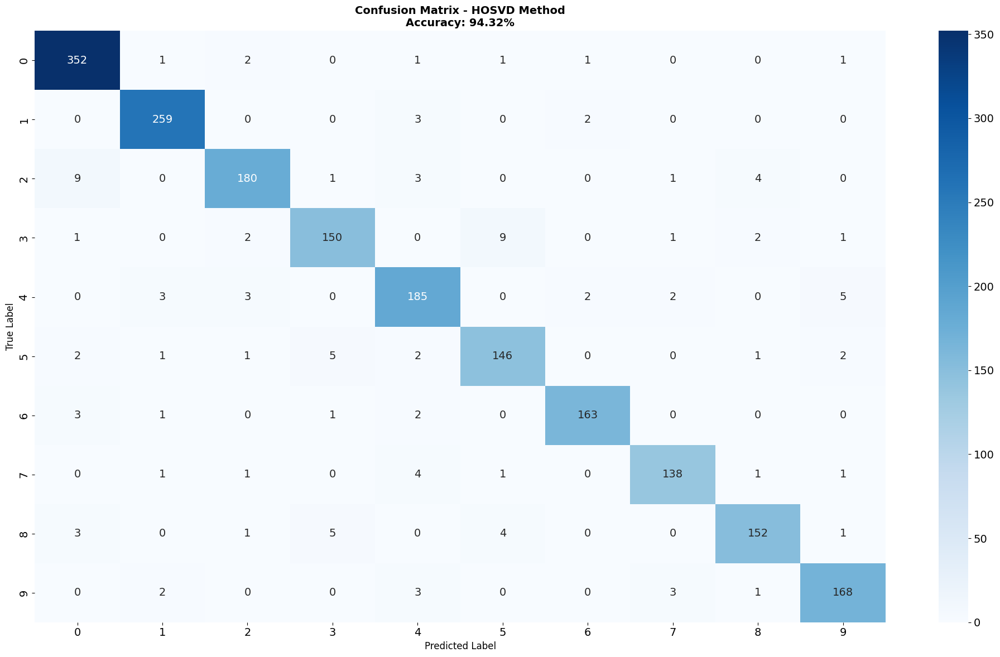

In [71]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def visualize_confusion_matrix_results(cm, accuracy, method_name='HOSVD'):
    plt.figure(figsize=(20, 12))
    sns.heatmap(cm,
                annot=True,
                fmt='d',
                cmap='Blues',
                xticklabels=range(10),
                yticklabels=range(10))

    plt.title(f'Confusion Matrix - {method_name} Method\nAccuracy: {accuracy*100:.2f}%',
              fontsize=14, fontweight='bold')
    plt.xlabel('Predicted Label', fontsize=12)
    plt.ylabel('True Label', fontsize=12)

    plt.tight_layout()
    plt.savefig(f'ConfusionMatrix_{method_name}.png', dpi=150, bbox_inches="tight")
    plt.show()

visualize_confusion_matrix_results(cm, acc, method_name='HOSVD')


In [72]:
import numpy as np
import matplotlib.pyplot as plt
import math
from sklearn.metrics import accuracy_score

IMG_SIZE = (16, 16)
H, W = IMG_SIZE

# 1. 載入 USPS train / test
X_train_imgs, y_train = load_usps_split('usps_inverted/train', img_size=IMG_SIZE)
X_test_imgs,  y_test  = load_usps_split('usps_inverted/test',  img_size=IMG_SIZE)

# 2. 使用最佳參數建立 HOSVD 子空間
best_r1, best_r2, best_r3 = 12, 12, 15

hosvd_best = build_hosvd_subspaces_per_digit_truncated(
    X_train_imgs, y_train,
    r1=best_r1, r2=best_r2, r3=best_r3
)

# 3. 用最佳參數做一次預測，之後視覺化都用這組
y_pred_best, G_all_best = predict_with_hosvd_subspaces(hosvd_best, X_test_imgs)

acc_best = accuracy_score(y_test, y_pred_best)
print(f"\nBest HOSVD (r1={best_r1}, r2={best_r2}, r3={best_r3}) accuracy = {acc_best:.4f}")


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)

=== 建立每個 digit 的 HOSVD 子空間 (truncated) ===

Digit 0: n_c = 1194
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 0: 建立 15 個 basis

Digit 1: n_c = 1005
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 1: 建立 15 個 basis

Digit 2: n_c = 731
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 2: 建立 15 個 basis

Digit 3: n_c = 658
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 3: 建立 15 個 basis

Digit 4: n_c = 652
  實際 cor

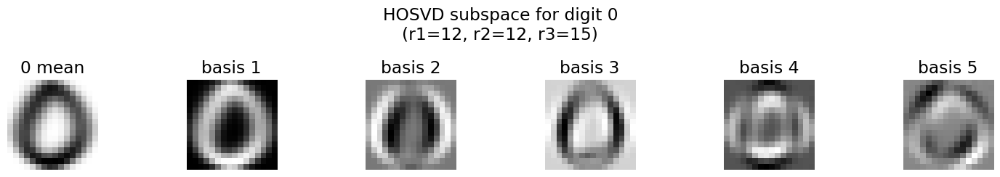

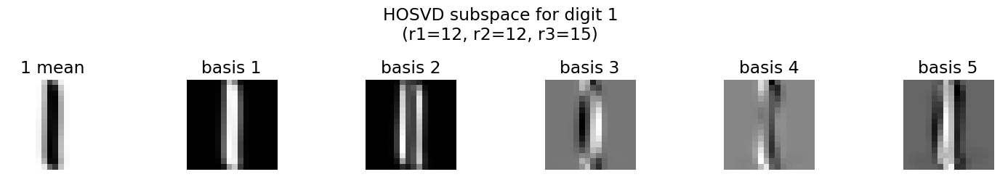

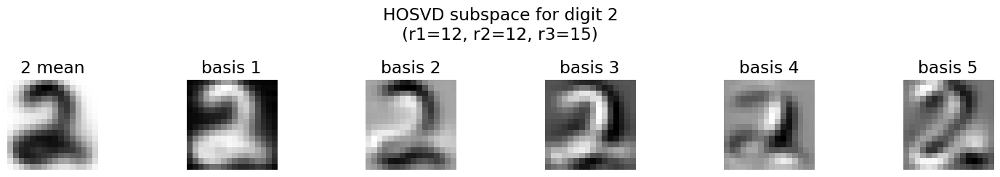

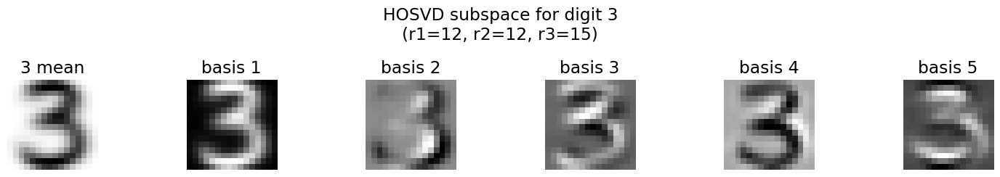

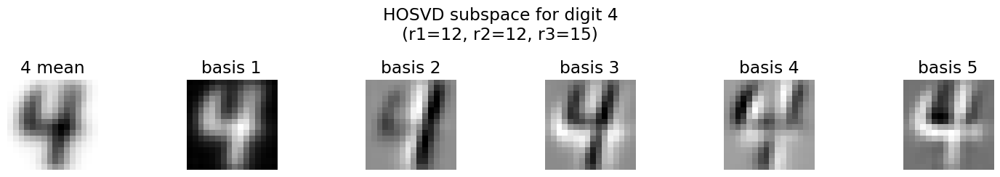

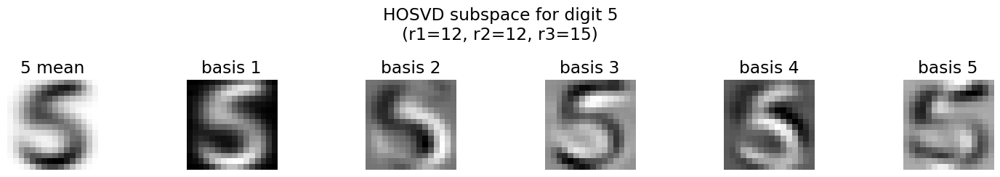

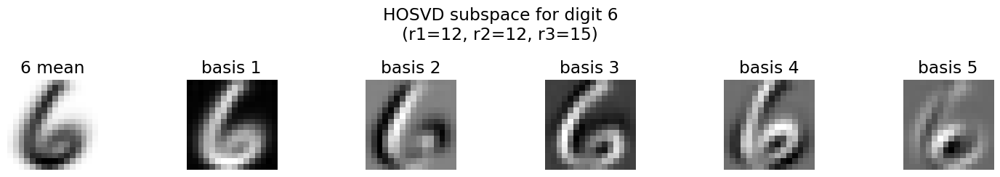

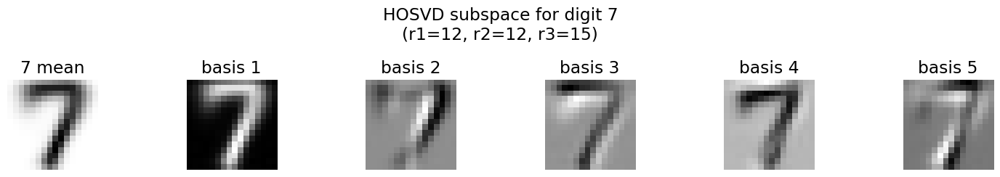

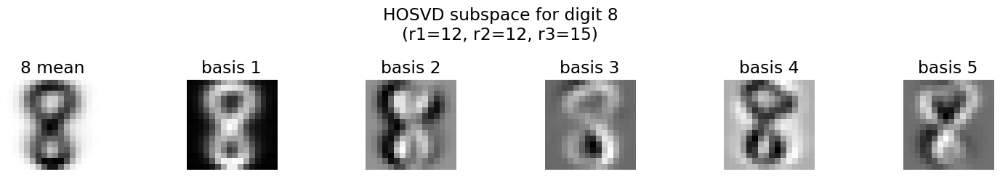

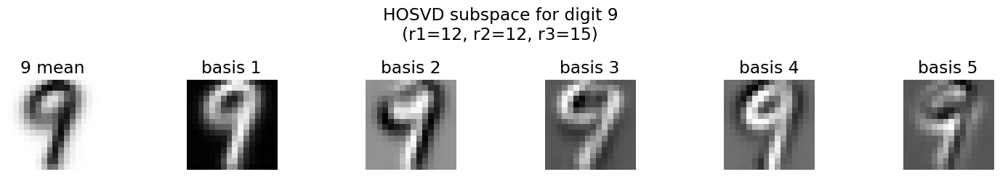

In [73]:
# ============ 1. 0–9 各自 subspace 的樣子 ============

n_show = 5  # 每個 digit 想顯示幾個 basis

for d in range(10):
    if d not in hosvd_best:
        print(f"digit {d} 沒有 HOSVD 子空間，略過")
        continue

    # 平均影像（從 train 算）
    idx = np.where(y_train == d)[0]
    mean_img = X_train_imgs[idx].mean(axis=0)   # (16,16)

    basis = hosvd_best[d]['basis']    # (J, D) = (r3_eff, 256)
    J = basis.shape[0]
    n_use = min(n_show, J)

    fig, axes = plt.subplots(1, n_use + 1,
                             figsize=(2.5 * (n_use + 1), 2.5))

    # [0] 平均影像
    axes[0].imshow(mean_img, cmap='gray')
    axes[0].set_title(f'{d} mean')
    axes[0].axis('off')

    # 之後幾張：前幾個 HOSVD basis
    for j in range(n_use):
        basis_img = basis[j].reshape(H, W)
        axes[j + 1].imshow(basis_img, cmap='gray')
        axes[j + 1].set_title(f'basis {j+1}')
        axes[j + 1].axis('off')

    plt.suptitle(f'HOSVD subspace for digit {d}\n(r1={best_r1}, r2={best_r2}, r3={best_r3})')
    plt.tight_layout()
    plt.show()


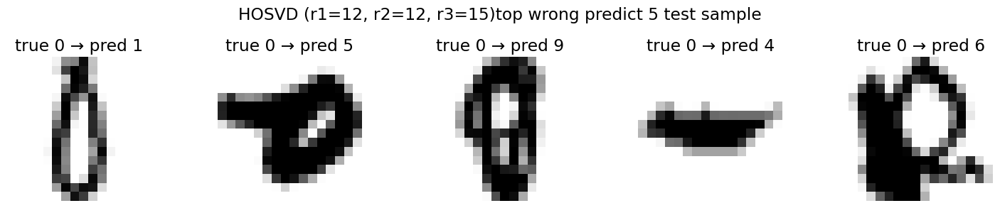

In [74]:
# ============ 預測錯誤的前5個測試影像 ============

mis_idx = np.where(y_pred_best != y_test)[0]

if len(mis_idx) == 0:
    print("No wrong")
else:
    top_idx = mis_idx[:5]
    n = len(top_idx)

    cols = 5
    rows = math.ceil(n / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(3 * cols, 3 * rows))
    axes = np.array(axes).reshape(-1)

    for ax_i, idx in enumerate(top_idx):
        axes[ax_i].imshow(X_test_imgs[idx], cmap='gray')
        axes[ax_i].set_title(f"true {y_test[idx]} → pred {y_pred_best[idx]}")
        axes[ax_i].axis('off')

    for j in range(n, rows * cols):
        axes[j].axis('off')

    plt.suptitle(f"HOSVD (r1={best_r1}, r2={best_r2}, r3={best_r3})top wrong predict {n} test sample")
    plt.tight_layout()
    plt.show()


In [75]:
def residual_norm_hosvd(z_flat, basis, norm2):

    # <Z, A_j>
    inner = basis @ z_flat          # (J,)

    # z_j
    coef = inner / norm2            # (J,)

    # Σ_j z_j A_j
    recon_flat = (coef[:, None] * basis).sum(axis=0)  # (D,)

    diff = z_flat - recon_flat
    G = np.linalg.norm(diff)
    return G


In [76]:
def visualize_residual_confusion_hosvd(digit, test_imgs, y_test, hosvd_spaces):

    N_test = test_imgs.shape[0]
    H, W   = test_imgs.shape[1], test_imgs.shape[2]
    D      = H * W

    # flatten 測試影像
    X_test_flat = test_imgs.reshape(N_test, D).astype(np.float64)

    # 找出所有真實標籤是 digit 的樣本 index
    digit_indices = np.where(y_test == digit)[0]
    print(f"\n[HOSVD] 分析數字 {digit} 的 residual 分佈 (共 {len(digit_indices)} 個樣本)")

    digits = sorted(hosvd_spaces.keys())  # 通常是 0~9

    # 收集每一個樣本的 residual 曲線
    all_residuals = []

    for idx in digit_indices:
        z_flat = X_test_flat[idx]
        residuals_to_all = []

        for d in digits:
            basis_d = hosvd_spaces[d]['basis']  # (J, D)
            norm2_d = hosvd_spaces[d]['norm2']  # (J,)

            r = residual_norm_hosvd(z_flat, basis_d, norm2_d)
            residuals_to_all.append(r)

        all_residuals.append(residuals_to_all)

    all_residuals = np.array(all_residuals)   # (N_samples_digit, 10)

    # --- 畫圖 ---
    plt.figure(figsize=(12, 6))

    # 每個樣本一條藍線
    for r in all_residuals:
        plt.plot(digits, r, alpha=0.2, color='blue')

    # 平均 residual（紅線）
    avg_residuals = all_residuals.mean(axis=0)
    plt.plot(digits, avg_residuals, 'r-', linewidth=3, label='mean residual')

    plt.xlabel('Digit subspace', fontsize=12)
    plt.ylabel(r'HOSVD residual norm $ \| Z - \sum_j z_j A_j \|_2 $', fontsize=12)
    plt.title(f'HOSVD residual of true digit {digit} to all digit subspaces',
              fontsize=14, fontweight='bold')
    plt.xticks(digits)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.show()

    # --- 找最容易混淆 / 最不像的類別（依平均 residual）---
    avg_for_arg = avg_residuals.copy()

    # 把自己那類先設成 inf，只考慮其他類
    self_idx = digits.index(digit)
    avg_for_arg[self_idx] = np.inf

    confused_idx = np.argmin(avg_for_arg)
    worst_idx    = np.argmax(avg_for_arg)

    confused_with = digits[confused_idx]
    worst_with    = digits[worst_idx]

    print(f"數字 {digit} 最容易被混淆為: {confused_with} (平均 residual = {avg_residuals[confused_idx]:.4f})")
    print(f"數字 {digit} 最不像的是: {worst_with} (平均 residual = {avg_residuals[worst_idx]:.4f})")


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)

=== 建立每個 digit 的 HOSVD 子空間 (truncated) ===

Digit 0: n_c = 1194
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 0: 建立 15 個 basis

Digit 1: n_c = 1005
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 1: 建立 15 個 basis

Digit 2: n_c = 731
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 2: 建立 15 個 basis

Digit 3: n_c = 658
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 3: 建立 15 個 basis

Digit 4: n_c = 652
  實際 cor

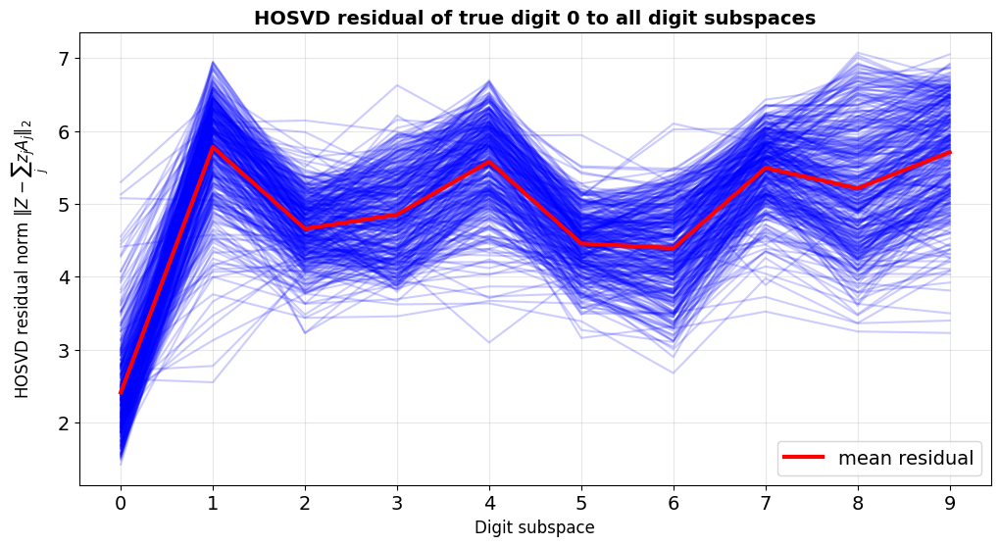

數字 0 最容易被混淆為: 6 (平均 residual = 4.3935)
數字 0 最不像的是: 0 (平均 residual = 2.4147)

[HOSVD] 分析數字 1 的 residual 分佈 (共 264 個樣本)


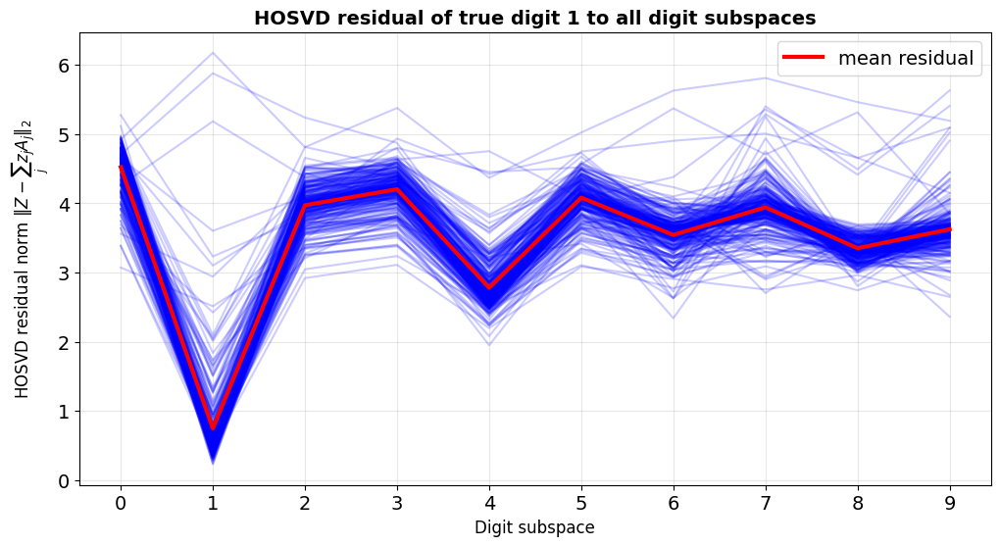

數字 1 最容易被混淆為: 4 (平均 residual = 2.7805)
數字 1 最不像的是: 1 (平均 residual = 0.7493)

[HOSVD] 分析數字 5 的 residual 分佈 (共 160 個樣本)


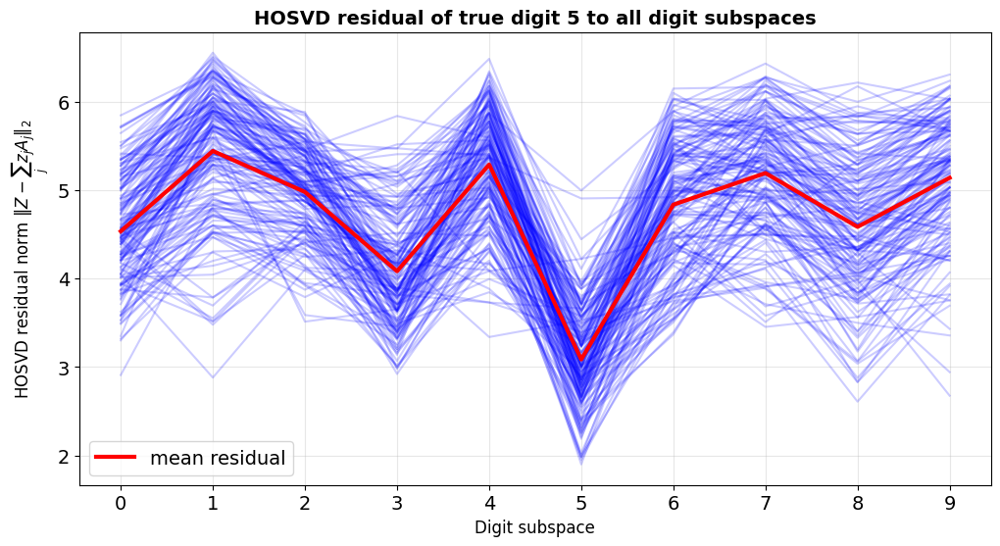

數字 5 最容易被混淆為: 3 (平均 residual = 4.0848)
數字 5 最不像的是: 5 (平均 residual = 3.0872)

[HOSVD] 分析數字 7 的 residual 分佈 (共 147 個樣本)


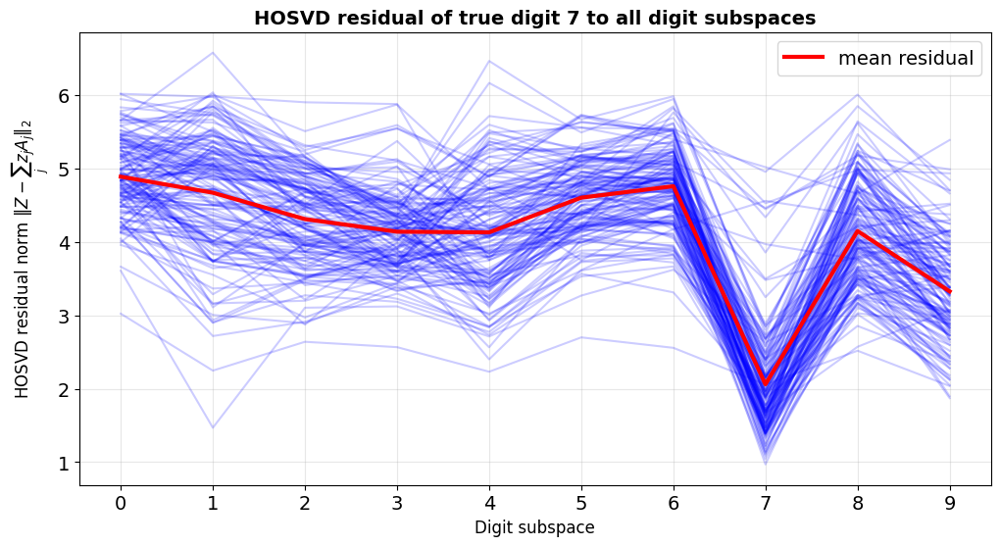

數字 7 最容易被混淆為: 9 (平均 residual = 3.3268)
數字 7 最不像的是: 7 (平均 residual = 2.0608)


In [77]:
IMG_SIZE = (16, 16)

# 讀資料
X_train_imgs, y_train = load_usps_split('usps_inverted/train', img_size=IMG_SIZE)
X_test_imgs,  y_test  = load_usps_split('usps_inverted/test',  img_size=IMG_SIZE)

# 建立「最佳」 HOSVD 子空間 (r1=12, r2=12, r3=15)
hosvd_spaces_best = build_hosvd_subspaces_per_digit_truncated(
    X_train_imgs, y_train,
    r1=12, r2=12, r3=15
)

# 想確認一下這組 rank 的 accuracy 也可以順便算
y_pred_best, G_all_best = predict_with_hosvd_subspaces(hosvd_spaces_best, X_test_imgs)
acc_best = accuracy_score(y_test, y_pred_best)
print("Best HOSVD (12,12,15) accuracy:", acc_best)

# 畫幾個代表性的數字的 residual 圖
visualize_residual_confusion_hosvd(0, X_test_imgs, y_test, hosvd_spaces_best)
visualize_residual_confusion_hosvd(1, X_test_imgs, y_test, hosvd_spaces_best)
visualize_residual_confusion_hosvd(5, X_test_imgs, y_test, hosvd_spaces_best)
visualize_residual_confusion_hosvd(7, X_test_imgs, y_test, hosvd_spaces_best)


##方法三:HOSVD_自己手寫預測

In [78]:
# ==========================================
# 建立 Best HOSVD 子空間 (r1=12, r2=12, r3=15)
# ==========================================

TRAIN_PATH = 'usps_inverted/train'
img_size   = (16, 16)

# 1. 載入訓練資料
X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=img_size)

# 2. 建立 HOSVD 子空間（Best: r1=12, r2=12, r3=15）
hosvd_best = build_hosvd_subspaces_per_digit_truncated(
    X_train_imgs, y_train,
    r1=12, r2=12, r3=15
)


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)

=== 建立每個 digit 的 HOSVD 子空間 (truncated) ===

Digit 0: n_c = 1194
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 0: 建立 15 個 basis

Digit 1: n_c = 1005
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 1: 建立 15 個 basis

Digit 2: n_c = 731
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 2: 建立 15 個 basis

Digit 3: n_c = 658
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 3: 建立 15 個 basis

Digit 4: n_c = 652
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 4: 建立 15 個 basis

Digit 5: n_c = 556
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 5: 建立 15 個 basis

Digit 6: n_c = 664
  實際 core 形狀 S: (12, 12, 15) (r1=12, r2=12, r3=15)
  digit 6: 建立 15 個 basis

Digit 7:

1.手寫字_原始版(無框ROI+無字體加粗)


In [79]:
def hosvd_predict_handwrite_folder(folder_path, hosvd_spaces, img_size=(16, 16)):

    # 使用原本的前處理
    X_flat, names = load_handwrite_original(folder_path, img_size=img_size)  # (N, 256)

    # 轉回 (N, H, W) 給 HOSVD 分類器使用
    H, W = img_size
    X_imgs = X_flat.reshape(-1, H, W)   # (N, H, W)

    # 用 HOSVD 子空間公式做分類
    y_pred, G_all = predict_with_hosvd_subspaces(hosvd_spaces, X_imgs)
    # 每張圖在 10 個 digit 子空間的 G 值，取最小的當作該圖的 residual 指標
    min_residual = G_all.min(axis=1)

    return names, y_pred, min_residual

In [80]:
# 對 handwrite/dr & handwrite/mine 做預測並統計

print("\n" + "="*70)
print("使用 HOSVD 子空間分類器，對手寫資料重新預測")
print("Best HOSVD (r1=12, r2=12, r3=15)")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_new, dr_residuals_new = hosvd_predict_handwrite_folder(
    'handwrite/dr',
    hosvd_best,          # 上面建好的 best HOSVD 子空間
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (HOSVD) ===")
for name, pred, res in zip(dr_names, dr_preds_new, dr_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_new, mine_residuals_new = hosvd_predict_handwrite_folder(
    'handwrite/mine',
    hosvd_best,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (HOSVD) ===")
for name, pred, res in zip(mine_names, mine_preds_new, mine_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")




使用 HOSVD 子空間分類器，對手寫資料重新預測
Best HOSVD (r1=12, r2=12, r3=15)

從 handwrite/dr 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== 使用 HOSVD 子空間進行分類（內積 + 重建誤差） ===
  已完成 10/10

=== handwrite/dr 預測結果 (HOSVD) ===
檔名:  0.jpg -> 預測數字: 0 (最小 residual: 1.9562)
檔名:  1.jpg -> 預測數字: 1 (最小 residual: 0.9621)
檔名:  2.jpg -> 預測數字: 2 (最小 residual: 1.8268)
檔名:  3.jpg -> 預測數字: 3 (最小 residual: 1.3671)
檔名:  4.jpg -> 預測數字: 4 (最小 residual: 1.5529)
檔名:  5.jpg -> 預測數字: 6 (最小 residual: 1.6190)
檔名:  6.jpg -> 預測數字: 6 (最小 residual: 1.4770)
檔名:  7.jpg -> 預測數字: 4 (最小 residual: 1.0801)
檔名:  8.jpg -> 預測數字: 1 (最小 residual: 1.3143)
檔名:  9.jpg -> 預測數字: 4 (最小 residual: 1.1575)

從 handwrite/mine 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== 使用 HOSVD 子空間進行分類（內積 + 重建誤差） ===
  已完成 10/10

=== ha

In [81]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 6 / 10
mine 正確 8 / 10


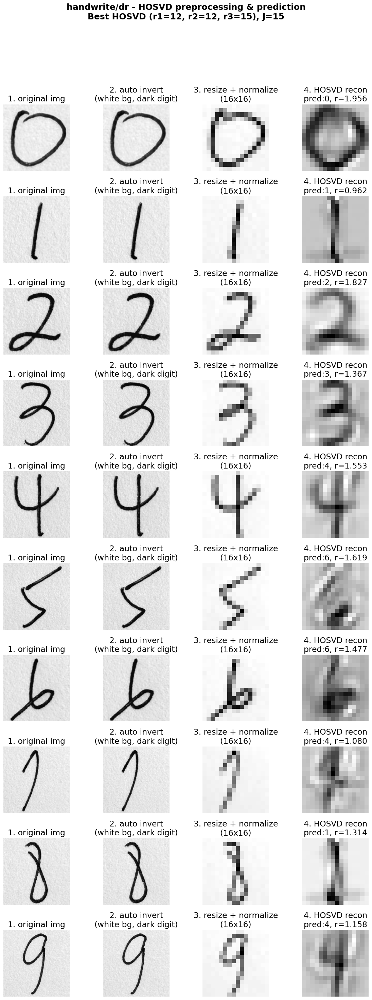

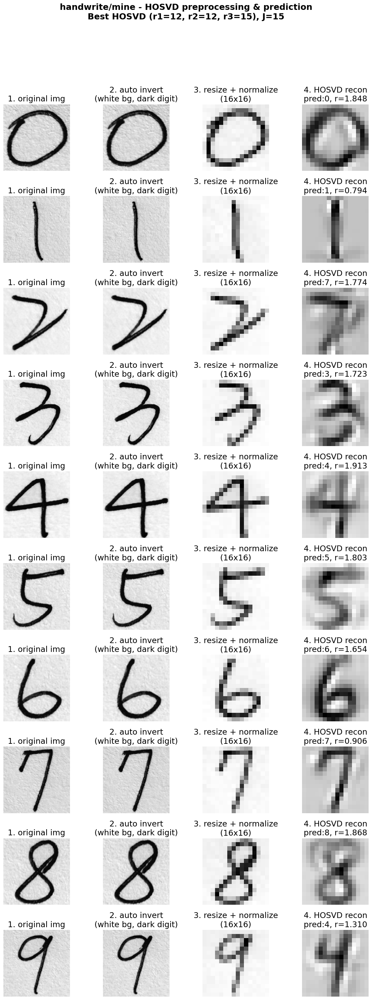

In [82]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_preprocessing_hosvd(folder_path, hosvd_spaces,n_samples=10, img_size=(16, 16),ranks=(12, 12, 15)):


    # 取得每個 digit 子空間的 basis 數量 J（= r3_eff）
    some_digit = sorted(hosvd_spaces.keys())[0]
    J_vis = hosvd_spaces[some_digit]['basis'].shape[0]

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    fig, axes = plt.subplots(n_samples, 4, figsize=(12, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    r1, r2, r3 = ranks
    fig.suptitle(
        f'{folder_path} - HOSVD preprocessing & prediction\n'
        f'Best HOSVD (r1={r1}, r2={r2}, r3={r3}), J={J_vis}',
        fontsize=18,
        fontweight='bold'
    )

    H, W = img_size
    digits = sorted(hosvd_spaces.keys())

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉
        if np.mean(gray) < 128:
            inv = 255 - gray   # 偏暗視為黑底白字 → 反轉
        else:
            inv = gray.copy()  # 已是白底黑字，不動

        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2. auto invert\n(white bg, dark digit)')
        axes[idx, 1].axis('off')

        # 3. 縮放到 img_size，並正規化到 [0,1]
        digit_small = cv2.resize(
            inv, img_size,
            interpolation=cv2.INTER_AREA
        )
        img_norm = digit_small.astype(np.float32) / 255.0
        x = img_norm.flatten().astype(np.float64)  # (D,)

        axes[idx, 2].imshow(img_norm, cmap='gray')
        axes[idx, 2].set_title(f'3. resize + normalize\n({img_size[0]}x{img_size[1]})')
        axes[idx, 2].axis('off')

        # 4. 用 HOSVD 子空間做預測 + 重建
        best_digit = None
        best_res   = None
        best_recon = None

        for d in digits:
            basis_d = hosvd_spaces[d]['basis']  # (J, D) Aj_flat
            norm2_d = hosvd_spaces[d]['norm2']  # (J,)   <Aj,Aj>

            # 內積 <x, A_j>
            inner = basis_d @ x                # (J,)
            # 係數 z_j
            coef  = inner / norm2_d            # (J,)
            # Σ_j z_j A_j
            recon_flat = (coef[:, None] * basis_d).sum(axis=0)  # (D,)

            residual = np.linalg.norm(x - recon_flat)

            if (best_res is None) or (residual < best_res):
                best_res   = residual
                best_digit = d
                best_recon = recon_flat

        if best_recon is not None:
            recon_img = best_recon.reshape(H, W)
            axes[idx, 3].imshow(recon_img, cmap='gray')
            axes[idx, 3].set_title(
                f'4. HOSVD recon\npred:{best_digit}, r={best_res:.3f}'
            )
            axes[idx, 3].axis('off')

    plt.tight_layout(rect=[0.0, 0, 1, 0.93])
    plt.show()

visualize_preprocessing_hosvd('handwrite/dr',
                              hosvd_best,
                              n_samples=10,
                              img_size=(16, 16),
                              ranks=(12, 12, 15))

visualize_preprocessing_hosvd('handwrite/mine',
                              hosvd_best,
                              n_samples=10,
                              img_size=(16, 16),
                              ranks=(12, 12, 15))

2.手寫字_無框ROI+字體加粗


In [83]:
def hosvd_predict_handwrite_folder_2(folder_path, hosvd_spaces, img_size=(16, 16)):

    # 使用字變粗前處理
    X_flat, names = load_handwrite_enhanced(folder_path, img_size=img_size)  # (N, 256)

    # 轉回 (N, H, W) 給 HOSVD 分類器使用
    H, W = img_size
    X_imgs = X_flat.reshape(-1, H, W)   # (N, H, W)

    # 用 HOSVD 子空間公式做分類
    y_pred, G_all = predict_with_hosvd_subspaces(hosvd_spaces, X_imgs)


    # 每張圖在 10 個 digit 子空間的 G 值，取最小的當作該圖的 residual 指標
    min_residual = G_all.min(axis=1)

    return names, y_pred, min_residual

In [84]:
# 對 handwrite/dr & handwrite/mine 做預測並統計

print("\n" + "="*70)
print("使用 HOSVD 子空間分類器，對手字變粗寫資料重新預測")
print("Best HOSVD (r1=12, r2=12, r3=15)")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_new, dr_residuals_new = hosvd_predict_handwrite_folder_2(
    'handwrite/dr',
    hosvd_best,          # 上面建好的 best HOSVD 子空間
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (HOSVD) ===")
for name, pred, res in zip(dr_names, dr_preds_new, dr_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_new, mine_residuals_new = hosvd_predict_handwrite_folder_2(
    'handwrite/mine',
    hosvd_best,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (HOSVD) ===")
for name, pred, res in zip(mine_names, mine_preds_new, mine_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")




使用 HOSVD 子空間分類器，對手字變粗寫資料重新預測
Best HOSVD (r1=12, r2=12, r3=15)

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== 使用 HOSVD 子空間進行分類（內積 + 重建誤差） ===
  已完成 10/10

=== handwrite/dr 預測結果 (HOSVD) ===
檔名:  0.jpg -> 預測數字: 0 (最小 residual: 3.4687)
檔名:  1.jpg -> 預測數字: 1 (最小 residual: 1.7680)
檔名:  2.jpg -> 預測數字: 2 (最小 residual: 3.3038)
檔名:  3.jpg -> 預測數字: 3 (最小 residual: 2.5908)
檔名:  4.jpg -> 預測數字: 4 (最小 residual: 2.2589)
檔名:  5.jpg -> 預測數字: 5 (最小 residual: 3.3743)
檔名:  6.jpg -> 預測數字: 6 (最小 residual: 3.1297)
檔名:  7.jpg -> 預測數字: 4 (最小 residual: 2.0168)
檔名:  8.jpg -> 預測數字: 1 (最小 residual: 2.5169)
檔名:  9.jpg -> 預測數字: 9 (最小 residual: 1.9441)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== 使用 HOSVD 子空間進行分類（內積 + 重建誤差） ===
  已完成 10/10

===

In [85]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 8 / 10
mine 正確 10 / 10


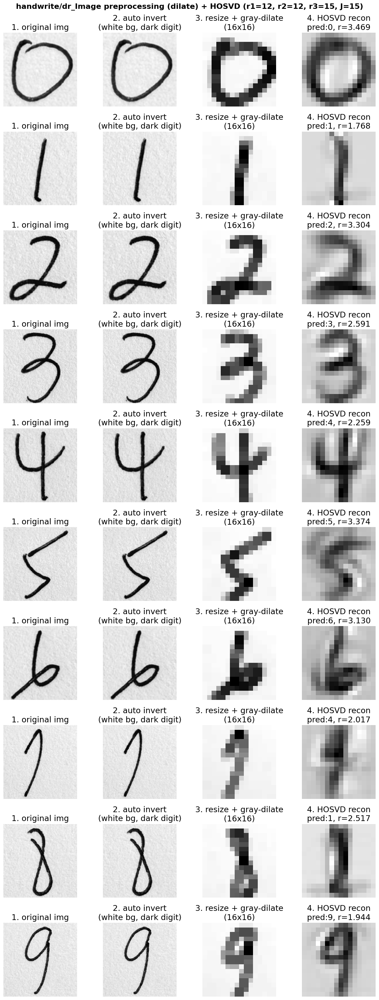

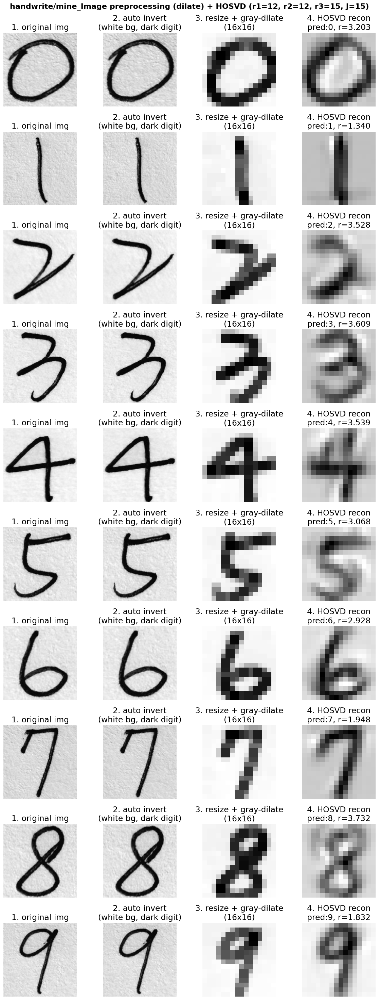

In [86]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_preprocessing__2_hosvd(folder_path, hosvd_spaces,n_samples=10, img_size=(16, 16),ranks=(12, 12, 15)):

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    fig, axes = plt.subplots(n_samples, 4, figsize=(12, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    # 取一個 digit 看 basis (J) 的大小
    some_digit = sorted(hosvd_spaces.keys())[0]
    J_vis = hosvd_spaces[some_digit]['basis'].shape[0]

    r1, r2, r3 = ranks
    fig.suptitle(
        f'{folder_path}_Image preprocessing (dilate) + '
        f'HOSVD (r1={r1}, r2={r2}, r3={r3}, J={J_vis})',
        fontsize=16, fontweight='bold'
    )

    H, W = img_size
    digits = sorted(hosvd_spaces.keys())

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉
        if np.mean(gray) < 128:
            inv = 255 - gray
        else:
            inv = gray.copy()

        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2. auto invert\n(white bg, dark digit)')
        axes[idx, 1].axis('off')

        # 3. 縮放 + 灰階膨脹 (加粗筆畫)
        digit_small = cv2.resize(
            inv, img_size,
            interpolation=cv2.INTER_AREA
        )

        # 反轉 + 膨脹 + 再反轉
        inv_small = 255 - digit_small
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick

        # 對比拉伸
        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        axes[idx, 2].imshow(digit_thick_gray, cmap='gray')
        axes[idx, 2].set_title(
            f'3. resize + gray-dilate\n({img_size[0]}x{img_size[1]})'
        )
        axes[idx, 2].axis('off')

        # 丟進 HOSVD 分類器的輸入：normalize 到 [0,1] 後 flatten
        img_norm = digit_thick_gray.astype(np.float32) / 255.0
        x = img_norm.flatten().astype(np.float64)  # (D,)

        # 4. 用 HOSVD 子空間做預測 + 重建
        best_digit = None
        best_res   = None
        best_recon = None

        for d in digits:
            basis_d = hosvd_spaces[d]['basis']  # (J, D)
            norm2_d = hosvd_spaces[d]['norm2']  # (J,)

            inner = basis_d @ x                # <x, A_j>
            coef  = inner / norm2_d            # z_j
            recon_flat = (coef[:, None] * basis_d).sum(axis=0)  # Σ z_j A_j

            residual = np.linalg.norm(x - recon_flat)

            if (best_res is None) or (residual < best_res):
                best_res   = residual
                best_digit = d
                best_recon = recon_flat

        if best_recon is not None:
            recon_img = best_recon.reshape(H, W)
            axes[idx, 3].imshow(recon_img, cmap='gray')
            axes[idx, 3].set_title(
                f'4. HOSVD recon\npred:{best_digit}, r={best_res:.3f}'
            )
            axes[idx, 3].axis('off')

    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()
visualize_preprocessing__2_hosvd('handwrite/dr',   hosvd_best,
                                 n_samples=10, img_size=(16, 16),
                                 ranks=(12, 12, 15))
visualize_preprocessing__2_hosvd('handwrite/mine', hosvd_best,
                                 n_samples=10, img_size=(16, 16),
                                 ranks=(12, 12, 15))


3.手寫字_ROI+字體加粗



In [87]:
def hosvd_predict_handwrite_folder_3(folder_path, hosvd_spaces, img_size=(16, 16)):

    # 使用字變粗+ROI的前處理
    X_flat, names = load_handwrite_enhanced_ROI(folder_path, img_size=img_size)  # (N, 256)

    # 轉回 (N, H, W) 給 HOSVD 分類器使用
    H, W = img_size
    X_imgs = X_flat.reshape(-1, H, W)   # (N, H, W)

    # 用 HOSVD 子空間公式做分類
    y_pred, G_all = predict_with_hosvd_subspaces(hosvd_spaces, X_imgs)


    # 每張圖在 10 個 digit 子空間的 G 值，取最小的當作該圖的 residual 指標
    min_residual = G_all.min(axis=1)

    return names, y_pred, min_residual

In [88]:
# 對 handwrite/dr & handwrite/mine 做預測並統計

print("\n" + "="*70)
print("使用 HOSVD 子空間分類器，對字變粗+ROI手寫資料重新預測")
print("Best HOSVD (r1=12, r2=12, r3=15)")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_new, dr_residuals_new = hosvd_predict_handwrite_folder_3(
    'handwrite/dr',
    hosvd_best,          # 上面建好的 best HOSVD 子空間
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (HOSVD) ===")
for name, pred, res in zip(dr_names, dr_preds_new, dr_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_new, mine_residuals_new = hosvd_predict_handwrite_folder_3(
    'handwrite/mine',
    hosvd_best,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (HOSVD) ===")
for name, pred, res in zip(mine_names, mine_preds_new, mine_residuals_new):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (最小 residual: {res:.4f})")




使用 HOSVD 子空間分類器，對字變粗+ROI手寫資料重新預測
Best HOSVD (r1=12, r2=12, r3=15)

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== 使用 HOSVD 子空間進行分類（內積 + 重建誤差） ===
  已完成 10/10

=== handwrite/dr 預測結果 (HOSVD) ===
檔名:  0.jpg -> 預測數字: 0 (最小 residual: 3.7371)
檔名:  1.jpg -> 預測數字: 6 (最小 residual: 5.4283)
檔名:  2.jpg -> 預測數字: 2 (最小 residual: 4.7094)
檔名:  3.jpg -> 預測數字: 3 (最小 residual: 4.0881)
檔名:  4.jpg -> 預測數字: 4 (最小 residual: 3.8782)
檔名:  5.jpg -> 預測數字: 5 (最小 residual: 4.7033)
檔名:  6.jpg -> 預測數字: 3 (最小 residual: 4.7385)
檔名:  7.jpg -> 預測數字: 7 (最小 residual: 4.4317)
檔名:  8.jpg -> 預測數字: 3 (最小 residual: 4.8059)
檔名:  9.jpg -> 預測數字: 9 (最小 residual: 3.5853)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== 使用 HOSVD 子空間進行分類（內積 + 重建誤差） ===
  已完成 10/10


In [89]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_new)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_new)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 7 / 10
mine 正確 6 / 10


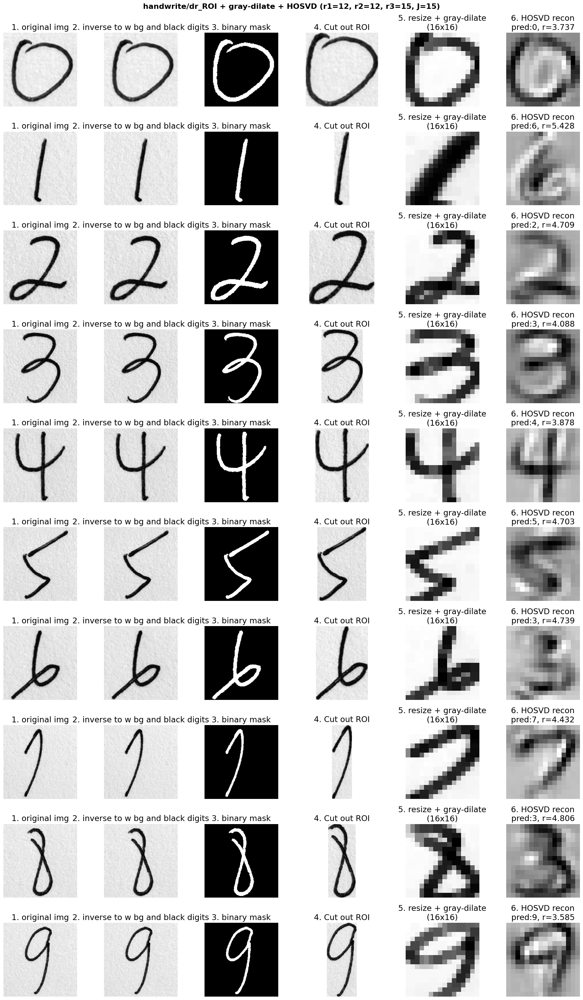

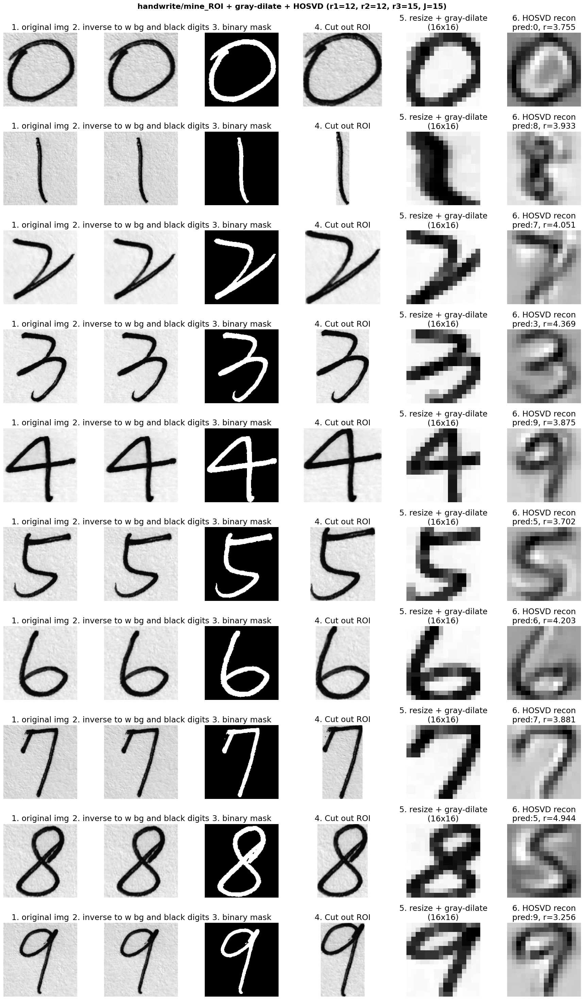

In [90]:
def visualize_preprocessing__3_hosvd(folder_path, hosvd_spaces,n_samples=10, img_size=(16, 16),ranks=(12, 12, 15)):

    files = sorted([
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ])[:n_samples]

    fig, axes = plt.subplots(n_samples, 6, figsize=(18, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, -1)

    some_digit = sorted(hosvd_spaces.keys())[0]
    J_vis = hosvd_spaces[some_digit]['basis'].shape[0]

    r1, r2, r3 = ranks
    fig.suptitle(
        f'{folder_path}_ROI + gray-dilate + '
        f'HOSVD (r1={r1}, r2={r2}, r3={r3}, J={J_vis})',
        fontsize=16, fontweight='bold'
    )

    H, W = img_size
    digits = sorted(hosvd_spaces.keys())

    for idx, filename in enumerate(files):
        img_path = os.path.join(folder_path, filename)
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

        if gray is None:
            continue

        # 1. 原始圖片
        axes[idx, 0].imshow(gray, cmap='gray')
        axes[idx, 0].set_title('1. original img')
        axes[idx, 0].axis('off')

        # 2. 自動反轉
        if np.mean(gray) < 128:
            inv = 255 - gray
        else:
            inv = gray.copy()
        axes[idx, 1].imshow(inv, cmap='gray')
        axes[idx, 1].set_title('2. inverse to w bg and black digits')
        axes[idx, 1].axis('off')

        # 3. 二值化 mask
        _, mask = cv2.threshold(
            inv, 0, 255,
            cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
        )
        axes[idx, 2].imshow(mask, cmap='gray')
        axes[idx, 2].set_title('3. binary mask')
        axes[idx, 2].axis('off')

        if np.count_nonzero(mask) == 0:
            continue

        # 4. 依 mask 裁切 ROI
        ys, xs = np.where(mask > 0)
        x_min, x_max = xs.min(), xs.max()
        y_min, y_max = ys.min(), ys.max()
        roi = inv[y_min:y_max+1, x_min:x_max+1]
        axes[idx, 3].imshow(roi, cmap='gray')
        axes[idx, 3].set_title('4. Cut out ROI')
        axes[idx, 3].axis('off')

        # 5. ROI → resize → gray-dilate
        digit_small = cv2.resize(
            roi, img_size,
            interpolation=cv2.INTER_AREA
        )

        inv_small = 255 - digit_small
        kernel = np.ones((2, 2), np.uint8)
        inv_thick = cv2.dilate(inv_small, kernel, iterations=1)
        digit_thick_gray = 255 - inv_thick

        digit_thick_gray = cv2.normalize(
            digit_thick_gray, None, alpha=0, beta=255,
            norm_type=cv2.NORM_MINMAX
        )

        axes[idx, 4].imshow(digit_thick_gray, cmap='gray')
        axes[idx, 4].set_title(
            f'5. resize + gray-dilate\n({img_size[0]}x{img_size[1]})'
        )
        axes[idx, 4].axis('off')

        # normalize → flatten 給 HOSVD
        img_norm = digit_thick_gray.astype(np.float32) / 255.0
        x = img_norm.flatten().astype(np.float64)  # (D,)

        # 6. HOSVD 子空間預測 + 重建
        best_digit = None
        best_res   = None
        best_recon = None

        for d in digits:
            basis_d = hosvd_spaces[d]['basis']  # (J, D)
            norm2_d = hosvd_spaces[d]['norm2']  # (J,)

            inner = basis_d @ x                # <x, A_j>
            coef  = inner / norm2_d            # z_j
            recon_flat = (coef[:, None] * basis_d).sum(axis=0)

            residual = np.linalg.norm(x - recon_flat)

            if (best_res is None) or (residual < best_res):
                best_res   = residual
                best_digit = d
                best_recon = recon_flat

        if best_recon is not None:
            recon_img = best_recon.reshape(H, W)
            axes[idx, 5].imshow(recon_img, cmap='gray')
            axes[idx, 5].set_title(
                f'6. HOSVD recon\npred:{best_digit}, r={best_res:.3f}'
            )
            axes[idx, 5].axis('off')

    plt.tight_layout(rect=[0.0, 0, 1, 0.99])
    plt.show()
visualize_preprocessing__3_hosvd('handwrite/dr',   hosvd_best,
                                 n_samples=10, img_size=(16, 16),
                                 ranks=(12, 12, 15))
visualize_preprocessing__3_hosvd('handwrite/mine', hosvd_best,
                                 n_samples=10, img_size=(16, 16),
                                 ranks=(12, 12, 15))

##方法四:Random Forest

In [91]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np

IMG_SIZE   = (16, 16)
TRAIN_PATH = 'usps_inverted/train'
TEST_PATH  = 'usps_inverted/test'

def train_usps_random_forest(
    n_estimators=200,
    max_depth=None,
    random_state=42
):
    # 1. 載入 USPS train / test
    X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=IMG_SIZE)
    X_test_imgs,  y_test  = load_usps_split(TEST_PATH,  img_size=IMG_SIZE)

    # 2. 攤平成向量 (N, 256)
    H, W = IMG_SIZE
    D = H * W

    X_train = X_train_imgs.reshape(X_train_imgs.shape[0], D)
    X_test  = X_test_imgs.reshape(X_test_imgs.shape[0],  D)

    print("Train shape :", X_train.shape)
    print("Test  shape :", X_test.shape)

    # 3. 建立 RandomForest 分類器
    rf = RandomForestClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        n_jobs=-1,
        random_state=random_state
    )

    # 4. 訓練
    print("\n開始訓練 USPS RandomForestClassifier ...")
    rf.fit(X_train, y_train)
    print("訓練完成！")

    # 5. 在 USPS test set 上看一下效果
    y_pred = rf.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    print("\n=== RandomForest 在 USPS 的表現 ===")
    print("Accuracy:", acc)

    print("\n分類報告：")
    print(classification_report(y_test, y_pred))

    cm = confusion_matrix(y_test, y_pred)
    print("Confusion Matrix：")
    print(cm)

    # 回傳訓練好的 model，之後拿來對 handwrite/mine、handwrite/dr 用
    return rf
rf_model = train_usps_random_forest()


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)
Train shape : (7291, 256)
Test  shape : (2007, 256)

開始訓練 USPS RandomForestClassifier ...
訓練完成！

=== RandomForest 在 USPS 的表現 ===
Accuracy: 0.9407075236671649

分類報告：
              precision    recall  f1-score   support

           0       0.96      0.98      0.97       359
           1       0.99      0.97      0.98       264
           2       0.92      0.91      0.92       198
           3       0.90      0.90      0.90       166
           4       0.9

## 方法四:RandomForest_自己手寫預測

1.原始字體

In [92]:
def rf_predict_handwrite_folder(folder_path, rf_model, img_size=(16, 16)):

    X_flat, names = load_handwrite_original(folder_path, img_size=img_size)  # (N, 256)

    # 用 RF 做分類
    y_pred = rf_model.predict(X_flat)

    if hasattr(rf_model, "predict_proba"):
        proba = rf_model.predict_proba(X_flat)          # (N, n_classes)
        max_probs = proba.max(axis=1)                   # (N,)
    else:
        max_probs = np.full(len(y_pred), np.nan)

    return names, y_pred, max_probs


In [93]:
print("\n" + "="*70)
print("使用 RandomForest 分類器，對手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_rf, dr_conf_rf = rf_predict_handwrite_folder(
    'handwrite/dr',
    rf_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (RandomForest) ===")
for name, pred, conf in zip(dr_names, dr_preds_rf, dr_conf_rf):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_rf, mine_conf_rf = rf_predict_handwrite_folder(
    'handwrite/mine',
    rf_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (RandomForest) ===")
for name, pred, conf in zip(mine_names, mine_preds_rf, mine_conf_rf):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")





使用 RandomForest 分類器，對手寫資料預測

從 handwrite/dr 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (RandomForest) ===
檔名:  0.jpg -> 預測數字: 2 (confidence: 0.225)
檔名:  1.jpg -> 預測數字: 8 (confidence: 0.245)
檔名:  2.jpg -> 預測數字: 2 (confidence: 0.300)
檔名:  3.jpg -> 預測數字: 8 (confidence: 0.285)
檔名:  4.jpg -> 預測數字: 8 (confidence: 0.300)
檔名:  5.jpg -> 預測數字: 2 (confidence: 0.240)
檔名:  6.jpg -> 預測數字: 2 (confidence: 0.240)
檔名:  7.jpg -> 預測數字: 2 (confidence: 0.285)
檔名:  8.jpg -> 預測數字: 2 (confidence: 0.255)
檔名:  9.jpg -> 預測數字: 2 (confidence: 0.245)

從 handwrite/mine 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (RandomForest) ===
檔名:  0.jpg -> 預測數字: 2 (confidence: 0.210)
檔名:  1.jpg -> 預測數字: 2 (confidence: 0.270)
檔名:  2.jpg -> 預測數字: 2

In [94]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_rf)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_rf)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 1 / 10
mine 正確 2 / 10


2.字體加粗無ROI

In [95]:
def rf_predict_handwrite_folder_2(folder_path, rf_model, img_size=(16, 16)):

    X_flat, names = load_handwrite_enhanced(folder_path, img_size=img_size)  # (N, 256)

    # 用 RF 做分類
    y_pred = rf_model.predict(X_flat)

    if hasattr(rf_model, "predict_proba"):
        proba = rf_model.predict_proba(X_flat)          # (N, n_classes)
        max_probs = proba.max(axis=1)                   # (N,)
    else:
        max_probs = np.full(len(y_pred), np.nan)

    return names, y_pred, max_probs


In [96]:
print("\n" + "="*70)
print("使用 RandomForest 分類器，對字加粗手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_rf, dr_conf_rf = rf_predict_handwrite_folder_2(
    'handwrite/dr',
    rf_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (RandomForest) ===")
for name, pred, conf in zip(dr_names, dr_preds_rf, dr_conf_rf):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_rf, mine_conf_rf = rf_predict_handwrite_folder_2(
    'handwrite/mine',
    rf_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (RandomForest) ===")
for name, pred, conf in zip(mine_names, mine_preds_rf, mine_conf_rf):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")





使用 RandomForest 分類器，對字加粗手寫資料預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (RandomForest) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 0.340)
檔名:  1.jpg -> 預測數字: 2 (confidence: 0.250)
檔名:  2.jpg -> 預測數字: 2 (confidence: 0.460)
檔名:  3.jpg -> 預測數字: 3 (confidence: 0.355)
檔名:  4.jpg -> 預測數字: 4 (confidence: 0.235)
檔名:  5.jpg -> 預測數字: 8 (confidence: 0.275)
檔名:  6.jpg -> 預測數字: 2 (confidence: 0.385)
檔名:  7.jpg -> 預測數字: 2 (confidence: 0.305)
檔名:  8.jpg -> 預測數字: 2 (confidence: 0.270)
檔名:  9.jpg -> 預測數字: 3 (confidence: 0.235)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (RandomForest) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 0.220)
檔名:  1.jpg -> 預測數字: 2 (confidence: 0.240)
檔名:  2.jpg -> 預測數字

In [97]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_rf)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_rf)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 4 / 10
mine 正確 4 / 10


3.字體加粗+ROI

In [98]:
def rf_predict_handwrite_folder_3(folder_path, rf_model, img_size=(16, 16)):

    X_flat, names = load_handwrite_enhanced_ROI(folder_path, img_size=img_size)  # (N, 256)

    # 用 RF 做分類
    y_pred = rf_model.predict(X_flat)

    if hasattr(rf_model, "predict_proba"):
        proba = rf_model.predict_proba(X_flat)          # (N, n_classes)
        max_probs = proba.max(axis=1)                   # (N,)
    else:
        max_probs = np.full(len(y_pred), np.nan)

    return names, y_pred, max_probs


In [99]:
print("\n" + "="*70)
print("使用 RandomForest 分類器，對字加粗+ROI手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_rf, dr_conf_rf = rf_predict_handwrite_folder_3(
    'handwrite/dr',
    rf_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (RandomForest) ===")
for name, pred, conf in zip(dr_names, dr_preds_rf, dr_conf_rf):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_rf, mine_conf_rf = rf_predict_handwrite_folder_3(
    'handwrite/mine',
    rf_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (RandomForest) ===")
for name, pred, conf in zip(mine_names, mine_preds_rf, mine_conf_rf):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")





使用 RandomForest 分類器，對字加粗+ROI手寫資料預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (RandomForest) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 0.285)
檔名:  1.jpg -> 預測數字: 2 (confidence: 0.250)
檔名:  2.jpg -> 預測數字: 2 (confidence: 0.310)
檔名:  3.jpg -> 預測數字: 3 (confidence: 0.300)
檔名:  4.jpg -> 預測數字: 2 (confidence: 0.200)
檔名:  5.jpg -> 預測數字: 0 (confidence: 0.255)
檔名:  6.jpg -> 預測數字: 2 (confidence: 0.375)
檔名:  7.jpg -> 預測數字: 2 (confidence: 0.200)
檔名:  8.jpg -> 預測數字: 2 (confidence: 0.315)
檔名:  9.jpg -> 預測數字: 8 (confidence: 0.220)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (RandomForest) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 0.230)
檔名:  1.jpg -> 預測數字: 8 (confidence: 0.295)
檔名:  2.jpg -> 

In [100]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_rf)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_rf)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 3 / 10
mine 正確 4 / 10


## 方法五:XGBooster


In [101]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np

IMG_SIZE   = (16, 16)
TRAIN_PATH = 'usps_inverted/train'
TEST_PATH  = 'usps_inverted/test'


def train_usps_xgboost(
    n_estimators=300,
    max_depth=6,
    learning_rate=0.1,
    subsample=0.9,
    colsample_bytree=0.9,
    random_state=42
):
    # 1. 載入 USPS train / test
    X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=IMG_SIZE)
    X_test_imgs,  y_test  = load_usps_split(TEST_PATH,  img_size=IMG_SIZE)

    # 2. 攤平成向量 (N, 256)
    H, W = IMG_SIZE
    D = H * W

    X_train = X_train_imgs.reshape(X_train_imgs.shape[0], D)
    X_test  = X_test_imgs.reshape(X_test_imgs.shape[0],  D)

    print("Train shape :", X_train.shape)
    print("Test  shape :", X_test.shape)

    # 3. 建立 XGBoost 分類器
    xgb = XGBClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        subsample=subsample,
        colsample_bytree=colsample_bytree,
        objective='multi:softmax',
        num_class=10,
        tree_method='hist',
        random_state=random_state,
        n_jobs=-1
    )

    # 4. 訓練
    print("\n開始訓練 USPS XGBoostClassifier ...")
    xgb.fit(X_train, y_train)
    print("訓練完成！")

    # 5. 在 USPS test set 上評估
    y_pred = xgb.predict(X_test)

    acc = accuracy_score(y_test, y_pred)
    print("\n=== XGBoost 在 USPS 的表現 ===")
    print("Accuracy:", acc)

    print("\n分類報告：")
    print(classification_report(y_test, y_pred))

    cm = confusion_matrix(y_test, y_pred)
    print("Confusion Matrix：")
    print(cm)

    return xgb, X_test_imgs, y_test


In [102]:
xgb_model, X_test_imgs, y_test = train_usps_xgboost()


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)
Train shape : (7291, 256)
Test  shape : (2007, 256)

開始訓練 USPS XGBoostClassifier ...
訓練完成！

=== XGBoost 在 USPS 的表現 ===
Accuracy: 0.9382162431489786

分類報告：
              precision    recall  f1-score   support

           0       0.97      0.99      0.98       359
           1       1.00      0.96      0.98       264
           2       0.91      0.91      0.91       198
           3       0.93      0.89      0.91       166
           4       0.88      0.9

##方法五:XGBooster_自己手寫預測

1.手寫字_原始版(無框ROI+無字體加粗)


In [103]:
def xgb_predict_handwrite_folder(folder_path, xgb_model, img_size=(16, 16)):
    X_flat, names = load_handwrite_original(folder_path, img_size=img_size)  # (N, 256)
    y_pred = xgb_model.predict(X_flat)
    return names, y_pred


In [104]:
print("\n" + "="*70)
print("使用 XGBoost 分類器，對手寫資料重新預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_xgb = xgb_predict_handwrite_folder(
    'handwrite/dr',
    xgb_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (XGBoost) ===")
for name, pred in zip(dr_names, dr_preds_xgb):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_xgb = xgb_predict_handwrite_folder(
    'handwrite/mine',
    xgb_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (XGBoost) ===")
for name, pred in zip(mine_names, mine_preds_xgb):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")




使用 XGBoost 分類器，對手寫資料重新預測

從 handwrite/dr 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (XGBoost) ===
檔名:  0.jpg -> 預測數字: 2
檔名:  1.jpg -> 預測數字: 2
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 8
檔名:  5.jpg -> 預測數字: 2
檔名:  6.jpg -> 預測數字: 2
檔名:  7.jpg -> 預測數字: 2
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 2

從 handwrite/mine 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (XGBoost) ===
檔名:  0.jpg -> 預測數字: 8
檔名:  1.jpg -> 預測數字: 2
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 8
檔名:  5.jpg -> 預測數字: 2
檔名:  6.jpg -> 預測數字: 8
檔名:  7.jpg -> 預測數字: 2
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 2


In [105]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_xgb)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_xgb)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")



dr 正確 2 / 10
mine 正確 2 / 10


2.手寫字_無框ROI+字體加粗


In [106]:
def xgb_predict_handwrite_folder_2(folder_path, xgb_model, img_size=(16, 16)):
    X_flat, names = load_handwrite_enhanced(folder_path, img_size=img_size)  # (N, 256)
    y_pred = xgb_model.predict(X_flat)
    return names, y_pred


In [107]:
print("\n" + "="*70)
print("使用 XGBoost 分類器，對字加粗手寫資料重新預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_xgb = xgb_predict_handwrite_folder_2(
    'handwrite/dr',
    xgb_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (XGBoost) ===")
for name, pred in zip(dr_names, dr_preds_xgb):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_xgb = xgb_predict_handwrite_folder_2(
    'handwrite/mine',
    xgb_model,
    img_size=(16, 16)
)
print("\n=== handwrite/mine 預測結果 (XGBoost) ===")
for name, pred in zip(mine_names, mine_preds_xgb):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")


使用 XGBoost 分類器，對字加粗手寫資料重新預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (XGBoost) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 8
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 4
檔名:  5.jpg -> 預測數字: 8
檔名:  6.jpg -> 預測數字: 2
檔名:  7.jpg -> 預測數字: 2
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 8

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (XGBoost) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 2
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 4
檔名:  5.jpg -> 預測數字: 5
檔名:  6.jpg -> 預測數字: 8
檔名:  7.jpg -> 預測數字: 7
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 4


In [108]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_xgb)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_xgb)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")



dr 正確 4 / 10
mine 正確 6 / 10


3.手寫字_ROI+字體加粗


In [109]:
def xgb_predict_handwrite_folder_3(folder_path, xgb_model, img_size=(16, 16)):
    X_flat, names = load_handwrite_enhanced_ROI(folder_path, img_size=img_size)  # (N, 256)
    y_pred = xgb_model.predict(X_flat)
    return names, y_pred


In [110]:
print("\n" + "="*70)
print("使用 XGBoost 分類器，對字加粗+ROI手寫資料重新預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_xgb = xgb_predict_handwrite_folder_3(
    'handwrite/dr',
    xgb_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (XGBoost) ===")
for name, pred in zip(dr_names, dr_preds_xgb):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_xgb = xgb_predict_handwrite_folder_3(
    'handwrite/mine',
    xgb_model,
    img_size=(16, 16)
)
print("\n=== handwrite/mine 預測結果 (XGBoost) ===")
for name, pred in zip(mine_names, mine_preds_xgb):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")


使用 XGBoost 分類器，對字加粗+ROI手寫資料重新預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (XGBoost) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 8
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 4
檔名:  5.jpg -> 預測數字: 2
檔名:  6.jpg -> 預測數字: 2
檔名:  7.jpg -> 預測數字: 2
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 8

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (XGBoost) ===
檔名:  0.jpg -> 預測數字: 5
檔名:  1.jpg -> 預測數字: 8
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 9
檔名:  5.jpg -> 預測數字: 5
檔名:  6.jpg -> 預測數字: 8
檔名:  7.jpg -> 預測數字: 2
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 9


In [111]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_xgb)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_xgb)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")



dr 正確 4 / 10
mine 正確 4 / 10


##方法六 :Support Vector Machine

In [112]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np

IMG_SIZE   = (16, 16)
TRAIN_PATH = 'usps_inverted/train'
TEST_PATH  = 'usps_inverted/test'

def train_usps_svm(
    C=10.0,
    kernel='rbf',
    gamma='scale',
    random_state=42
):
    # 1. 載入 USPS train / test
    X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=IMG_SIZE)
    X_test_imgs,  y_test  = load_usps_split(TEST_PATH,  img_size=IMG_SIZE)

    # 2. 攤平成向量 (N, 256)
    H, W = IMG_SIZE
    D = H * W

    X_train = X_train_imgs.reshape(X_train_imgs.shape[0], D)
    X_test  = X_test_imgs.reshape(X_test_imgs.shape[0],  D)

    print("Train shape :", X_train.shape)
    print("Test  shape :", X_test.shape)

    # 3. 建立 SVM 分類器
    #    這裡用 RBF kernel
    svm = SVC(
        C=C,
        kernel=kernel,
        gamma=gamma,
        random_state=random_state
    )

    # 4. 訓練
    print("\n開始訓練 USPS SVM 分類器")
    svm.fit(X_train, y_train)
    print("訓練完成！")

    # 5. 在 USPS test set 上評估
    y_pred = svm.predict(X_test)

    acc = accuracy_score(y_test, y_pred)
    print("\n=== SVM 在 USPS 的表現 ===")
    print("Accuracy:", acc)

    print("\n分類報告：")
    print(classification_report(y_test, y_pred))

    cm = confusion_matrix(y_test, y_pred)
    print("Confusion Matrix：")
    print(cm)

    # 回傳 model + 測試資料（如果你之後還想拿來畫圖用）
    return svm, X_test_imgs, y_test
svm_model, X_test_imgs, y_test = train_usps_svm()


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)
Train shape : (7291, 256)
Test  shape : (2007, 256)

開始訓練 USPS SVM 分類器
訓練完成！

=== SVM 在 USPS 的表現 ===
Accuracy: 0.9526656701544594

分類報告：
              precision    recall  f1-score   support

           0       0.98      0.99      0.98       359
           1       1.00      0.97      0.98       264
           2       0.94      0.94      0.94       198
           3       0.94      0.89      0.92       166
           4       0.90      0.94      0.92       

##方法六 :Support Vector Machine_自己手寫預測

1.手寫字_原始版(無框ROI+無字體加粗)


In [113]:
def svm_predict_handwrite_folder(folder_path, svm_model, img_size=(16, 16)):
    # 使用原本的前處理
    X_flat, names = load_handwrite_original(folder_path, img_size=img_size)  # (N, 256)
    y_pred = svm_model.predict(X_flat)

    return names, y_pred


In [114]:
print("\n" + "="*70)
print("使用 SVM 分類器，對手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_svm = svm_predict_handwrite_folder(
    'handwrite/dr',
    svm_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (SVM) ===")
for name, pred in zip(dr_names, dr_preds_svm):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_svm = svm_predict_handwrite_folder(
    'handwrite/mine',
    svm_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (SVM) ===")
for name, pred in zip(mine_names, mine_preds_svm):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")




使用 SVM 分類器，對手寫資料預測

從 handwrite/dr 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (SVM) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 8
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 8
檔名:  5.jpg -> 預測數字: 8
檔名:  6.jpg -> 預測數字: 2
檔名:  7.jpg -> 預測數字: 2
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 8

從 handwrite/mine 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (SVM) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 2
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 8
檔名:  4.jpg -> 預測數字: 8
檔名:  5.jpg -> 預測數字: 5
檔名:  6.jpg -> 預測數字: 6
檔名:  7.jpg -> 預測數字: 8
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 8


In [115]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_svm)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_svm)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")



dr 正確 3 / 10
mine 正確 5 / 10


2.手寫字_無框ROI+字體加粗


In [116]:
def svm_predict_handwrite_folder_2(folder_path, svm_model, img_size=(16, 16)):
    X_flat, names = load_handwrite_enhanced(folder_path, img_size=img_size)  # (N, 256)
    y_pred = svm_model.predict(X_flat)

    return names, y_pred


In [117]:
print("\n" + "="*70)
print("使用 SVM 分類器，對字加粗手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_svm = svm_predict_handwrite_folder_2(
    'handwrite/dr',
    svm_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (SVM) ===")
for name, pred in zip(dr_names, dr_preds_svm):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_svm = svm_predict_handwrite_folder_2(
    'handwrite/mine',
    svm_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (SVM) ===")
for name, pred in zip(mine_names, mine_preds_svm):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")




使用 SVM 分類器，對字加粗手寫資料預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (SVM) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 1
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 3
檔名:  4.jpg -> 預測數字: 4
檔名:  5.jpg -> 預測數字: 5
檔名:  6.jpg -> 預測數字: 6
檔名:  7.jpg -> 預測數字: 4
檔名:  8.jpg -> 預測數字: 8
檔名:  9.jpg -> 預測數字: 9

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (SVM) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 1
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 3
檔名:  4.jpg -> 預測數字: 4
檔名:  5.jpg -> 預測數字: 5
檔名:  6.jpg -> 預測數字: 6
檔名:  7.jpg -> 預測數字: 7
檔名:  8.jpg -> 預測數字: 3
檔名:  9.jpg -> 預測數字: 9


In [118]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_svm)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_svm)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")



dr 正確 9 / 10
mine 正確 9 / 10


3.手寫字_ROI+字體加粗


In [119]:
def svm_predict_handwrite_folder_3(folder_path, svm_model, img_size=(16, 16)):
    X_flat, names = load_handwrite_enhanced_ROI(folder_path, img_size=img_size)  # (N, 256)
    y_pred = svm_model.predict(X_flat)

    return names, y_pred


In [120]:
print("\n" + "="*70)
print("使用 SVM 分類器，對字加粗+ROI手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_svm = svm_predict_handwrite_folder_3(
    'handwrite/dr',
    svm_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (SVM) ===")
for name, pred in zip(dr_names, dr_preds_svm):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_svm = svm_predict_handwrite_folder_3(
    'handwrite/mine',
    svm_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (SVM) ===")
for name, pred in zip(mine_names, mine_preds_svm):
    print(f"檔名: {name:>6s} -> 預測數字: {pred}")




使用 SVM 分類器，對字加粗+ROI手寫資料預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (SVM) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 2
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 3
檔名:  4.jpg -> 預測數字: 4
檔名:  5.jpg -> 預測數字: 0
檔名:  6.jpg -> 預測數字: 3
檔名:  7.jpg -> 預測數字: 7
檔名:  8.jpg -> 預測數字: 3
檔名:  9.jpg -> 預測數字: 9

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (SVM) ===
檔名:  0.jpg -> 預測數字: 0
檔名:  1.jpg -> 預測數字: 8
檔名:  2.jpg -> 預測數字: 2
檔名:  3.jpg -> 預測數字: 3
檔名:  4.jpg -> 預測數字: 9
檔名:  5.jpg -> 預測數字: 5
檔名:  6.jpg -> 預測數字: 6
檔名:  7.jpg -> 預測數字: 7
檔名:  8.jpg -> 預測數字: 3
檔名:  9.jpg -> 預測數字: 9


In [121]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_svm)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_svm)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")



dr 正確 6 / 10
mine 正確 7 / 10


## 方法七:CNN

In [122]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, BatchNormalization

def build_cnn_with_bn(input_shape=(16,16,1)):
    model = Sequential()

    # conv block 1
    model.add(Conv2D(16, (5,5), padding='same', activation='relu',
                     input_shape=input_shape))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2,2)))

    # conv block 2
    model.add(Conv2D(36, (5,5), padding='same', activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2,2)))

    model.add(Dropout(0.25))

    model.add(Flatten())
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))

    return model


In [123]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np

def train_usps_cnn_bn_aug(batch_size=64, epochs=50, verbose=1):
    # 1. 載入 USPS
    X_train_imgs, y_train = load_usps_split(TRAIN_PATH, img_size=IMG_SIZE)
    X_test_imgs,  y_test  = load_usps_split(TEST_PATH,  img_size=IMG_SIZE)

    X_train = X_train_imgs[..., np.newaxis]   # (N,16,16,1)
    X_test  = X_test_imgs[...,  np.newaxis]

    print("Train shape:", X_train.shape)
    print("Test  shape:", X_test.shape)

    # 2. 建立 CNN+BN（就是你前面那個 build_cnn_with_bn）
    model = build_cnn_with_bn(input_shape=(16,16,1))
    model.summary()

    model.compile(
        optimizer='adam',
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )

    # 3. 輕量 data augmentation（不要太大，16x16 很容易壞掉）
    datagen = ImageDataGenerator(
        rotation_range=10,      # ±10° 小旋轉
        width_shift_range=0.1,  # 左右平移 10%
        height_shift_range=0.1, # 上下平移 10%
        zoom_range=0.1          # 輕微縮放
    )
    datagen.fit(X_train)

    # 4. LR schedule + EarlyStopping
    cb_lr = ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,
        patience=3,
        min_lr=1e-5,
        verbose=1
    )

    cb_es = EarlyStopping(
        monitor='val_loss',
        patience=8,
        restore_best_weights=True,
        verbose=1
    )

    steps_per_epoch = len(X_train) // batch_size

    history = model.fit(
        datagen.flow(X_train, y_train, batch_size=batch_size),
        steps_per_epoch=steps_per_epoch,
        epochs=epochs,
        validation_data=(X_test, y_test),
        callbacks=[cb_lr, cb_es],
        verbose=verbose
    )

    # 5. 評估
    test_loss, test_acc = model.evaluate(X_test, y_test, verbose=0)
    print(f"\nCNN+BN+aug – Keras evaluate accuracy: {test_acc}")

    y_pred_probs = model.predict(X_test, verbose=0)
    y_pred = np.argmax(y_pred_probs, axis=1)

    acc = accuracy_score(y_test, y_pred)
    print("Sklearn accuracy:", acc)

    print("\n分類報告：")
    print(classification_report(y_test, y_pred))
    print("Confusion Matrix：")
    print(confusion_matrix(y_test, y_pred))

    return model, history, X_test_imgs, y_test


In [124]:
cnn_model, cnn_history, X_test_imgs, y_test = train_usps_cnn_bn_aug(
    batch_size=64,
    epochs=50,
    verbose=1
)


正在載入資料從：usps_inverted/train
  數字 0: 找到 1194 張圖片
  數字 1: 找到 1005 張圖片
  數字 2: 找到 731 張圖片
  數字 3: 找到 658 張圖片
  數字 4: 找到 652 張圖片
  數字 5: 找到 556 張圖片
  數字 6: 找到 664 張圖片
  數字 7: 找到 645 張圖片
  數字 8: 找到 542 張圖片
  數字 9: 找到 644 張圖片
載入完成：usps_inverted/train -> images 形狀 (7291, 16, 16)
正在載入資料從：usps_inverted/test
  數字 0: 找到 359 張圖片
  數字 1: 找到 264 張圖片
  數字 2: 找到 198 張圖片
  數字 3: 找到 166 張圖片
  數字 4: 找到 200 張圖片
  數字 5: 找到 160 張圖片
  數字 6: 找到 170 張圖片
  數字 7: 找到 147 張圖片
  數字 8: 找到 166 張圖片
  數字 9: 找到 177 張圖片
載入完成：usps_inverted/test -> images 形狀 (2007, 16, 16)
Train shape: (7291, 16, 16, 1)
Test  shape: (2007, 16, 16, 1)


/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 16, 16, 16)     │           416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 16, 16, 16)     │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 8, 8, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 8, 8, 36)       │        14,436 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 8, 8, 36)       │           144 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 4, 4, 36)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 4, 4, 36)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 576)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       147,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         2,570 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 165,342 (645.87 KB)

 Trainable params: 165,238 (645.46 KB)

 Non-trainable params: 104 (416.00 B)

Epoch 1/50


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


113/113 ━━━━━━━━━━━━━━━━━━━━ 10s 62ms/step - accuracy: 0.5274 - loss: 1.7226 - val_accuracy: 0.5187 - val_loss: 1.5955 - learning_rate: 0.0010
Epoch 2/50
  1/113 ━━━━━━━━━━━━━━━━━━━━ 5s 53ms/step - accuracy: 0.8750 - loss: 0.4856

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8750 - loss: 0.4856 - val_accuracy: 0.5227 - val_loss: 1.5882 - learning_rate: 0.0010
Epoch 3/50
113/113 ━━━━━━━━━━━━━━━━━━━━ 8s 70ms/step - accuracy: 0.8699 - loss: 0.4005 - val_accuracy: 0.8117 - val_loss: 0.6809 - learning_rate: 0.0010
Epoch 4/50
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9062 - loss: 0.2317 - val_accuracy: 0.8146 - val_loss: 0.6709 - learning_rate: 0.0010
Epoch 5/50
113/113 ━━━━━━━━━━━━━━━━━━━━ 10s 75ms/step - accuracy: 0.9148 - loss: 0.2855 - val_accuracy: 0.9178 - val_loss: 0.2954 - learning_rate: 0.0010
Epoch 6/50
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.9375 - loss: 0.3596 - val_accuracy: 0.9208 - val_loss: 0.2893 - learning_rate: 0.0010
Epoch 7/50
113/113 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - accuracy: 0.9280 - loss: 0.2201 - val_accuracy: 0.9547 - val_loss: 0.1727 - learning_rate: 0.0010
Epoch 8/50
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.9219 - loss: 0.2539 - val_ac

## 方法七:CNN_自己手寫預測

1.手寫字_原始版(無框ROI+無字體加粗)


In [125]:
def cnn_predict_handwrite_folder(folder_path, cnn_model, img_size=(16, 16)):

    X_flat, names = load_handwrite_original(folder_path, img_size=img_size)  # (N, 256)

    H, W = img_size
    # 還原成 CNN 要的 shape: (N, 16, 16, 1)
    X_imgs = X_flat.reshape(-1, H, W, 1).astype("float32")

    # 丟進 CNN 做預測
    y_pred_probs = cnn_model.predict(X_imgs, verbose=0)   # (N, 10)
    y_pred = np.argmax(y_pred_probs, axis=1)
    max_probs = y_pred_probs.max(axis=1)

    return names, y_pred, max_probs


In [126]:
print("\n" + "="*70)
print("使用 CNN+BN+Aug 分類器，對手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_cnn, dr_conf_cnn = cnn_predict_handwrite_folder(
    'handwrite/dr',
    cnn_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (CNN) ===")
for name, pred, conf in zip(dr_names, dr_preds_cnn, dr_conf_cnn):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_cnn, mine_conf_cnn = cnn_predict_handwrite_folder(
    'handwrite/mine',
    cnn_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (CNN) ===")
for name, pred, conf in zip(mine_names, mine_preds_cnn, mine_conf_cnn):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")





使用 CNN+BN+Aug 分類器，對手寫資料預測

從 handwrite/dr 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (CNN) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 1.000)
檔名:  1.jpg -> 預測數字: 1 (confidence: 0.998)
檔名:  2.jpg -> 預測數字: 2 (confidence: 0.560)
檔名:  3.jpg -> 預測數字: 8 (confidence: 0.886)
檔名:  4.jpg -> 預測數字: 1 (confidence: 0.343)
檔名:  5.jpg -> 預測數字: 8 (confidence: 0.905)
檔名:  6.jpg -> 預測數字: 1 (confidence: 0.729)
檔名:  7.jpg -> 預測數字: 1 (confidence: 0.995)
檔名:  8.jpg -> 預測數字: 8 (confidence: 0.721)
檔名:  9.jpg -> 預測數字: 1 (confidence: 0.908)

從 handwrite/mine 載入並處理圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (CNN) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 1.000)
檔名:  1.jpg -> 預測數字: 1 (confidence: 1.000)
檔名:  2.jpg -> 預測數字: 0 (confidence: 0.457)

In [127]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_cnn)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_cnn)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 4 / 10
mine 正確 6 / 10


2.手寫字_無框ROI+字體加粗


In [128]:
def cnn_predict_handwrite_folder_2(folder_path, cnn_model, img_size=(16, 16)):

    X_flat, names = load_handwrite_enhanced(folder_path, img_size=img_size)  # (N, 256)

    H, W = img_size
    # 還原成 CNN 要的 shape: (N, 16, 16, 1)
    X_imgs = X_flat.reshape(-1, H, W, 1).astype("float32")

    # 丟進 CNN 做預測
    y_pred_probs = cnn_model.predict(X_imgs, verbose=0)   # (N, 10)
    y_pred = np.argmax(y_pred_probs, axis=1)
    max_probs = y_pred_probs.max(axis=1)

    return names, y_pred, max_probs


In [129]:
print("\n" + "="*70)
print("使用 CNN+BN+Aug 分類器，對字加粗手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_cnn, dr_conf_cnn = cnn_predict_handwrite_folder_2(
    'handwrite/dr',
    cnn_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (CNN) ===")
for name, pred, conf in zip(dr_names, dr_preds_cnn, dr_conf_cnn):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_cnn, mine_conf_cnn = cnn_predict_handwrite_folder_2(
    'handwrite/mine',
    cnn_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (CNN) ===")
for name, pred, conf in zip(mine_names, mine_preds_cnn, mine_conf_cnn):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")





使用 CNN+BN+Aug 分類器，對字加粗手寫資料預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (CNN) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 1.000)
檔名:  1.jpg -> 預測數字: 1 (confidence: 1.000)
檔名:  2.jpg -> 預測數字: 2 (confidence: 1.000)
檔名:  3.jpg -> 預測數字: 3 (confidence: 1.000)
檔名:  4.jpg -> 預測數字: 4 (confidence: 1.000)
檔名:  5.jpg -> 預測數字: 5 (confidence: 0.903)
檔名:  6.jpg -> 預測數字: 6 (confidence: 0.972)
檔名:  7.jpg -> 預測數字: 9 (confidence: 0.500)
檔名:  8.jpg -> 預測數字: 8 (confidence: 0.927)
檔名:  9.jpg -> 預測數字: 9 (confidence: 0.978)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (CNN) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 1.000)
檔名:  1.jpg -> 預測數字: 1 (confidence: 1.000)
檔名:  2.jpg -> 預測數字: 7 (confidence: 0.5

In [130]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_cnn)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_cnn)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 9 / 10
mine 正確 9 / 10


3.手寫字_ROI+字體加粗


In [131]:
def cnn_predict_handwrite_folder_3(folder_path, cnn_model, img_size=(16, 16)):

    X_flat, names = load_handwrite_enhanced_ROI(folder_path, img_size=img_size)  # (N, 256)

    H, W = img_size
    # 還原成 CNN 要的 shape: (N, 16, 16, 1)
    X_imgs = X_flat.reshape(-1, H, W, 1).astype("float32")

    # 丟進 CNN 做預測
    y_pred_probs = cnn_model.predict(X_imgs, verbose=0)   # (N, 10)
    y_pred = np.argmax(y_pred_probs, axis=1)
    max_probs = y_pred_probs.max(axis=1)

    return names, y_pred, max_probs


In [132]:
print("\n" + "="*70)
print("使用 CNN+BN+Aug 分類器，對字加粗+ROI手寫資料預測")
print("="*70)

# 1) 醫師的手寫（handwrite/dr）
dr_names, dr_preds_cnn, dr_conf_cnn = cnn_predict_handwrite_folder_3(
    'handwrite/dr',
    cnn_model,
    img_size=(16, 16)
)

print("\n=== handwrite/dr 預測結果 (CNN) ===")
for name, pred, conf in zip(dr_names, dr_preds_cnn, dr_conf_cnn):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")

# 2) 我的手寫（handwrite/mine）
mine_names, mine_preds_cnn, mine_conf_cnn = cnn_predict_handwrite_folder_3(
    'handwrite/mine',
    cnn_model,
    img_size=(16, 16)
)

print("\n=== handwrite/mine 預測結果 (CNN) ===")
for name, pred, conf in zip(mine_names, mine_preds_cnn, mine_conf_cnn):
    print(f"檔名: {name:>6s} -> 預測數字: {pred} (confidence: {conf:.3f})")





使用 CNN+BN+Aug 分類器，對字加粗+ROI手寫資料預測

從 handwrite/dr 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/dr 預測結果 (CNN) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 1.000)
檔名:  1.jpg -> 預測數字: 1 (confidence: 0.982)
檔名:  2.jpg -> 預測數字: 2 (confidence: 1.000)
檔名:  3.jpg -> 預測數字: 3 (confidence: 0.987)
檔名:  4.jpg -> 預測數字: 4 (confidence: 0.999)
檔名:  5.jpg -> 預測數字: 5 (confidence: 0.997)
檔名:  6.jpg -> 預測數字: 6 (confidence: 0.544)
檔名:  7.jpg -> 預測數字: 7 (confidence: 0.956)
檔名:  8.jpg -> 預測數字: 8 (confidence: 0.919)
檔名:  9.jpg -> 預測數字: 9 (confidence: 0.999)

從 handwrite/mine 載入並增強圖片...
  ✓ 處理: 0.jpg
  ✓ 處理: 1.jpg
  ✓ 處理: 2.jpg
  ✓ 處理: 3.jpg
  ✓ 處理: 4.jpg
  ✓ 處理: 5.jpg
  ✓ 處理: 6.jpg
  ✓ 處理: 7.jpg
  ✓ 處理: 8.jpg
  ✓ 處理: 9.jpg
共載入 10 張圖片


=== handwrite/mine 預測結果 (CNN) ===
檔名:  0.jpg -> 預測數字: 0 (confidence: 1.000)
檔名:  1.jpg -> 預測數字: 1 (confidence: 0.521)
檔名:  2.jpg -> 預測數字: 2 (confidence:

In [133]:
dr_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(dr_names, dr_preds_cnn)
)
print(f"\ndr 正確 {dr_correct} / {len(dr_names)}")

mine_correct = sum(
    int(name.split('.')[0]) == int(pred)
    for name, pred in zip(mine_names, mine_preds_cnn)
)
print(f"mine 正確 {mine_correct} / {len(mine_names)}")


dr 正確 10 / 10
mine 正確 9 / 10
